In [1]:
!pip install squarify


# 📚 Project Title
**Optimizing Marketing Spend and Revenue Growth for ElecKart Using Market Mix Modeling**

---

## 🎯 Problem Statement

ElecKart, a leading e-commerce platform specializing in electronic products, is facing declining revenue and high customer churn despite significant marketing expenditures. The company lacks data-driven insights into how its marketing channels contribute to sales and profitability, leading to sub-optimal budget allocations and ineffective marketing strategies.

The objective of this project is to:

- 📊 Build a **Market Mix Model (MMM)** to quantify the impact of various marketing channels, promotional events, and external factors (like climate and economic indicators) on sales performance.
- 📈 **Optimize Marketing Spend Allocation** across different channels to maximize revenue and Return on Ad Spend (ROAS).
- 📚 Provide **actionable business insights** and financial recommendations for strategic decision-making.

---

## 📌 Key Business Questions

- What is the ROI of each marketing channel?
- How do external factors like climate and NPS influence sales?
- What is the optimal marketing budget allocation to maximize GMV?
- Are there any significant lag effects of marketing activities on revenue?

---

## 📦 Project Scope

- **Analysis Period:** July 2015 – June 2016  
- **Product Categories:**
    - Camera Accessories  
    - Home Audio  
    - Gaming Accessories  
- **Modeling Levels:** Weekly Aggregation

---


In [2]:
#Importing warnings to ignore unnecessary warnings
import warnings
warnings.filterwarnings('ignore')

In [3]:
import numpy as np
import pandas as pd
from datetime import date, datetime
from datetime import timedelta

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split

from sklearn.metrics import r2_score
import sklearn

In [4]:
# 🔧 Show all columns and rows for easier inspection
pd.set_option('display.max_columns', None)   # Show all columns
pd.set_option('display.max_rows', None)      # Show all rows (careful with very large data)
pd.set_option('display.max_colwidth', None)  # Show full content in each cell (useful for strings)


In [5]:
!pip install pyfiglet > /dev/null

import pyfiglet

def print_banner(title, subtitle=None):
    banner = pyfiglet.figlet_format(title, font='slant')
    lines = banner.split('\n')

    max_width = max(len(line) for line in lines)
    border = '*' * (max_width + 4)

    print(border)
    for line in lines:
        print(f"* {line.ljust(max_width)} *")
    print(border)

    if subtitle:
        print(f"\n{' '*4} * {subtitle}\n")

# Display Banner for DATA #1
print_banner("DATA #1", "Consumer Electronics - Sales Metrics")


**********************************************
*     ____  ___  _________         __ __ ___ *
*    / __ \/   |/_  __/   |     __/ // /<  / *
*   / / / / /| | / / / /| |    /_  _  __/ /  *
*  / /_/ / ___ |/ / / ___ |   /_  _  __/ /   *
* /_____/_/  |_/_/ /_/  |_|    /_//_/ /_/    *
*                                            *
*                                            *
**********************************************

     * Consumer Electronics - Sales Metrics



In [6]:
# Load the dataset
df_CE = pd.read_csv('ConsumerElectronics.csv', na_values=['\\N', ' '])

In [7]:
df_CE.shape

(1648824, 20)

In [8]:
df_CE.head(20)

,fsn_id,order_date,Year,Month,order_id,order_item_id,gmv,units,deliverybdays,deliverycdays,s1_fact.order_payment_type,sla,cust_id,pincode,product_analytic_super_category,product_analytic_category,product_analytic_sub_category,product_analytic_vertical,product_mrp,product_procurement_sla
0,ACCCX3S58G7B5F6P,2015-10-17 15:11:54,2015,10,3.419301e+15,3.419301e+15,6400.0,1,NaN,NaN,COD,5,-1.012991e+18,-7.791756e+18,CE,CameraAccessory,CameraAccessory,CameraTripod,7190,0
1,ACCCX3S58G7B5F6P,2015-10-19 10:07:22,2015,10,1.420831e+15,1.420831e+15,6900.0,1,NaN,NaN,COD,7,-8.990325e+18,7.335411e+18,CE,CameraAccessory,CameraAccessory,CameraTripod,7190,0
2,ACCCX3S5AHMF55FV,2015-10-20 15:45:56,2015,10,2.421913e+15,2.421913e+15,1990.0,1,NaN,NaN,COD,10,-1.040443e+18,-7.477688e+18,CE,CameraAccessory,CameraAccessory,CameraTripod,2099,3
3,ACCCX3S5AHMF55FV,2015-10-14 12:05:15,2015,10,4.416592e+15,4.416592e+15,1690.0,1,NaN,NaN,Prepaid,4,-7.604961e+18,-5.835932e+18,CE,CameraAccessory,CameraAccessory,CameraTripod,2099,3
4,ACCCX3S5AHMF55FV,2015-10-17 21:25:03,2015,10,4.419525e+15,4.419525e+15,1618.0,1,NaN,NaN,Prepaid,6,2.894557e+18,5.347354e+17,CE,CameraAccessory,CameraAccessory,CameraTripod,2099,3
5,ACCCX3S5JGAJETYR,2015-10-17 12:07:24,2015,10,3.419189e+15,3.419189e+15,3324.0,1,NaN,NaN,Prepaid,5,-7.641546e+18,-1.919053e+18,CE,CameraAccessory,CameraAccessory,CameraTripod,4044,5
6,ACCCX3S5JGAJETYR,2015-10-16 14:59:57,2015,10,3.418429e+15,3.418429e+15,3695.0,1,NaN,NaN,Prepaid,6,-7.156140e+16,6.404913e+18,CE,CameraAccessory,CameraAccessory,CameraTripod,4044,5
7,ACCCX3S5JGAJETYR,2015-10-15 23:41:39,2015,10,3.417799e+15,3.417799e+15,3695.0,1,NaN,NaN,COD,5,9.173276e+18,-1.606303e+18,CE,CameraAccessory,CameraAccessory,CameraTripod,4044,5
8,ACCCX3S5JGAJETYR,2015-10-16 00:49:14,2015,10,2.417870e+15,2.417870e+15,NaN,1,NaN,NaN,Prepaid,9,NaN,NaN,CE,CameraAccessory,CameraAccessory,CameraTripod,4044,5
9,ACCCX3S5JGAJETYR,2015-10-25 22:52:34,2015,10,4.426482e+15,4.426482e+15,3695.0,1,NaN,NaN,COD,7,-7.809156e+18,-9.779010e+17,CE,CameraAccessory,CameraAccessory,CameraTripod,4044,5


In [9]:
df_CE.describe()

,Year,Month,order_id,order_item_id,gmv,units,deliverybdays,deliverycdays,sla,cust_id,pincode,product_mrp,product_procurement_sla
count,1.648824e+06,1.648824e+06,1.648824e+06,1.648824e+06,1.643920e+06,1.648824e+06,335852.000000,335853.000000,1.648824e+06,1.643920e+06,1.643920e+06,1.648824e+06,1.648824e+06
mean,2.015519e+03,6.585650e+00,2.842445e+15,1.375628e+16,2.461124e+03,1.022087e+00,4.575358,5.248299,5.687832e+00,-7.057686e+15,1.002128e+17,4.108309e+03,5.403451e+00
std,4.996557e-01,3.623351e+00,1.269134e+15,5.594598e+16,5.618842e+03,2.535318e-01,3.382710,12.521473,2.983336e+00,5.327064e+18,5.312979e+18,8.510918e+03,5.346618e+01
min,2.015000e+03,1.000000e+00,7.633152e+07,1.080165e+08,0.000000e+00,1.000000e+00,-98.000000,-5345.000000,0.000000e+00,-9.223351e+18,-9.221830e+18,0.000000e+00,-1.000000e+00
25%,2.015000e+03,3.000000e+00,1.602589e+15,1.606725e+15,3.400000e+02,1.000000e+00,3.000000,3.000000,4.000000e+00,-4.616854e+18,-4.414802e+18,7.990000e+02,1.000000e+00
50%,2.016000e+03,6.000000e+00,2.611825e+15,2.619185e+15,7.500000e+02,1.000000e+00,4.000000,5.000000,6.000000e+00,-1.738055e+16,1.240911e+17,1.599000e+03,2.000000e+00
75%,2.016000e+03,1.000000e+01,3.610614e+15,4.397706e+15,1.999000e+03,1.000000e+00,6.000000,7.000000,7.000000e+00,4.603580e+18,4.786651e+18,3.499000e+03,3.000000e+00
max,2.016000e+03,1.200000e+01,5.395077e+15,3.000373e+17,2.269470e+05,5.000000e+01,238.000000,278.000000,1.006000e+03,9.223362e+18,9.222980e+18,2.999990e+05,1.000000e+03


In [10]:
df_CE.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1648824 entries, 0 to 1648823
Data columns (total 20 columns):
 #   Column                           Non-Null Count    Dtype  
---  ------                           --------------    -----  
 0   fsn_id                           1648824 non-null  object 
 1   order_date                       1648824 non-null  object 
 2   Year                             1648824 non-null  int64  
 3   Month                            1648824 non-null  int64  
 4   order_id                         1648824 non-null  float64
 5   order_item_id                    1648824 non-null  float64
 6   gmv                              1643920 non-null  float64
 7   units                            1648824 non-null  int64  
 8   deliverybdays                    335852 non-null   float64
 9   deliverycdays                    335853 non-null   float64
 10  s1_fact.order_payment_type       1648824 non-null  object 
 11  sla                              1648824 non-null 

# unique values check

In [11]:
# Step 0: Columns to ignore (ID-like)
id_like_cols = ['order_id', 'order_item_id', 'cust_id', 'pincode']

# Step 1: Separate continuous and categorical columns
# Continuous: numerical columns (excluding IDs)
continuous_cols = df_CE.select_dtypes(include=['float64', 'int64', 'Int64']).columns.difference(id_like_cols)

# Categorical: object or category columns
categorical_cols = df_CE.select_dtypes(include=['object', 'category']).columns

# Step 2: Display unique value summaries

print(" CONTINUOUS COLUMNS - Unique Values:\n")
for col in continuous_cols:
    print(f" {col}:")
    print(f"   Total Unique: {df_CE[col].nunique()}")
    print(f"   Top 20 Unique Values: {sorted(df_CE[col].dropna().unique())[:20]}\n")

print("\n📋 CATEGORICAL COLUMNS - Unique Values:\n")
for col in categorical_cols:
    print(f" {col}:")
    print(f"   Total Unique: {df_CE[col].nunique()}")
    print(f"   Top 20 Unique Values:\n   {df_CE[col].value_counts().head(20)}\n")


 CONTINUOUS COLUMNS - Unique Values:

 Month:
   Total Unique: 12
   Top 20 Unique Values: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12)]

 Year:
   Total Unique: 2
   Top 20 Unique Values: [np.int64(2015), np.int64(2016)]

 deliverybdays:
   Total Unique: 142
   Top 20 Unique Values: [np.float64(-98.0), np.float64(-77.0), np.float64(-76.0), np.float64(-75.0), np.float64(-74.0), np.float64(-73.0), np.float64(-72.0), np.float64(-71.0), np.float64(-56.0), np.float64(-53.0), np.float64(-46.0), np.float64(-45.0), np.float64(-44.0), np.float64(-43.0), np.float64(-42.0), np.float64(-41.0), np.float64(-40.0), np.float64(-39.0), np.float64(-22.0), np.float64(-14.0)]

 deliverycdays:
   Total Unique: 170
   Top 20 Unique Values: [np.float64(-5345.0), np.float64(-908.0), np.float64(-898.0), np.float64(-893.0), np.float64(-884.0), np.float64(-879.0), np.float64(-876.0), np.float64(-875

In [12]:
#  Step 1: Convert 'order_date' to datetime
df_CE['order_datetime'] = pd.to_datetime(df_CE['order_date'], format='%Y-%m-%d %H:%M:%S', errors='coerce')
df_CE['order_date'] = pd.to_datetime(df_CE['order_date'], errors='coerce')

#  Step 2: Remove scientific notation and convert to string for ID-like columns safely
cols_to_clean = ['cust_id', 'order_id', 'order_item_id', 'pincode']

for col in cols_to_clean:
    df_CE[col] = pd.to_numeric(df_CE[col], errors='coerce')  # Ensure values are numeric before formatting
    df_CE[col] = df_CE[col].apply(lambda x: '{:.0f}'.format(x) if pd.notnull(x) else np.nan)
    df_CE[col] = df_CE[col].astype('str')  # Finally, ensure the column is of string type

#  Quick Check
print(df_CE[cols_to_clean].dtypes)


cust_id          object
order_id         object
order_item_id    object
pincode          object
dtype: object


In [13]:
# Step 1: Total unique orders across all categories
total_unique_orders = df_CE['order_id'].nunique()
print(f" Total unique orders (all categories): {total_unique_orders}")

# Step 2: Filter data to the 3 target subcategories
target_subcats = ['CameraAccessory', 'HomeAudio', 'GamingAccessory']
df_target = df_CE[df_CE['product_analytic_sub_category'].isin(target_subcats)]

# Step 3: Count unique orders in those 3 subcategories
unique_orders_target = df_target['order_id'].nunique()
print(f" Unique orders in required 3 subcategories: {unique_orders_target}")

# Step 4: Calculate the percentage
percentage_target = (unique_orders_target / total_unique_orders) * 100
print(f" Percentage of unique orders in target subcategories: {percentage_target:.2f}%")


 Total unique orders (all categories): 1501177
 Unique orders in required 3 subcategories: 512751
 Percentage of unique orders in target subcategories: 34.16%


In [14]:
# Check for true 100% identical rows
true_dupes = df_CE[df_CE.duplicated(keep=False)]
print(f" Truly identical rows (across ALL columns): {true_dupes.shape[0]}")



 Truly identical rows (across ALL columns): 209676


In [15]:
# Check how many unique rows you actually have
unique_rows = df_CE.drop_duplicates()
print(f"Unique rows: {unique_rows.shape[0]} out of {df_CE.shape[0]}")


Unique rows: 1543981 out of 1648824


In [16]:
print("Percentage of unique orders for all categories: {:.2f}%".format(
    df_CE['order_id'].nunique() / len(df_CE) * 100))


Percentage of unique orders for all categories: 91.05%


In [17]:
#  Dropping duplicates based on specified columns
df_CE_cleaned = df_CE.drop_duplicates(subset=['order_date', 'order_id', 'order_item_id', 'units'], keep='first')

#  Verify the shape after dropping
print(f"Dataset shape after dropping duplicates: {df_CE_cleaned.shape}")


Dataset shape after dropping duplicates: (1536296, 21)


In [18]:
#  Show % of missing values per column
missing_percent = (df_CE.isnull().sum() / len(df_CE)) * 100
missing_percent = missing_percent[missing_percent > 0].sort_values(ascending=False)

print(" Percentage of Missing Values per Column:\n")
print(missing_percent.round(2))


 Percentage of Missing Values per Column:

deliverybdays                79.63
deliverycdays                79.63
product_analytic_vertical     0.35
gmv                           0.30
dtype: float64


In [19]:
#  Drop columns with more than 75% missing values
df_CE.drop(columns=['deliverybdays', 'deliverycdays'], inplace=True)

#  Drop rows with missing values in critical columns
df_CE.dropna(subset=['product_analytic_vertical', 'gmv'], inplace=True)

#  Confirm changes
print(f" Final shape after handling missing values: {df_CE.shape}")


 Final shape after handling missing values: (1638106, 19)


In [20]:
#  Create 'order_date' column from 'order_datetime' (only the date part)
df_CE['order_date'] = df_CE['order_datetime'].dt.date

#  Quick check
print(df_CE[['order_datetime', 'order_date']].head())


       order_datetime  order_date
0 2015-10-17 15:11:54  2015-10-17
1 2015-10-19 10:07:22  2015-10-19
2 2015-10-20 15:45:56  2015-10-20
3 2015-10-14 12:05:15  2015-10-14
4 2015-10-17 21:25:03  2015-10-17


In [21]:
#  Filter data between July 2015 and June 2016
start_date = pd.to_datetime("2015-07-01").date()
end_date = pd.to_datetime("2016-06-30").date()

df_CE = df_CE.loc[(df_CE['order_date'] >= start_date) & (df_CE['order_date'] <= end_date)]

#  Confirm the date range after filtering
print(f" Data filtered from {start_date} to {end_date}. New shape: {df_CE.shape}")


 Data filtered from 2015-07-01 to 2016-06-30. New shape: (1637498, 19)


In [22]:
# creating order week column
df_CE['order_week'] = df_CE['order_datetime'].dt.isocalendar().week


s1_fact.order_payment_type
COD        1187213
Prepaid     450285
Name: count, dtype: int64


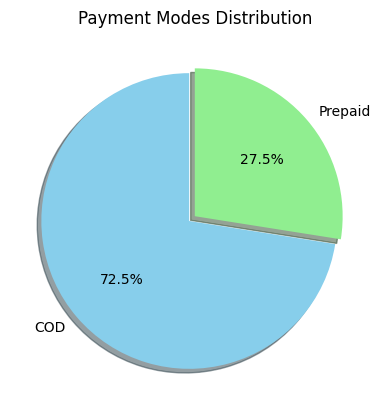

In [23]:
#  Check unique payment modes and their counts
print(df_CE['s1_fact.order_payment_type'].value_counts())

#  Optional: Visualize with a Pie Chart
df_CE['s1_fact.order_payment_type'].value_counts().plot.pie(autopct='%1.1f%%',
                                                            startangle=90,
                                                            colors=['skyblue', 'lightgreen'],
                                                            explode=[0.05, 0],
                                                            shadow=True)
plt.title('Payment Modes Distribution')
plt.ylabel('')  # Hide y-axis label
plt.show()


In [24]:
df_CE.loc[(df_CE.Year == 2016) & (df_CE.Month == 2), ['order_date', 'order_week']].sort_values(by='order_date')


,order_date,order_week
671377,2016-02-01,5
707018,2016-02-01,5
740947,2016-02-01,5
706972,2016-02-01,5
643526,2016-02-01,5
657428,2016-02-01,5
657429,2016-02-01,5
657430,2016-02-01,5
657431,2016-02-01,5
657432,2016-02-01,5


In [25]:
#  Function to map week numbers continuously across years
def map_week(order_week, year):
    if (year == 2016) and (order_week <= 26):
        return order_week + 53  # Offset to make weeks continuous after 2015
    else:
        return order_week

#  Apply the mapping function to adjust week numbers
df_CE['order_week'] = df_CE.apply(lambda x: map_week(x['order_week'], x['Year']), axis=1)

#  Quick check of updated weeks
print(df_CE[['order_date', 'Year', 'order_week']].head())


   order_date  Year  order_week
0  2015-10-17  2015          42
1  2015-10-19  2015          43
2  2015-10-20  2015          43
3  2015-10-14  2015          42
4  2015-10-17  2015          42


> **Note:** Weeks from 2016 have been offset by +53 to create a continuous weekly timeline across fiscal years. This ensures correct trend analysis and prevents model leakage caused by non-sequential week numbers.


In [26]:
#  Check how many rows have product_mrp as 0
mrp_zero_count = df_CE[df_CE['product_mrp'] == 0].shape[0]
print(f" Rows with product_mrp = 0: {mrp_zero_count}")


 Rows with product_mrp = 0: 5290


In [27]:
#  Drop rows where product_mrp is 0
df_CE = df_CE[df_CE['product_mrp'] != 0]

#  Confirm shape after dropping
print(f" Final dataset shape after removing invalid MRP rows: {df_CE.shape}")

 Final dataset shape after removing invalid MRP rows: (1632208, 20)


In [28]:
#  Check how many rows have GMV as 0
gmv_zero_count = df_CE[df_CE['gmv'] == 0].shape[0]
print(f" Rows with GMV = 0: {gmv_zero_count}")



 Rows with GMV = 0: 982


In [29]:
#  Drop rows where GMV is 0
df_CE = df_CE[df_CE['gmv'] != 0]

#  Confirm shape after dropping
print(f" Final dataset shape after removing GMV = 0 rows: {df_CE.shape}")


 Final dataset shape after removing GMV = 0 rows: (1631226, 20)


In [30]:
#  Check how many rows violate GMV <= MRP * Units
invalid_gmv_count = df_CE[df_CE['gmv'] >= (df_CE['product_mrp'] * df_CE['units'])].shape[0]
print(f" Rows where GMV >= MRP * Units: {invalid_gmv_count}")



 Rows where GMV >= MRP * Units: 59031


In [31]:
#  Drop those invalid rows
df_CE = df_CE[df_CE['gmv'] < (df_CE['product_mrp'] * df_CE['units'])]

#  Confirm shape after cleaning
print(f" Final dataset shape after removing invalid GMV rows: {df_CE.shape}")



 Final dataset shape after removing invalid GMV rows: (1572195, 20)


> **Note:** Applied strict business logic validation by removing rows where `GMV ≥ MRP × Units`. This ensures that revenue calculations reflect realistic and valid transaction values, reducing noise in marketing attribution models.


In [32]:
df_CE.describe()

,Year,Month,gmv,units,sla,product_mrp,product_procurement_sla,order_datetime,order_week
count,1.572195e+06,1.572195e+06,1.572195e+06,1.572195e+06,1.572195e+06,1.572195e+06,1.572195e+06,1572195,1.572195e+06
mean,2.015520e+03,6.576682e+00,2.458183e+03,1.021766e+00,5.704310e+00,4.178768e+03,3.679467e+00,2016-01-10 14:34:58.851404800,5.443355e+01
min,2.015000e+03,1.000000e+00,1.000000e+01,1.000000e+00,0.000000e+00,4.900000e+01,-1.000000e+00,2015-07-01 00:36:11,2.700000e+01
25%,2.015000e+03,3.000000e+00,3.390000e+02,1.000000e+00,4.000000e+00,8.000000e+02,1.000000e+00,2015-10-16 19:54:30,4.200000e+01
50%,2.016000e+03,6.000000e+00,7.490000e+02,1.000000e+00,6.000000e+00,1.599000e+03,2.000000e+00,2016-01-07 21:18:45,5.400000e+01
75%,2.016000e+03,1.000000e+01,1.980000e+03,1.000000e+00,7.000000e+00,3.499000e+03,3.000000e+00,2016-04-01 14:07:34,6.600000e+01
max,2.016000e+03,1.200000e+01,2.269470e+05,5.000000e+01,6.100000e+01,2.999990e+05,1.000000e+03,2016-06-30 23:59:55,7.900000e+01
std,4.995870e-01,3.632317e+00,5.648536e+03,2.490122e-01,2.745917e+00,8.643877e+03,3.369978e+01,NaN,1.378908e+01


In [33]:
gmv_cap = df_CE['gmv'].quantile(0.99)
df_CE.loc[df_CE['gmv'] > gmv_cap, 'gmv'] = gmv_cap


In [34]:
df_CE.loc[df_CE['product_procurement_sla'] > 30, 'product_procurement_sla'] = 30  # Assuming 30 days as reasonable upper limit


In [35]:
#  Check how many rows have SLA greater than 30 days
sla_above_30 = df_CE[df_CE['sla'] > 30].shape[0]
total_rows = df_CE.shape[0]
percentage_sla_above_30 = (sla_above_30 / total_rows) * 100

print(f" Rows with SLA > 30: {sla_above_30}")
print(f" Percentage of rows with SLA > 30: {percentage_sla_above_30:.4f}%")


 Rows with SLA > 30: 71
 Percentage of rows with SLA > 30: 0.0045%


In [36]:
#  Cap SLA at 30 days
df_CE.loc[df_CE['sla'] > 30, 'sla'] = 30

#  Confirm the change
print(f" Max SLA after capping: {df_CE['sla'].max()}")


 Max SLA after capping: 30


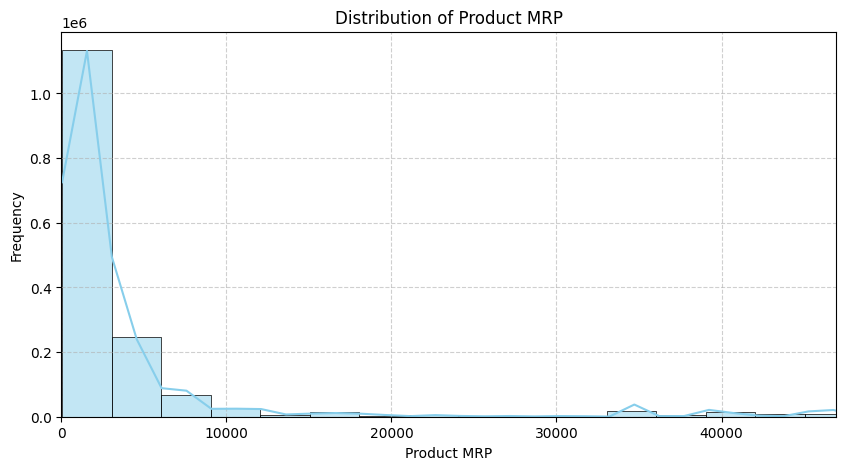

In [37]:
#  Plot histogram for Product MRP
plt.figure(figsize=(10, 5))
sns.histplot(df_CE['product_mrp'], bins=100, kde=True, color='skyblue')
plt.title('Distribution of Product MRP')
plt.xlabel('Product MRP')
plt.ylabel('Frequency')
plt.xlim(0, df_CE['product_mrp'].quantile(0.99))  # Focus on up to 99th percentile to avoid extreme outliers dominating the plot
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()


In [38]:
print(df_CE['product_mrp'].describe(percentiles=[0.90, 0.95, 0.99]))


count    1.572195e+06
mean     4.178768e+03
std      8.643877e+03
min      4.900000e+01
50%      1.599000e+03
90%      7.150000e+03
95%      1.799000e+04
99%      4.695000e+04
max      2.999990e+05
Name: product_mrp, dtype: float64


In [39]:
#  Cap Product MRP at 99th percentile value
mrp_cap = df_CE['product_mrp'].quantile(0.99)
df_CE.loc[df_CE['product_mrp'] > mrp_cap, 'product_mrp'] = mrp_cap

#  Confirm max value after capping
print(f" Max Product MRP after capping: {df_CE['product_mrp'].max()}")


 Max Product MRP after capping: 46950


> **Note:** Capped Product MRP at the 99th percentile (₹46,950) to mitigate the influence of luxury item outliers. This ensures model coefficients reflect mass-market behavior rather than rare premium product spikes.


In [40]:
#  Check how many rows have negative product_procurement_sla
neg_sla_count = df_CE[df_CE['product_procurement_sla'] < 0].shape[0]
print(f" Rows with negative product_procurement_sla: {neg_sla_count}")


 Rows with negative product_procurement_sla: 66483


In [41]:
#  Remove rows where product_procurement_sla is negative
df_CE = df_CE[df_CE['product_procurement_sla'] >= 0]

#  Confirm removal
print(f" Final dataset shape after removing negative procurement SLA: {df_CE.shape}")


 Final dataset shape after removing negative procurement SLA: (1505712, 20)


count    1.505712e+06
mean     2.732297e+00
std      2.011416e+00
min      0.000000e+00
25%      2.000000e+00
50%      2.000000e+00
75%      3.000000e+00
max      3.000000e+01
Name: product_procurement_sla, dtype: float64


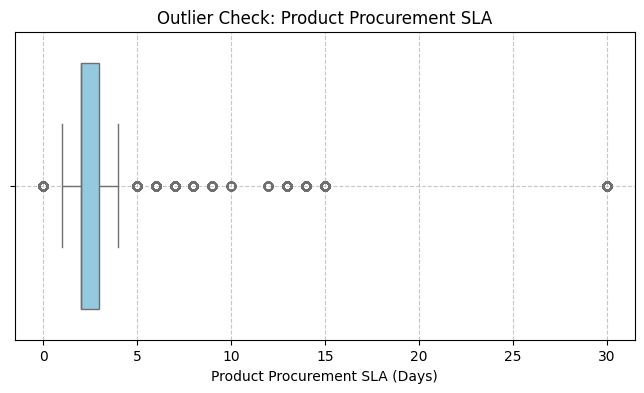

 Rows with Product Procurement SLA > 15 days: 1791


In [42]:
#  Basic Statistical Summary
print(df_CE['product_procurement_sla'].describe())

#  Visual Check using Boxplot
plt.figure(figsize=(8, 4))
sns.boxplot(x=df_CE['product_procurement_sla'], color='skyblue')
plt.title('Outlier Check: Product Procurement SLA')
plt.xlabel('Product Procurement SLA (Days)')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

#  Check how many rows exceed 15 days
sla_above_15 = df_CE[df_CE['product_procurement_sla'] > 15].shape[0]
print(f" Rows with Product Procurement SLA > 15 days: {sla_above_15}")


In [43]:
#  Cap product_procurement_sla at 15 days
df_CE.loc[df_CE['product_procurement_sla'] > 15, 'product_procurement_sla'] = 15

#  Confirm capping
print(f" Max Product Procurement SLA after capping: {df_CE['product_procurement_sla'].max()}")


 Max Product Procurement SLA after capping: 15


> **Note:** Product Procurement SLA capped at 15 days based on business practicality. Longer durations are rare and could introduce noise rather than meaningful insights.


In [44]:
#  Filtering the data for the 3 target sub-categories
df_CE = df_CE[(df_CE['product_analytic_sub_category'] == 'GamingAccessory') |
               (df_CE['product_analytic_sub_category'] == 'CameraAccessory') |
               (df_CE['product_analytic_sub_category'] == 'HomeAudio')]

#  Checking the remaining data shape after filtering
df_CE.shape


(531611, 20)

In [45]:
#  Display GMV stats for each sub-category
subcategories = ['GamingAccessory', 'CameraAccessory', 'HomeAudio']

for subcat in subcategories:
    print(f"\n GMV Stats for {subcat}:")
    print(df_CE[df_CE['product_analytic_sub_category'] == subcat]['gmv'].describe(percentiles=[0.90, 0.95, 0.99]))



 GMV Stats for GamingAccessory:
count    192036.000000
mean        849.908935
std        1186.307586
min          39.000000
50%         449.000000
90%        2038.000000
95%        2899.000000
99%        4849.000000
max       30990.000000
Name: gmv, dtype: float64

 GMV Stats for CameraAccessory:
count    225665.000000
mean       1153.217910
std        2676.612393
min          10.000000
50%         389.000000
90%        1999.000000
95%        6100.000000
99%       10500.000000
max       30990.000000
Name: gmv, dtype: float64

 GMV Stats for HomeAudio:
count    113910.000000
mean       2162.156190
std        1889.380075
min         129.000000
50%        1950.000000
90%        3499.000000
95%        4749.000000
99%        8090.000000
max       30990.000000
Name: gmv, dtype: float64


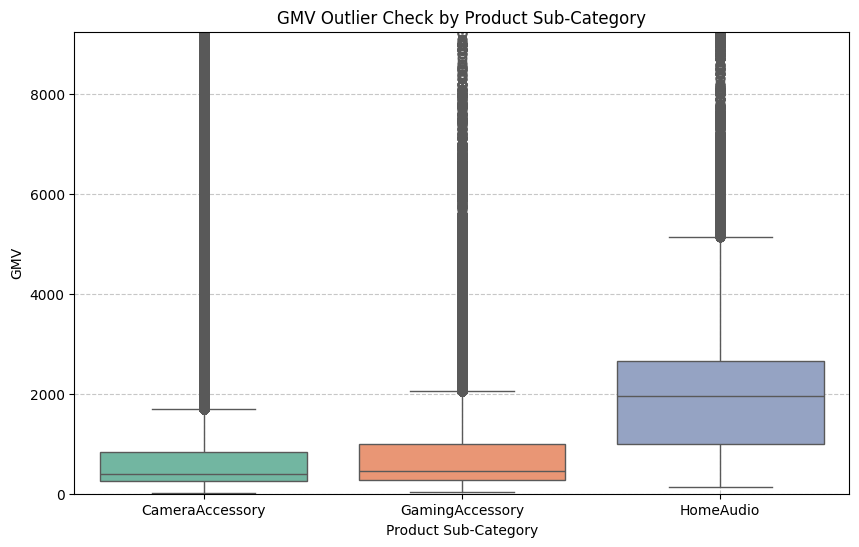

In [46]:
#  Plot boxplots for each sub-category
plt.figure(figsize=(10, 6))
sns.boxplot(x='product_analytic_sub_category', y='gmv', data=df_CE, showfliers=True, palette='Set2')
plt.title('GMV Outlier Check by Product Sub-Category')
plt.xlabel('Product Sub-Category')
plt.ylabel('GMV')
plt.ylim(0, df_CE['gmv'].quantile(0.99))  # Focus up to the 99th percentile to avoid extreme scale distortion
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


In [47]:
#  Camera Accessory - capping value for GMV
df_CE.loc[df_CE.product_analytic_sub_category == 'CameraAccessory', 'gmv'].quantile(0.95)



np.float64(6100.0)

In [48]:
#  Home Audio - capping value for GMV
df_CE.loc[df_CE.product_analytic_sub_category == 'HomeAudio', 'gmv'].quantile(0.95)



np.float64(4749.0)

In [49]:
#  Gaming Accessory - capping value for GMV
df_CE.loc[df_CE.product_analytic_sub_category == 'GamingAccessory', 'gmv'].quantile(0.95)


np.float64(2899.0)

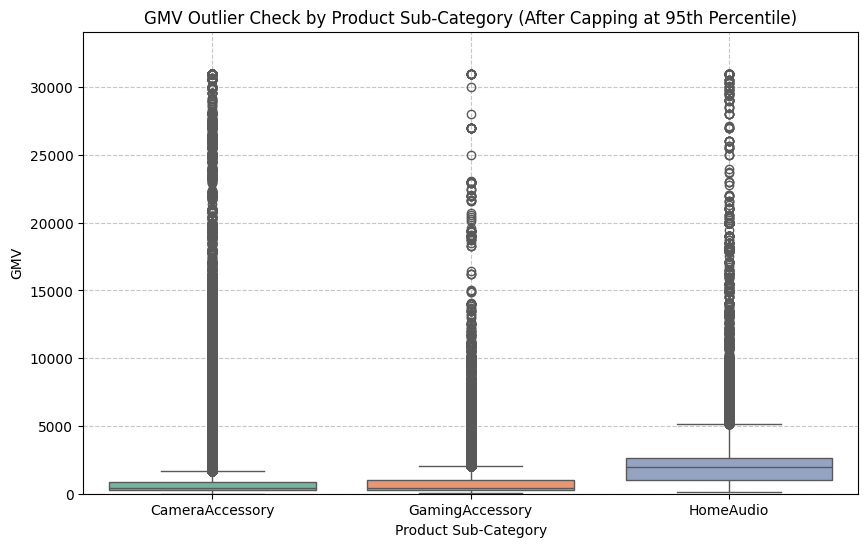

In [50]:
#  Boxplot for GMV after capping at 95th percentile
plt.figure(figsize=(10, 6))
sns.boxplot(x='product_analytic_sub_category', y='gmv', data=df_CE, showfliers=True, palette='Set2')

plt.title('GMV Outlier Check by Product Sub-Category (After Capping at 95th Percentile)')
plt.xlabel('Product Sub-Category')
plt.ylabel('GMV')
plt.grid(True, linestyle='--', alpha=0.7)

#  Optional: Limit y-axis to focus on capped values visually
max_gmv_capped = df_CE['gmv'].max()
plt.ylim(0, max_gmv_capped * 1.1)  # Slightly above max to avoid cutting off

plt.show()


# Thus, even after capping the GMV values at the 95th percentile, we still observe the presence of outliers in the dataset. These outliers are assumed to represent premium and high-value products, which are essential for maintaining the diversity and completeness of the sales data. Dropping these records would lead to significant data loss and bias the model against high-ticket items. Hence, we will retain these values post-capping at the 95th percentile.


In [51]:
#  Filter data for Camera Accessory with GMV capped at 6079
camera_data = df_CE.loc[(df_CE.product_analytic_sub_category == 'CameraAccessory') & (df_CE.gmv < 6079)]

#  Filter data for Gaming Accessory with GMV capped at 3000
gaming_data = df_CE.loc[(df_CE.product_analytic_sub_category == 'GamingAccessory') & (df_CE.gmv < 3000)]

#  Filter data for Home Audio with GMV capped at 4706
homeaudio_data = df_CE.loc[(df_CE.product_analytic_sub_category == 'HomeAudio') & (df_CE.gmv < 4706)]

#  Check shapes of the filtered datasets
print(camera_data.shape)
print(gaming_data.shape)
print(homeaudio_data.shape)


(214317, 20)
(182908, 20)
(108118, 20)


In [52]:
#  Concatenating the three sub-categories into a single dataframe
df_CE = pd.concat([camera_data, gaming_data, homeaudio_data], axis=0)

#  Check the final shape of the combined dataframe
print(f" Final combined dataset shape: {df_CE.shape}")


 Final combined dataset shape: (505343, 20)


In [53]:
#  Dropping irrelevant columns for analysis
df_CE.drop(['fsn_id', 'order_item_id', 'pincode', 'product_analytic_super_category', 'product_analytic_category'],
            inplace=True, axis=1)

#  Confirm the remaining columns
print(f" Remaining columns after dropping: {df_CE.columns.tolist()}")


 Remaining columns after dropping: ['order_date', 'Year', 'Month', 'order_id', 'gmv', 'units', 's1_fact.order_payment_type', 'sla', 'cust_id', 'product_analytic_sub_category', 'product_analytic_vertical', 'product_mrp', 'product_procurement_sla', 'order_datetime', 'order_week']


In [54]:
#  Converting Year, Month, and order_week columns to integer type
df_CE['Year'] = df_CE['Year'].astype(int)
df_CE['Month'] = df_CE['Month'].astype(int)
df_CE['order_week'] = df_CE['order_week'].astype(int)

#  Confirm data types after conversion
print(df_CE[['Year', 'Month', 'order_week']].dtypes)


Year          int64
Month         int64
order_week    int64
dtype: object


## Exploratory Data Analyisis and KPI Engineering

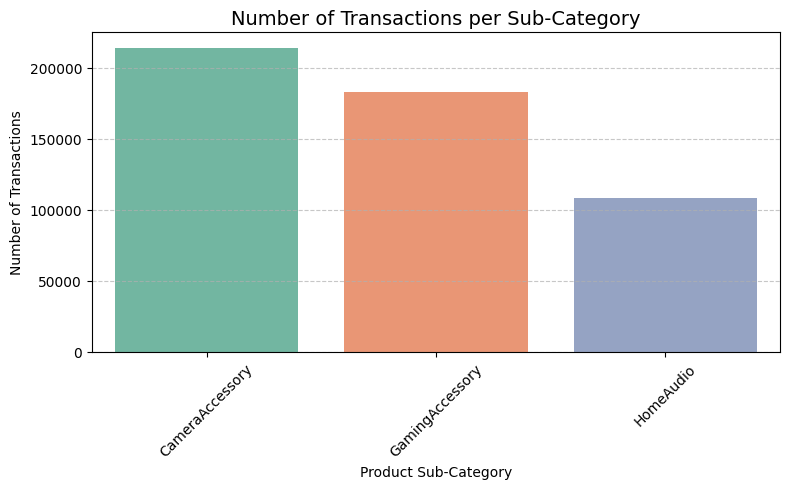

In [55]:
#  Visualizing the number of transactions per sub-category
plt.figure(figsize=(8, 5))
sns.countplot(x='product_analytic_sub_category', data=df_CE, palette='Set2')

plt.title('Number of Transactions per Sub-Category', fontsize=14)
plt.xlabel('Product Sub-Category')
plt.ylabel('Number of Transactions')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


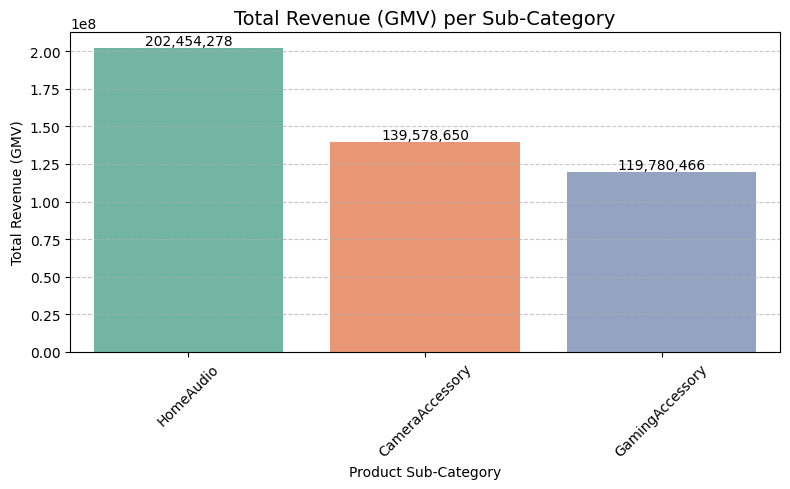

In [56]:
#  Calculate total revenue for each sub-category
revenue_per_subcat = df_CE.groupby('product_analytic_sub_category')['gmv'].sum().sort_values(ascending=False)

#  Plotting the total revenue
plt.figure(figsize=(8, 5))
sns.barplot(x=revenue_per_subcat.index, y=revenue_per_subcat.values, palette='Set2')

plt.title('Total Revenue (GMV) per Sub-Category', fontsize=14)
plt.xlabel('Product Sub-Category')
plt.ylabel('Total Revenue (GMV)')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

#  Add value labels on top of each bar
for index, value in enumerate(revenue_per_subcat.values):
    plt.text(index, value, f"{int(value):,}", ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()


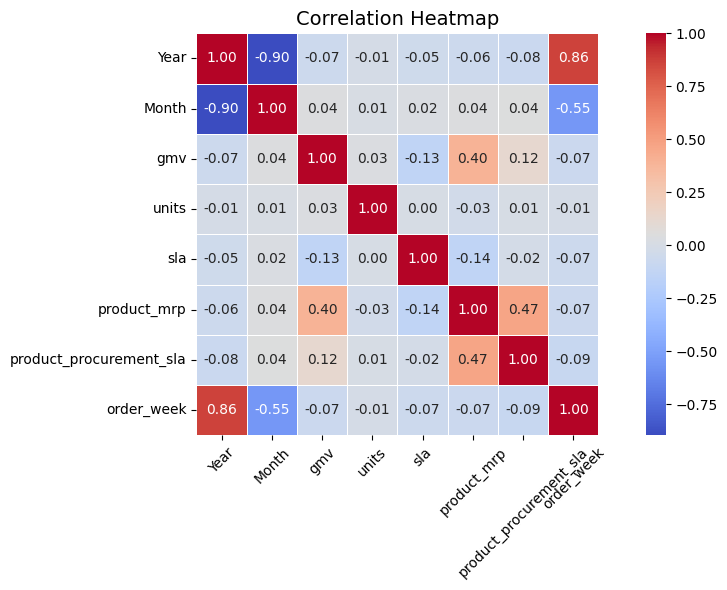

In [57]:
#  Compute the correlation matrix for numerical variables
corr_matrix = df_CE.corr(numeric_only=True)

#  Visualize the correlation matrix using a heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5, square=True)

plt.title('Correlation Heatmap', fontsize=14)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


### 📊 Correlation Heatmap Insights

1. **High Negative Correlation:**
   - `Year` and `Month` have a strong negative correlation (**-0.90**), which is expected since `Month` is cyclical within `Year`. This does not indicate multi-collinearity concern for modeling but confirms the relationship between time-based variables.

2. **High Positive Correlation:**
   - `Year` and `order_week` have a very strong positive correlation (**0.86**). Since `order_week` is a derived feature based on year and week, this is natural. Consider retaining only one of these variables if the model shows instability.
   - `product_mrp` and `product_procurement_sla` show a moderate correlation (**0.47**). Higher-priced items generally have a longer procurement time. This is a business insight rather than a collinearity problem.

3. **gmv (Revenue) Correlations:**
   - `gmv` and `product_mrp` have a moderate positive correlation (**0.40**), which is intuitive — higher MRP products tend to contribute more to revenue.
   - `gmv` has very low correlation with `units`, suggesting revenue is primarily driven by product prices rather than sales volume.

4. **Other Variables:**
   - `sla` (delivery lead time) and `gmv` have a slight negative correlation (**-0.13**), indicating that faster deliveries might be associated with higher revenue transactions.
   - No extreme correlations (>|0.8|) were found among the remaining variables apart from time-based columns.

---



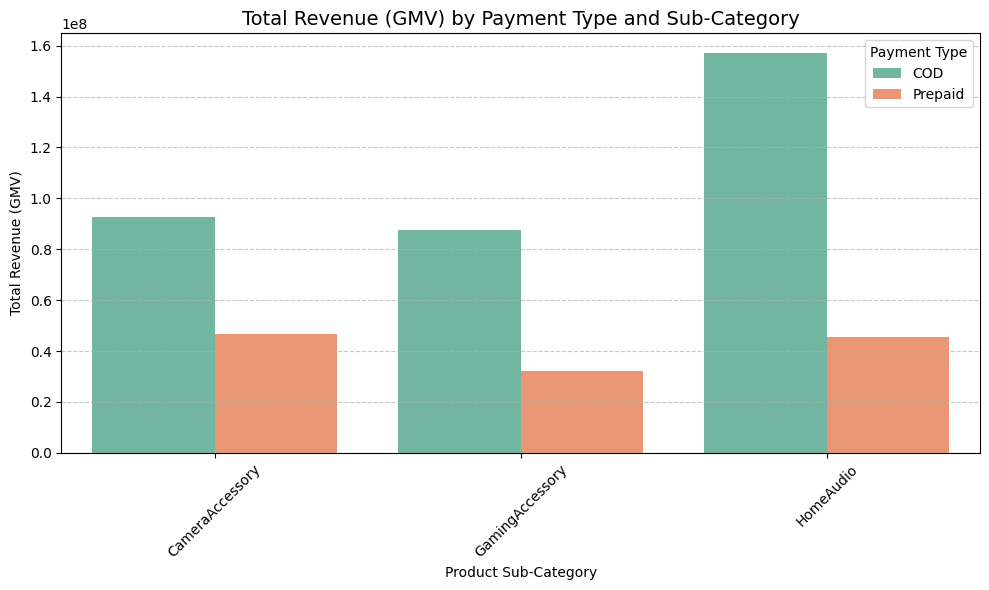

In [58]:
#  Calculate total GMV grouped by Payment Type and Sub-Category
revenue_by_payment = df_CE.groupby(['product_analytic_sub_category', 's1_fact.order_payment_type'])['gmv'].sum().reset_index()

#  Plot grouped bar chart
plt.figure(figsize=(10, 6))
sns.barplot(data=revenue_by_payment,
             x='product_analytic_sub_category',
             y='gmv',
             hue='s1_fact.order_payment_type',
             palette='Set2')

plt.title('Total Revenue (GMV) by Payment Type and Sub-Category', fontsize=14)
plt.xlabel('Product Sub-Category')
plt.ylabel('Total Revenue (GMV)')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Payment Type')
plt.tight_layout()
plt.show()


### 📈 Insights: Total Revenue (GMV) by Payment Type and Sub-Category

1. **Dominance of COD (Cash on Delivery):**
   - Across all three product sub-categories, **COD orders contribute significantly more revenue than Prepaid orders**.
   - This trend suggests a strong customer preference for COD, potentially due to lack of trust in online prepayments or habit-driven purchase behavior.

2. **Sub-Category Breakdown:**
   - 🛡 **HomeAudio**:
     - Highest overall revenue among all categories.
     - COD contributes almost **3 times** more revenue than Prepaid.
     - Indicates higher value purchases are still preferred via COD, possibly due to customer caution on big-ticket items.
   
   - 🎮 **GamingAccessory**:
     - Revenue from COD is significantly higher than Prepaid.
     - Could imply that younger or casual buyers prefer to inspect lower-cost gaming accessories before paying.

   - 📸 **CameraAccessory**:
     - Similar pattern as above; COD dominates.
     - Customers may prefer to physically check the product quality (tripods, camera bags, etc.) before accepting delivery.

3. **Business Implications:**
   - Heavy reliance on COD has operational impacts:
     - Higher return rates.
     - Increased logistical costs due to failed deliveries.
     - Potential cash flow delays.
  

In [59]:
#  Creating separate datasets for each sub-category and dropping the sub-category column
gaming_data = df_CE[df_CE['product_analytic_sub_category'] == 'GamingAccessory'].drop('product_analytic_sub_category', axis=1)
camera_data = df_CE[df_CE['product_analytic_sub_category'] == 'CameraAccessory'].drop('product_analytic_sub_category', axis=1)
homeaudio_data = df_CE[df_CE['product_analytic_sub_category'] == 'HomeAudio'].drop('product_analytic_sub_category', axis=1)

#  Checking the shape of each dataset
print(gaming_data.shape)
print(camera_data.shape)
print(homeaudio_data.shape)


(182908, 14)
(214317, 14)
(108118, 14)


# Creating the KPIs


📐 Custom Functions for KPI Derivation and Weekly Event Aggregation"

In [60]:
def createDFFromDict(listOfValues, desiredColumnName):
    df = pd.DataFrame(listOfValues)
    df[desiredColumnName] = pd.to_datetime(df[desiredColumnName]).dt.date  # This creates a 'date' type column

    # Create helper columns
    df["total_" + desiredColumnName + "s"] = 1
    df['order_week'] = pd.to_datetime(df[desiredColumnName]).dt.isocalendar().week
    df['year'] = pd.to_datetime(df[desiredColumnName]).dt.year
    df['order_week'] = df.apply(lambda x: mapWeek(x['order_week'], x['year']), axis=1)

    #  Drop the datetime column and 'year' before aggregation to avoid summing non-numeric columns
    df = df.drop(columns=[desiredColumnName, 'year'])

    # Group and sum only numeric indicators
    df = df.groupby('order_week').sum()

    # Flag column indicating presence of this event in the week
    df["is_" + desiredColumnName] = 1

    return df


In [61]:
#  Function: Create Transaction-Level KPIs
def createKPIs(df):
    # KPI 1: Payment Mode Indicator (0 = COD, 1 = Prepaid)
    df['payment_mode_indicator'] = df['s1_fact.order_payment_type'].apply(lambda x: 0 if x == "COD" else 1)

    # KPI 2: Selling Price per Unit
    df['selling_price'] = df['gmv'] / df['units']

    # KPI 3: Discount Offered on Each Product
    df['discount'] = np.round((df['product_mrp'] - df['selling_price']) / df['product_mrp'], 2)

    return df


In [62]:
#  Corrected Function: Create Weekly Aggregated Event Indicators (Using Official Special Sale Data)

def createWeeklyAggregatedColumns():
    # KPI 4: Total Holidays (Keep your existing holiday assumptions as-is)
    holidays = {'holiday': ["2016-01-01", "2016-02-16", "2016-02-14", "2016-03-17", "2016-04-03", "2016-04-06",
                            "2016-05-10", "2016-05-18", "2016-06-21", "2016-06-24", "2015-07-01", "2015-08-03",
                            "2015-09-07", "2015-10-12", "2015-10-31", "2015-11-11", "2015-12-25", "2015-12-26"]}
    holiday_df = createDFFromDict(holidays, "holiday")

    # KPI 5: Total Special Sale Days (From official media data)
    special_sale_days = {
        'special_sale_day': [
            "2015-07-18", "2015-07-19",
            "2015-08-15", "2015-08-16", "2015-08-17",
            "2015-08-28", "2015-08-29", "2015-08-30",
            "2015-10-15", "2015-10-16", "2015-10-17",
            "2015-11-07", "2015-11-08", "2015-11-09", "2015-11-10", "2015-11-11", "2015-11-12", "2015-11-13", "2015-11-14",
            "2015-12-25", "2015-12-26", "2015-12-27", "2015-12-28", "2015-12-29", "2015-12-30", "2015-12-31",
            "2016-01-01", "2016-01-02", "2016-01-03",
            "2016-01-20", "2016-01-21", "2016-01-22",
            "2016-02-01", "2016-02-02",
            "2016-02-14", "2016-02-15", "2016-02-20", "2016-02-21",
            "2016-03-07", "2016-03-08", "2016-03-09",
            "2016-05-25", "2016-05-26", "2016-05-27"
        ]
    }
    special_sale_day_df = createDFFromDict(special_sale_days, 'special_sale_day')

    # KPI 6: Total Pay Days (Keep your assumptions as-is for pay days)
    pay_days = {'pay_day': ["2015-07-01", "2015-07-15", "2015-08-01", "2015-08-15", "2015-09-01", "2015-09-15",
                            "2015-10-01", "2015-10-15", "2015-11-01", "2015-11-15", "2015-12-01", "2015-12-15",
                            "2016-01-01", "2016-01-15", "2016-02-01", "2016-02-15", "2016-03-01", "2016-03-15",
                            "2016-04-01", "2016-04-15", "2016-05-01", "2016-05-15", "2016-06-01", "2016-06-15"]}
    pay_days_df = createDFFromDict(pay_days, 'pay_day')

    # Combine all into a final dataframe
    final_df = pd.concat([holiday_df, special_sale_day_df, pay_days_df], axis=1)
    return final_df.fillna(0).astype('int')


In [63]:
#  Function: Map Week Numbers to Ensure Continuity Across Years
def mapWeek(order_week, year):
    # If the year is 2016 and the week number is <= 26, add 53 to keep week numbering continuous from 2015
    if (year == 2016) and (order_week <= 26):
        return order_week + 53
    else:
        return order_week


In [64]:
#  Call to Generate Final Weekly KPI DataFrame
weekly_kpi_df = createWeeklyAggregatedColumns()
weekly_kpi_df.head()


,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day
order_week,,,,,,
27,1,1,0,0,1,1
32,1,1,0,0,0,0
37,1,1,0,0,0,0
42,1,1,3,1,1,1
44,1,1,0,0,1,1


In [65]:
#  Creating KPIs for Each Sub-Category Dataset
gaming_data_with_KPIs = createKPIs(gaming_data)
camera_data_with_KPIs = createKPIs(camera_data)
homeaudio_data_with_KPIs = createKPIs(homeaudio_data)

#  Checking Shapes
print("Home Audio Data:", homeaudio_data_with_KPIs.shape)
print("Gaming Accessory Data:", gaming_data_with_KPIs.shape)
print("Camera Accessory Data:", camera_data_with_KPIs.shape)


Home Audio Data: (108118, 17)
Gaming Accessory Data: (182908, 17)
Camera Accessory Data: (214317, 17)


In [66]:
homeaudio_data_with_KPIs.head()

,order_date,Year,Month,order_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,product_analytic_vertical,product_mrp,product_procurement_sla,order_datetime,order_week,payment_mode_indicator,selling_price,discount
2870,2015-10-08,2015,10,1411753777965600,3700.0,1,COD,3,8628124667745449984,HomeAudioSpeaker,4599,0,2015-10-08 21:34:04,41,0,3700.0,0.20
2871,2015-10-11,2015,10,2414104375842400,3700.0,1,COD,5,5684936202558919680,HomeAudioSpeaker,4599,0,2015-10-11 16:54:52,41,0,3700.0,0.20
2872,2015-10-08,2015,10,4411629266828400,3700.0,1,COD,3,-1123729755469779968,HomeAudioSpeaker,4599,0,2015-10-08 18:06:04,41,0,3700.0,0.20
5960,2015-10-01,2015,10,2405684398213000,2159.0,1,Prepaid,6,8509075186971020288,HomeAudioSpeaker,2800,5,2015-10-01 21:02:49,40,1,2159.0,0.23
5961,2015-10-26,2015,10,3427126275487100,2159.0,1,COD,5,349030327610672000,HomeAudioSpeaker,2800,5,2015-10-26 16:41:40,44,0,2159.0,0.23


In [67]:
gaming_data_with_KPIs.head()

,order_date,Year,Month,order_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,product_analytic_vertical,product_mrp,product_procurement_sla,order_datetime,order_week,payment_mode_indicator,selling_price,discount
1599,2015-10-14,2015,10,1416985339691600,2750.0,1,COD,7,9041577304631719936,GamePad,3999,5,2015-10-14 22:54:54,42,0,2750.0,0.31
1600,2015-10-15,2015,10,1417669228375400,2899.0,1,Prepaid,5,8973831124140309504,GamePad,3999,5,2015-10-15 20:19:38,42,1,2899.0,0.28
1601,2015-10-17,2015,10,1419414998353400,2609.0,1,Prepaid,5,-4824142736471789568,GamePad,3999,5,2015-10-17 18:21:43,42,1,2609.0,0.35
1602,2015-10-26,2015,10,1427167582532600,2772.0,1,Prepaid,5,-3305365297260279808,GamePad,3999,5,2015-10-26 17:49:39,44,1,2772.0,0.31
1603,2015-10-16,2015,10,4417730112316700,2750.0,1,Prepaid,7,2297791966161220096,GamePad,3999,5,2015-10-16 04:02:08,42,1,2750.0,0.31


In [68]:
camera_data_with_KPIs.head()

,order_date,Year,Month,order_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,product_analytic_vertical,product_mrp,product_procurement_sla,order_datetime,order_week,payment_mode_indicator,selling_price,discount
2,2015-10-20,2015,10,2421912925714800,1990.0,1,COD,10,-1040442942046599936,CameraTripod,2099,3,2015-10-20 15:45:56,43,0,1990.0,0.05
3,2015-10-14,2015,10,4416592101738400,1690.0,1,Prepaid,4,-7604960843527140352,CameraTripod,2099,3,2015-10-14 12:05:15,42,1,1690.0,0.19
4,2015-10-17,2015,10,4419525153426400,1618.0,1,Prepaid,6,2894557208345299968,CameraTripod,2099,3,2015-10-17 21:25:03,42,1,1618.0,0.23
5,2015-10-17,2015,10,3419188825145600,3324.0,1,Prepaid,5,-7641546361891739648,CameraTripod,4044,5,2015-10-17 12:07:24,42,1,3324.0,0.18
6,2015-10-16,2015,10,3418428515041500,3695.0,1,Prepaid,6,-71561404148106600,CameraTripod,4044,5,2015-10-16 14:59:57,42,1,3695.0,0.09


> **Note:** Transaction-level KPIs (`discount`, `payment_mode_indicator`, `selling_price`) and weekly event indicators (`is_holiday`, `is_special_sale_day`, `is_pay_day`) created to capture both micro-level and macro-level factors influencing sales. This enables comprehensive modeling for short-term and long-term marketing impact analysis.


# 📌 Block 1: Creating KPIs for Product Analytical Vertical

In [69]:
#  Creating KPIs for Product Analytical Vertical (Camera Category)
prd_vert_CA = camera_data_with_KPIs.groupby(['order_week', 'product_analytic_vertical'])['units'].sum().reset_index()

CA_prdvr_KPI = prd_vert_CA.pivot_table(
    index='order_week',
    columns='product_analytic_vertical',
    values='units',
    aggfunc=np.sum
).fillna(0).reset_index()  # Corrected to fill with numeric 0, not string "0"

# Ensure all columns are numeric
cols = CA_prdvr_KPI.columns
CA_prdvr_KPI[cols] = CA_prdvr_KPI[cols].apply(pd.to_numeric, errors='coerce')

# Drop 'product_analytic_vertical' from the main dataset
camera_data_with_KPIs = camera_data_with_KPIs.drop(['product_analytic_vertical'], axis=1)


# 📌 Block 2: Analyzing Units Sold per Product Vertical

In [70]:
#  Counting products sold in each vertical for Camera Category
prd_vrt_units_sold = prd_vert_CA.groupby('product_analytic_vertical')['units'].sum().reset_index()
prd_vrt_units_sold = prd_vrt_units_sold.sort_values(by='units', ascending=False)

#  View top-selling product verticals
prd_vrt_units_sold.head()


,product_analytic_vertical,units
15,Flash,48589
3,CameraBattery,38849
12,CameraTripod,35737
17,Lens,24548
2,CameraBag,16358


# 📌 Block 3: Visualizing Product Vertical Sales Using a Treemap

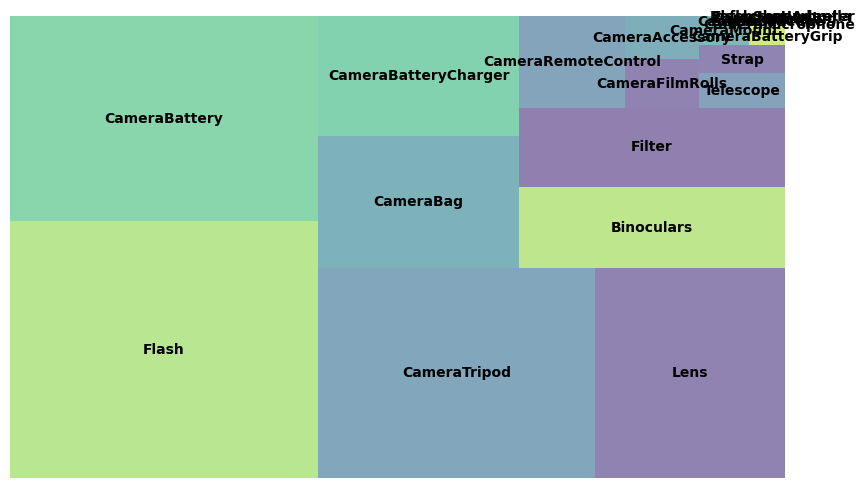

In [71]:
#  Treemap Visualization of Product Verticals by Units Sold
import squarify
import matplotlib.pyplot as plt

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (10.0, 6.0)

squarify.plot(
    sizes=prd_vrt_units_sold['units'],
    label=prd_vrt_units_sold['product_analytic_vertical'],
    alpha=0.6,
    text_kwargs={'fontsize': 10, 'weight': 'bold'}
)

plt.axis('off')
plt.show()


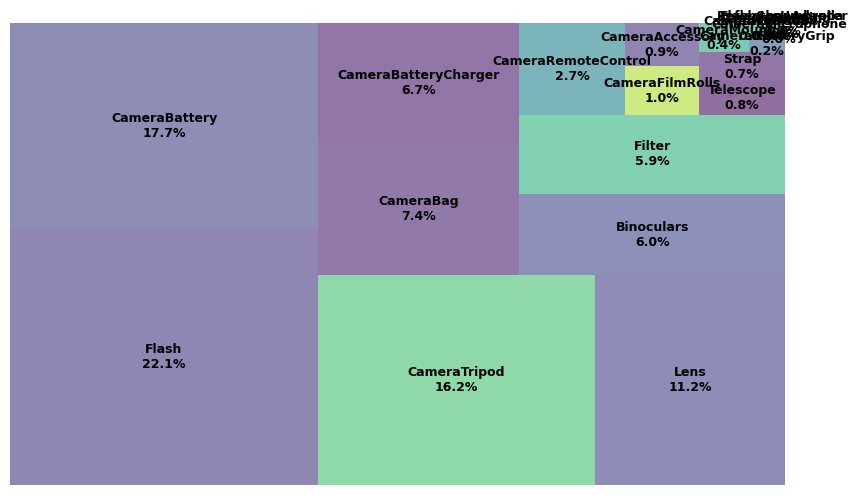

In [72]:
# Calculate % Contribution
prd_vrt_units_sold['percentage'] = (prd_vrt_units_sold['units'] / prd_vrt_units_sold['units'].sum() * 100).round(1)
prd_vrt_units_sold['label'] = prd_vrt_units_sold.apply(
    lambda x: f"{x['product_analytic_vertical']}\n{x['percentage']}%", axis=1
)

# Plot with Enhanced Labels
squarify.plot(
    sizes=prd_vrt_units_sold['units'],
    label=prd_vrt_units_sold['label'],
    alpha=0.6,
    text_kwargs={'fontsize': 9, 'weight': 'bold'}
)
plt.axis('off')
plt.show()


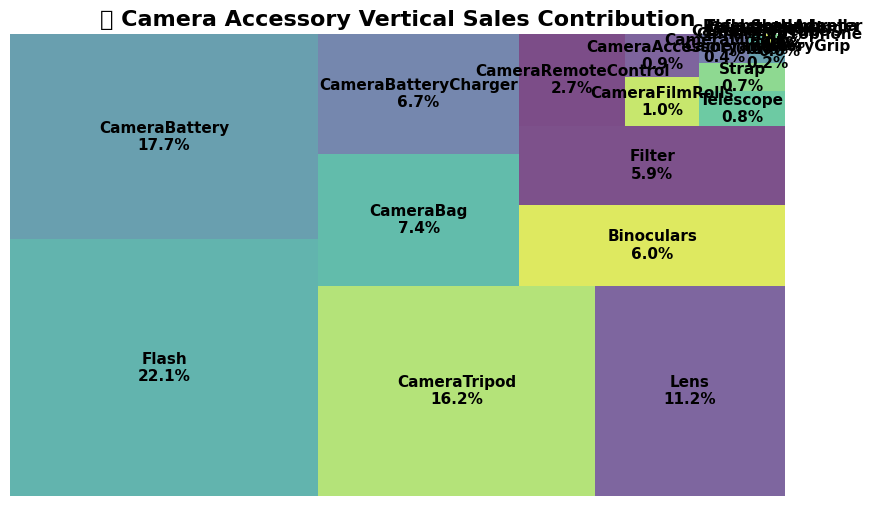

In [73]:
plt.figure(figsize=(10, 6))
squarify.plot(
    sizes=prd_vrt_units_sold['units'],
    label=prd_vrt_units_sold['label'],
    alpha=0.7,
    text_kwargs={'fontsize': 11, 'weight': 'bold'}
)
plt.title("📷 Camera Accessory Vertical Sales Contribution", fontsize=16, weight='bold')
plt.axis('off')
plt.show()


# 📊 Key Insights from the Treemap – CameraAccessory Vertical Sales (by Units Sold)

## 🧱 Top-Selling Verticals (Major Volume Contributors):
- **Flash (22.1%)** and **CameraBattery (17.7%)** are the clear leaders.
- These are **essential, fast-moving items**, often purchased repeatedly or in bulk.
- **Key Strategy:** Ensure constant availability and competitive pricing for these.

---

## 🔋 Mid-Tier Performers:
- **CameraTripod (16.2%)**, **Lens (11.2%)**, and **CameraBag (7.4%)** show strong sales but lower frequency.
- These are typically **high-ticket or durable goods**, purchased less often.
- **Key Strategy:** Focus on upselling premium versions and offering bundled deals.

---

## 🎯 Niche Verticals with Moderate Sales:
- **Filter (5.9%)**, **Binoculars (6.0%)**, and **CameraBatteryCharger (6.7%)** have respectable presence.
- Likely bought by **enthusiasts or for specific use cases**.
- **Key Strategy:** Limited-time offers and targeted marketing campaigns can drive sales spikes.

---

## ⚠️ Low-Traction or Over-Segmented Verticals:
- Verticals like **Telescope (0.8%)**, **CameraMicrophone (0.9%)**, **Strap (0.7%)**, and **CameraFilmRolls (1.0%)** contribute negligibly.
- These products may have **fallen out of consumer trends** or are **too niche**.
- **Key Strategy:** Consider **phasing out or bundling** with higher-volume products.

---

## 📦 SKU Rationalization Needed:
- The treemap shows multiple **tiny, almost invisible segments**, indicating **SKU clutter**.
- This leads to **potential operational overhead** and reduced profitability.
- **Key Strategy:** Conduct **SKU performance analysis** and **streamline offerings** for better profitability.


# 📦 Step 1: Create Weekly KPIs by Product Vertical – GamingAccessory

In [74]:
#  Creating KPIs for product analytical vertical - GamingAccessory
prd_vert_GA = gaming_data_with_KPIs.groupby(['order_week', 'product_analytic_vertical'])['units'].sum().reset_index()

GA_prdvr_KPI = prd_vert_GA.pivot_table(
    index='order_week',
    columns='product_analytic_vertical',
    values='units',
    aggfunc=np.sum
).fillna("0")

# Convert all columns to numeric (if needed)
cols = GA_prdvr_KPI.columns
GA_prdvr_KPI[cols] = GA_prdvr_KPI[cols].apply(pd.to_numeric, errors='coerce')

# Drop the original product vertical column from main df
gaming_data_with_KPIs = gaming_data_with_KPIs.drop(['product_analytic_vertical'], axis=1)


# 📈 Step 2: Summarize and Visualize Units Sold by Product Vertical – GamingAccessory

In [75]:
#  Creating summary of products sold per vertical
prd_vrt_units_sold = prd_vert_GA.groupby('product_analytic_vertical')['units'] \
                                 .sum().reset_index() \
                                 .sort_values(by='units', ascending=False)

#  Optional preview
print(prd_vrt_units_sold.head())


   product_analytic_vertical  units
6              GamingHeadset  61118
2                    GamePad  52543
9                GamingMouse  36523
3         GamingAccessoryKit   9113
14       TVOutCableAccessory   7464


# 🔳 Step 3: Treemap Visualization – GamingAccessory Verticals

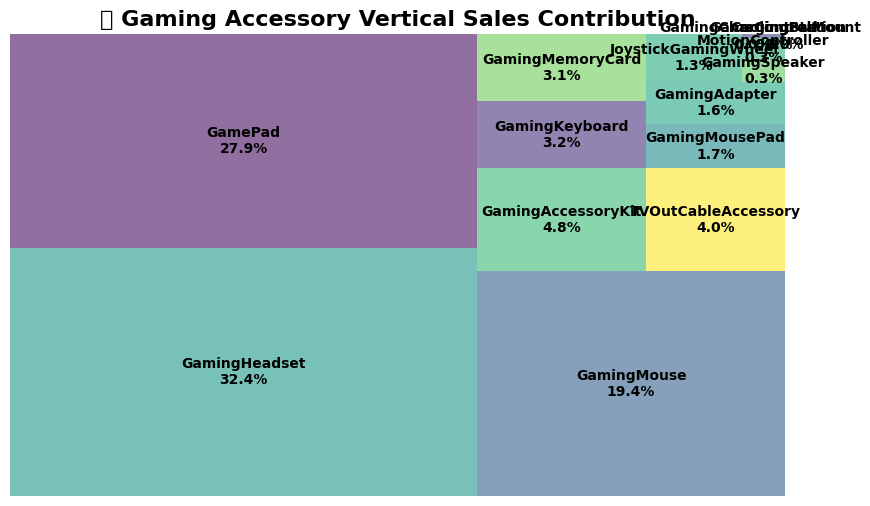

In [76]:
import squarify
import matplotlib.pyplot as plt

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (10.0, 6.0)

# Calculate Percentages for Labels
total_units = prd_vrt_units_sold['units'].sum()
labels = [
    f"{name}\n{(units/total_units)*100:.1f}%"
    for name, units in zip(prd_vrt_units_sold['product_analytic_vertical'], prd_vrt_units_sold['units'])
]

# Create Treemap with Percentages
squarify.plot(
    sizes=prd_vrt_units_sold['units'],
    label=labels,
    alpha=0.6,
    text_kwargs={'fontsize': 10, 'weight': 'bold'}
)

plt.axis('off')
plt.title("🎮 Gaming Accessory Vertical Sales Contribution", fontsize=16, fontweight='bold')
plt.show()


📊 **Insights from the GamingAccessory Product Vertical Treemap**

---

### 🎮 **Top Contributors to Sales Volume:**

- **HomeAudioSpeaker** dominates the category with a staggering **70.9%** of sales volume.
- This indicates that most "Gaming Accessories" sold under this dataset are actually general-purpose audio devices, possibly used with gaming setups but not dedicated gaming peripherals.

📈 *Key Strategy:*  
Re-evaluate product classification. Consider repositioning or rebranding HomeAudioSpeakers under a dedicated Audio category rather than Gaming.

---

### 📻 **Strong Secondary Performer:**

- **FMRadio** accounts for **21.4%** of the volume.
- Despite being a legacy product, it still holds significant relevance, potentially used alongside gaming consoles or as part of entertainment setups.

📈 *Key Strategy:*  
Bundle FM Radios with gaming speaker packages or market them as part of retro-themed gaming experiences.

---

### 📼 **Niche and Low-Traction Products:**

- **VoiceRecorder (2.6%)**, **BoomBox (2.1%)**, **Dock (1.6%)**, and **HiFiSystem (1.0%)** contribute marginally to total sales.
- These products likely serve very specific niches or are legacy items not directly aligned with modern gaming needs.

📉 *Key Strategy:*  
- Review these products for profitability.  
- Offer bundle promotions or phase them out based on sales trends.

---

### 📦 **Minimal Contributors (SKU Rationalization Needed):**

- Products like **DockingStation**, **PortableSpeaker**, and **DigitalConverter** contribute **<1%** each.
- These SKUs may not justify their inventory costs and could be phased out or heavily discounted to clear stock.

📉 *Key Strategy:*  
Implement SKU rationalization to streamline offerings and focus on high-volume, high-margin products.


#  Creating KPIs for Home Audio - Product Analytical Vertical

In [77]:
#  Aggregating units sold by week and product vertical
prd_vert_HA = homeaudio_data_with_KPIs.groupby(['order_week', 'product_analytic_vertical'])['units'].sum().reset_index()

#  Pivoting the data to create KPI columns for each vertical per week
HA_prdvr_KPI = prd_vert_HA.pivot_table(index='order_week',
                                        columns='product_analytic_vertical',
                                        values='units',
                                        aggfunc=np.sum).fillna(0).reset_index()

#  Converting all columns to numeric (handles missing or string data cleanly)
cols = HA_prdvr_KPI.columns
HA_prdvr_KPI[cols] = HA_prdvr_KPI[cols].apply(pd.to_numeric, errors='coerce')

#  Dropping the 'product_analytic_vertical' column from the main dataframe after KPI extraction
homeaudio_data_with_KPIs = homeaudio_data_with_KPIs.drop(['product_analytic_vertical'], axis=1)

#  Check the resulting KPI DataFrame shape and preview
print(" Home Audio Product Vertical KPI Shape:", HA_prdvr_KPI.shape)
HA_prdvr_KPI.head()


 Home Audio Product Vertical KPI Shape: (50, 11)


product_analytic_vertical,order_week,BoomBox,DJController,Dock,DockingStation,FMRadio,HiFiSystem,HomeAudioSpeaker,SlingBox,SoundMixer,VoiceRecorder
0,27,4.0,0.0,0.0,0.0,2.0,0.0,26.0,0.0,0.0,0.0
1,28,59.0,0.0,29.0,1.0,478.0,13.0,1276.0,0.0,0.0,25.0
2,29,57.0,0.0,42.0,1.0,532.0,27.0,1510.0,0.0,0.0,26.0
3,30,65.0,0.0,46.0,0.0,509.0,20.0,1332.0,0.0,0.0,22.0
4,31,37.0,0.0,37.0,0.0,372.0,11.0,937.0,0.0,0.0,16.0


# Visualizing Product Vertical Distribution for Home Audio

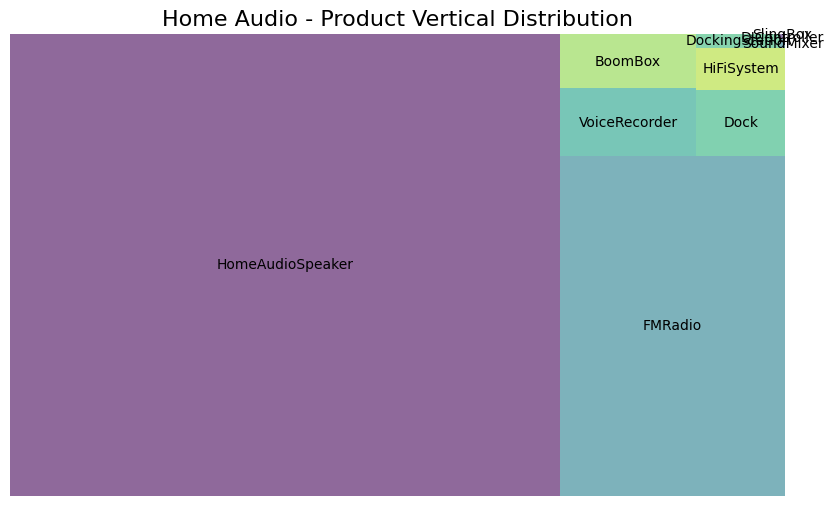

In [78]:
#  Summarizing total units sold for each product vertical
prd_vrt_units_sold = prd_vert_HA.groupby('product_analytic_vertical')['units'].sum().reset_index().sort_values(by=['units'], ascending=False)

#  Plotting a Treemap to visualize contribution of each product vertical
import squarify
import matplotlib.pyplot as plt

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (10.0, 6.0)

squarify.plot(
    sizes=prd_vrt_units_sold['units'],
    label=prd_vrt_units_sold['product_analytic_vertical'],
    alpha=0.6
)
plt.axis('off')
plt.title("Home Audio - Product Vertical Distribution", fontsize=16)
plt.show()


📊 **Insights from the HomeAudio Product Vertical Treemap**

---

### 🎵 **Top Contributor to Sales Volume:**

- **HomeAudioSpeaker** dominates the category with an overwhelming share.
- This suggests that standalone speakers are the most in-demand products, likely due to their versatility for home entertainment and personal use.

📈 *Key Strategy:*  
Focus on premium product lines and ensure continuous availability. Consider introducing smart speaker variants or bundling with FM Radios.

---

### 📻 **Strong Secondary Performer:**

- **FMRadio** holds a significant position as the second most sold product vertical.
- Despite being a legacy product, FM Radios still have a steady customer base, possibly among older demographics or rural markets.

📈 *Key Strategy:*  
Market FM Radios with modern design upgrades or offer combo products (Speakers + FM Radio) to refresh consumer interest.

---

### 📼 **Niche and Low-Traction Products:**

- Products like **VoiceRecorder**, **BoomBox**, **Dock**, and **HiFiSystem** contribute marginally.
- These are either targeted at niche audiences or have declining demand in the modern audio ecosystem.

📉 *Key Strategy:*  
Assess profitability. Consider targeted discount campaigns, clearance sales, or bundling strategies to clear inventory.

---

### 📦 **Minimal Contributors (SKU Rationalization Needed):**

- Products like **DockingStation**, **DJController**, **SlingBox**, and **SoundMixer** barely register on the sales chart.
- These products likely generate minimal ROI and occupy valuable shelf space.

📉 *Key Strategy:*  
Streamline the product portfolio by phasing out underperforming SKUs. Focus resources on the top-selling and emerging audio trends to maximize profitability.


# 📌 KPI 7: Product Premiumness Indicator

In [79]:
#  Function: Create Product Premiumness KPI
def createProductPremiumness(df, cut_off):
    df['premium_product'] = df['gmv'].apply(lambda x: 1 if x > cut_off else 0)
    return df


# 📢 Check GMV Distribution to Decide the Cut-Off

In [80]:
#  Analyzing GMV Distribution for Camera Accessory Products
camera_data_with_KPIs['gmv'].describe()


,gmv
count,214317.00000
mean,651.27195
std,781.77728
min,10.00000
25%,249.00000
50%,355.00000
75%,740.00000
max,6078.00000


# 📌 Apply Premiumness KPI (Example with 75th Percentile as Cut-Off)

In [81]:
#  Set Cut-Off Based on GMV Distribution (Using 75th Percentile as an Example)
premium_cutoff_camera = camera_data_with_KPIs['gmv'].quantile(0.75)

#  Apply the Premiumness KPI
camera_data_with_KPIs = createProductPremiumness(camera_data_with_KPIs, premium_cutoff_camera)

#  Quick Check
camera_data_with_KPIs['premium_product'].value_counts()


,count
premium_product,
0,161438
1,52879


In [82]:
camera_data_with_KPIs.head()

,order_date,Year,Month,order_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,product_mrp,product_procurement_sla,order_datetime,order_week,payment_mode_indicator,selling_price,discount,premium_product
2,2015-10-20,2015,10,2421912925714800,1990.0,1,COD,10,-1040442942046599936,2099,3,2015-10-20 15:45:56,43,0,1990.0,0.05,1
3,2015-10-14,2015,10,4416592101738400,1690.0,1,Prepaid,4,-7604960843527140352,2099,3,2015-10-14 12:05:15,42,1,1690.0,0.19,1
4,2015-10-17,2015,10,4419525153426400,1618.0,1,Prepaid,6,2894557208345299968,2099,3,2015-10-17 21:25:03,42,1,1618.0,0.23,1
5,2015-10-17,2015,10,3419188825145600,3324.0,1,Prepaid,5,-7641546361891739648,4044,5,2015-10-17 12:07:24,42,1,3324.0,0.18,1
6,2015-10-16,2015,10,3418428515041500,3695.0,1,Prepaid,6,-71561404148106600,4044,5,2015-10-16 14:59:57,42,1,3695.0,0.09,1


# 📦 KPI 7: Product Premiumness Creation for Gaming Accessory

In [83]:
#  Preview GMV Distribution for Gaming Accessory
print(gaming_data_with_KPIs['gmv'].describe())


count    182908.000000
mean        654.867290
std         586.704234
min          39.000000
25%         279.000000
50%         421.000000
75%         847.000000
max        2999.000000
Name: gmv, dtype: float64


In [84]:
#  Get the 75th Percentile (Premium Cut-Off) Dynamically
premium_cutoff_gaming = gaming_data_with_KPIs['gmv'].quantile(0.75)
print(f" Premium GMV Cut-Off for Gaming Accessory: {premium_cutoff_gaming}")

#  Apply Product Premiumness KPI Using the Calculated Cut-Off
gaming_data_with_KPIs = createProductPremiumness(gaming_data_with_KPIs, premium_cutoff_gaming)

#  Verify the Distribution of Premium vs Non-Premium Products
print(gaming_data_with_KPIs['premium_product'].value_counts())


 Premium GMV Cut-Off for Gaming Accessory: 847.0
premium_product
0    137736
1     45172
Name: count, dtype: int64


In [85]:
homeaudio_data_with_KPIs['gmv'].describe()

,gmv
count,108118.000000
mean,1872.530741
std,976.828350
min,129.000000
25%,950.000000
50%,1899.000000
75%,2499.000000
max,4704.000000


In [86]:
#  Calculate 75th Percentile (Premium Cut-Off) for Home Audio
premium_cutoff_homeaudio = homeaudio_data_with_KPIs['gmv'].quantile(0.75)
print(f" Premium GMV Cut-Off for Home Audio: {premium_cutoff_homeaudio}")

#  Apply Product Premiumness KPI
homeaudio_data_with_KPIs = createProductPremiumness(homeaudio_data_with_KPIs, premium_cutoff_homeaudio)

#  Check Premium vs Non-Premium Distribution
print(homeaudio_data_with_KPIs['premium_product'].value_counts())


 Premium GMV Cut-Off for Home Audio: 2499.0
premium_product
0    81108
1    27010
Name: count, dtype: int64


In [87]:
# Display Banner for DATA #2
print_banner("DATA #2", "Monthly NPS Score")

***********************************************
*     ____  ___  _________         __ __ ___  *
*    / __ \/   |/_  __/   |     __/ // /|__ \ *
*   / / / / /| | / / / /| |    /_  _  __/_/ / *
*  / /_/ / ___ |/ / / ___ |   /_  _  __/ __/  *
* /_____/_/  |_/_/ /_/  |_|    /_//_/ /____/  *
*                                             *
*                                             *
***********************************************

     * Monthly NPS Score



In [88]:
import pandas as pd

# Load the sheet directly (header is at row 0)
nps_df = pd.read_excel("Media data and other information.xlsx", sheet_name='Monthly NPS Score')

# Rename columns cleanly
nps_df.columns = nps_df.columns.str.strip().str.lower().str.replace(' ', '_')
nps_df = nps_df.rename(columns={'unnamed:_0': 'metric'})

#  Display the cleaned NPS DataFrame
print(" Cleaned Monthly NPS Score sheet:")
display(nps_df.head(10))


 Cleaned Monthly NPS Score sheet:


,metric,july'15,aug'15,sept'15,oct'15,nov'15,dec'15,jan'16,feb'16,mar'16,apr'16,may'16,june'16
0,NPS,54.599588,59.987101,46.925419,44.398389,47.0,45.8,47.093031,50.327406,49.02055,51.827605,47.306951,50.516687
1,Stock Index,1177.000000,1206.000000,1101.000000,1210.000000,1233.0,1038.0,1052.000000,1222.000000,1015.00000,1242.000000,1228.000000,1194.000000


In [89]:
# Shape and column info
print(" Shape:", nps_df.shape)
print(" Columns:", nps_df.columns.tolist())
print(" Dtypes:")
print(nps_df.dtypes)


 Shape: (2, 13)
 Columns: ['metric', "july'15", "aug'15", "sept'15", "oct'15", "nov'15", "dec'15", "jan'16", "feb'16", "mar'16", "apr'16", "may'16", "june'16"]
 Dtypes:
metric      object
july'15    float64
aug'15     float64
sept'15    float64
oct'15     float64
nov'15     float64
dec'15     float64
jan'16     float64
feb'16     float64
mar'16     float64
apr'16     float64
may'16     float64
june'16    float64
dtype: object


In [90]:
print(" Missing values:")
print(nps_df.isnull().sum())


 Missing values:
metric     0
july'15    0
aug'15     0
sept'15    0
oct'15     0
nov'15     0
dec'15     0
jan'16     0
feb'16     0
mar'16     0
apr'16     0
may'16     0
june'16    0
dtype: int64


In [91]:
# See if anything in the row has been treated as non-numeric
for col in nps_df.columns[1:]:
    print(f"{col} unique types:", nps_df[col].apply(type).unique())


july'15 unique types: [<class 'float'>]
aug'15 unique types: [<class 'float'>]
sept'15 unique types: [<class 'float'>]
oct'15 unique types: [<class 'float'>]
nov'15 unique types: [<class 'float'>]
dec'15 unique types: [<class 'float'>]
jan'16 unique types: [<class 'float'>]
feb'16 unique types: [<class 'float'>]
mar'16 unique types: [<class 'float'>]
apr'16 unique types: [<class 'float'>]
may'16 unique types: [<class 'float'>]
june'16 unique types: [<class 'float'>]


In [92]:
#  Melt the DataFrame to long format
nps_df_melted = pd.melt(nps_df, id_vars=['metric'], var_name='DT', value_name='value')

#  Pivot to get NPS and Stock Index as separate columns
nps_final_df = nps_df_melted.pivot(index='DT', columns='metric', values='value').reset_index()

#  Optional: Format 'DT' to have proper month names if needed (capitalize first letter)
nps_final_df['DT'] = nps_final_df['DT'].str.capitalize()

#  Display Final Cleaned Data
print(" Final NPS and Stock Index DataFrame:")
display(nps_final_df)


 Final NPS and Stock Index DataFrame:


metric,DT,NPS,Stock Index
0,Apr'16,51.827605,1242.0
1,Aug'15,59.987101,1206.0
2,Dec'15,45.800000,1038.0
3,Feb'16,50.327406,1222.0
4,Jan'16,47.093031,1052.0
5,July'15,54.599588,1177.0
6,June'16,50.516687,1194.0
7,Mar'16,49.020550,1015.0
8,May'16,47.306951,1228.0
9,Nov'15,47.000000,1233.0


# making nps final data

In [93]:
#  Add Year and Month Columns
nps_final_df['Year'] = [2015]*6 + [2016]*6
nps_final_df['Month'] = [7, 8, 9, 10, 11, 12, 1, 2, 3, 4, 5, 6]

#  Drop the 'DT' column as it's no longer required
nps_final_df.drop('DT', axis=1, inplace=True)

#  Quick Data Check
print(" Final NPS Data Overview:")
nps_final_df.info()

#  Preview the cleaned data
display(nps_final_df.head())


 Final NPS Data Overview:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   NPS          12 non-null     float64
 1   Stock Index  12 non-null     float64
 2   Year         12 non-null     int64  
 3   Month        12 non-null     int64  
dtypes: float64(2), int64(2)
memory usage: 516.0 bytes


metric,NPS,Stock Index,Year,Month
0,51.827605,1242.0,2015,7
1,59.987101,1206.0,2015,8
2,45.800000,1038.0,2015,9
3,50.327406,1222.0,2015,10
4,47.093031,1052.0,2015,11


# 🎯 Adding NPS KPI to Each Product Category DataFrame

In [94]:
#  Merging Monthly NPS & Stock Index Data with Product Category DataFrames
gaming_data_with_KPIs = pd.merge(nps_final_df, gaming_data_with_KPIs, on=['Month', 'Year'], how='inner')
camera_data_with_KPIs = pd.merge(nps_final_df, camera_data_with_KPIs, on=['Month', 'Year'], how='inner')
homeaudio_data_with_KPIs = pd.merge(nps_final_df, homeaudio_data_with_KPIs, on=['Month', 'Year'], how='inner')


# 📊 Preparing DataFrames for Plotting by Adding Sub-Category Labels

In [95]:
#  Add Sub-Category Labels for Visualization Purposes
GamingAccessory_data_with_KPIs_for_plot = gaming_data_with_KPIs.copy()
GamingAccessory_data_with_KPIs_for_plot['product_analytic_sub_category'] = "Gaming Accessory"

CameraAccessory_data_with_KPIs_for_plot = camera_data_with_KPIs.copy()
CameraAccessory_data_with_KPIs_for_plot['product_analytic_sub_category'] = "Camera Accessory"

HomeAudio_data_with_KPIs_for_plot = homeaudio_data_with_KPIs.copy()
HomeAudio_data_with_KPIs_for_plot['product_analytic_sub_category'] = "Home Audio"


# 📦 Combining All Data into a Single DataFrame for Unified Analysis

In [96]:
#  Combine All Three Categories into One DataFrame for Plotting & Analysis
all_data_with_kpi = pd.concat([
    GamingAccessory_data_with_KPIs_for_plot,
    CameraAccessory_data_with_KPIs_for_plot,
    HomeAudio_data_with_KPIs_for_plot
], axis=0)

#  Quick Check on Combined Data
print(" Combined Data Shape:", all_data_with_kpi.shape)
display(all_data_with_kpi.head())


 Combined Data Shape: (505343, 20)


,NPS,Stock Index,Year,Month,order_date,order_id,gmv,units,s1_fact.order_payment_type,sla,cust_id,product_mrp,product_procurement_sla,order_datetime,order_week,payment_mode_indicator,selling_price,discount,premium_product,product_analytic_sub_category
0,51.827605,1242.0,2015,7,2015-07-10,169460596,2800.0,1,Prepaid,9,8996931547933859840,3999,5,2015-07-10 22:22:38,28,1,2800.0,0.30,1,Gaming Accessory
1,51.827605,1242.0,2015,7,2015-07-20,173845985,2700.0,1,COD,7,1095002556734790016,3999,5,2015-07-20 09:47:28,30,0,2700.0,0.32,1,Gaming Accessory
2,51.827605,1242.0,2015,7,2015-07-26,176570219,2679.0,1,Prepaid,5,-8900627232445830144,3999,5,2015-07-26 20:26:01,30,1,2679.0,0.33,1,Gaming Accessory
3,51.827605,1242.0,2015,7,2015-07-08,168513415,2789.0,1,Prepaid,7,6515060272718419968,3999,5,2015-07-08 23:17:31,28,1,2789.0,0.30,1,Gaming Accessory
4,51.827605,1242.0,2015,7,2015-07-17,172787973,2884.0,1,COD,6,-7661168602558889984,3999,5,2015-07-17 20:47:03,29,0,2884.0,0.28,1,Gaming Accessory


# Weekly Agrregation of Data

# 📦 Weekly Aggregation of Gaming Accessory Data (Sum, Mean, Count)

In [97]:
#  Step 1: Aggregate Gaming Accessory Data by Week

# Summing relevant features
GamingAccessory_data_sum = gaming_data_with_KPIs[['gmv', 'units', 'order_week']].groupby('order_week').sum()

# Averaging relevant features
GamingAccessory_data_mean = gaming_data_with_KPIs[['sla', 'product_procurement_sla', 'order_week',
                                                    'product_mrp', 'selling_price', "NPS", 'discount']].groupby('order_week').mean()

# Counting transactions and premium products
GamingAccessory_data_count = gaming_data_with_KPIs[['order_id', 'order_week', 'premium_product']]\
    .groupby('order_week').count().rename(columns={'order_id': 'total_transactions', 'premium_product': 'total_premiumness'})

# Final combined weekly dataset
final_gaming_data = pd.concat([GamingAccessory_data_sum, GamingAccessory_data_mean, GamingAccessory_data_count], axis=1).reset_index()

#  Quick Check
print(" Final Gaming Weekly Data Shape:", final_gaming_data.shape)
display(final_gaming_data.head())


 Final Gaming Weekly Data Shape: (53, 11)


,order_week,gmv,units,sla,product_procurement_sla,product_mrp,selling_price,NPS,discount,total_transactions,total_premiumness
0,27,2.097400e+04,23,3.565217,3.347826,3464.304348,911.913043,51.827605,0.330000,23,23
1,28,1.923959e+06,2782,5.365991,3.241742,1656.514640,702.022898,51.827605,0.420923,2664,2664
2,29,1.606615e+06,2703,5.273096,2.713533,1614.030389,639.246094,51.827605,0.451904,2468,2468
3,30,1.740802e+06,2228,5.457831,2.591288,2105.720111,794.402456,51.827605,0.399008,2158,2158
4,31,1.334533e+06,1633,5.700893,3.228316,5071.720026,833.152423,51.832809,0.462417,1568,1568


# 🔗 Merging with Weekly Aggregated KPIs

In [98]:
#  Step 2: Add Event-Based KPIs (Holidays, Sales, Pay Days)
weekly_events_df = createWeeklyAggregatedColumns().reset_index()
final_gaming_data = pd.merge(final_gaming_data, weekly_events_df, on='order_week', how='left').fillna(0)

#  Quick Check
print(" Final Gaming Data After Event KPIs Merge:", final_gaming_data.shape)
display(final_gaming_data.head())


 Final Gaming Data After Event KPIs Merge: (53, 17)


,order_week,gmv,units,sla,product_procurement_sla,product_mrp,selling_price,NPS,discount,total_transactions,total_premiumness,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day
0,27,2.097400e+04,23,3.565217,3.347826,3464.304348,911.913043,51.827605,0.330000,23,23,1.0,1.0,0.0,0.0,1.0,1.0
1,28,1.923959e+06,2782,5.365991,3.241742,1656.514640,702.022898,51.827605,0.420923,2664,2664,0.0,0.0,0.0,0.0,0.0,0.0
2,29,1.606615e+06,2703,5.273096,2.713533,1614.030389,639.246094,51.827605,0.451904,2468,2468,0.0,0.0,2.0,1.0,1.0,1.0
3,30,1.740802e+06,2228,5.457831,2.591288,2105.720111,794.402456,51.827605,0.399008,2158,2158,0.0,0.0,0.0,0.0,0.0,0.0
4,31,1.334533e+06,1633,5.700893,3.228316,5071.720026,833.152423,51.832809,0.462417,1568,1568,0.0,0.0,0.0,0.0,1.0,1.0


# 📈 Merging with Product Analytical Vertical KPIs

In [99]:
#  Step 3: Merge Product Analytical Vertical KPI Data
final_gaming_data = pd.merge(final_gaming_data, GA_prdvr_KPI, on='order_week', how='left')

# Final Check
print(" Final Gaming Data Shape After All Merges:", final_gaming_data.shape)
display(final_gaming_data.head())


 Final Gaming Data Shape After All Merges: (53, 32)


,order_week,gmv,units,sla,product_procurement_sla,product_mrp,selling_price,NPS,discount,total_transactions,total_premiumness,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day,CoolingPad,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,JoystickGamingWheel,MotionController,TVOutCableAccessory
0,27,2.097400e+04,23,3.565217,3.347826,3464.304348,911.913043,51.827605,0.330000,23,23,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,14.0,2.0,0.0,0.0,2.0,1.0,0.0,3.0,1.0,0.0,0.0,0.0,0.0
1,28,1.923959e+06,2782,5.365991,3.241742,1656.514640,702.022898,51.827605,0.420923,2664,2664,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,866.0,100.0,48.0,0.0,177.0,433.0,36.0,969.0,53.0,0.0,11.0,16.0,73.0
2,29,1.606615e+06,2703,5.273096,2.713533,1614.030389,639.246094,51.827605,0.451904,2468,2468,0.0,0.0,2.0,1.0,1.0,1.0,0.0,0.0,1642.0,129.0,44.0,0.0,179.0,165.0,27.0,358.0,48.0,0.0,8.0,11.0,92.0
3,30,1.740802e+06,2228,5.457831,2.591288,2105.720111,794.402456,51.827605,0.399008,2158,2158,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,914.0,166.0,35.0,0.0,280.0,174.0,28.0,448.0,67.0,0.0,12.0,11.0,93.0
4,31,1.334533e+06,1633,5.700893,3.228316,5071.720026,833.152423,51.832809,0.462417,1568,1568,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,610.0,95.0,31.0,0.0,424.0,78.0,11.0,239.0,39.0,1.0,18.0,8.0,79.0


#Camera Accessory

# # 📦 1. Weekly Aggregation for Camera Accessory Data


In [100]:
#  Camera Accessory - Weekly Aggregation (Sum, Mean, Count)

CameraAccessory_data_sum = camera_data_with_KPIs[['gmv', 'units', 'order_week']].groupby('order_week').sum()

CameraAccessory_data_mean = camera_data_with_KPIs[['sla', 'product_procurement_sla', 'order_week',
                                                    'product_mrp', 'selling_price', 'discount', 'NPS']].groupby('order_week').mean()

CameraAccessory_data_count = camera_data_with_KPIs[['order_id', 'order_week', 'premium_product']].groupby('order_week').count().rename(
    columns={'order_id': 'total_transactions', 'premium_product': 'total_premiumness'}
)

#  Combine Aggregated Features
final_camera_data = pd.concat([CameraAccessory_data_sum, CameraAccessory_data_mean, CameraAccessory_data_count], axis=1).reset_index()

#  Check Final Shape
print(" Final Camera Accessory Data Shape (Pre-Merge):", final_camera_data.shape)


 Final Camera Accessory Data Shape (Pre-Merge): (52, 11)


# 🔗 2. Merging Weekly Event KPIs (Holiday, Sale, Pay Days)

In [101]:
#  Merging Camera Data with Weekly Event KPIs (Holiday, Sales, Pay Days)

weekly_event_kpis = createWeeklyAggregatedColumns().reset_index()

final_camera_data = pd.merge(final_camera_data, weekly_event_kpis, on='order_week', how='left').fillna(0)

#  Check Final Shape after Event KPI Merge
print(" Final Camera Accessory Data Shape (Post Event KPI Merge):", final_camera_data.shape)


 Final Camera Accessory Data Shape (Post Event KPI Merge): (52, 17)


# 📈 3. Merging Product Analytical Vertical KPIs

In [102]:
#  Merging Camera Data with Product Analytical Vertical KPI

final_camera_data = pd.merge(final_camera_data, CA_prdvr_KPI, on=['order_week'], how='left')

#  Final Shape after Adding Product Vertical KPIs
print(" Final Camera Accessory Data Shape (Post Product Vertical Merge):", final_camera_data.shape)


 Final Camera Accessory Data Shape (Post Product Vertical Merge): (52, 39)


In [103]:
final_camera_data.columns

Index(['order_week', 'gmv', 'units', 'sla', 'product_procurement_sla',
       'product_mrp', 'selling_price', 'discount', 'NPS', 'total_transactions',
       'total_premiumness', 'total_holidays', 'is_holiday',
       'total_special_sale_days', 'is_special_sale_day', 'total_pay_days',
       'is_pay_day', 'Binoculars', 'CameraAccessory', 'CameraBag',
       'CameraBattery', 'CameraBatteryCharger', 'CameraBatteryGrip',
       'CameraEyeCup', 'CameraFilmRolls', 'CameraHousing', 'CameraMicrophone',
       'CameraMount', 'CameraRemoteControl', 'CameraTripod', 'ExtensionTube',
       'Filter', 'Flash', 'FlashShoeAdapter', 'Lens', 'ReflectorUmbrella',
       'Softbox', 'Strap', 'Telescope'],
      dtype='object')

# Home Audio

# 🎵 1. Weekly Aggregation for Home Audio Data

In [104]:
#  Home Audio - Weekly Aggregation (Sum, Mean, Count)

HomeAudio_data_sum = homeaudio_data_with_KPIs[['gmv', 'units', 'order_week']].groupby('order_week').sum()

HomeAudio_data_mean = homeaudio_data_with_KPIs[['sla', 'product_procurement_sla', 'order_week',
                                                 'product_mrp', 'selling_price', 'discount', 'NPS']].groupby('order_week').mean()

HomeAudio_data_count = homeaudio_data_with_KPIs[['order_id', 'order_week', 'premium_product']].groupby('order_week').count().rename(
    columns={'order_id': 'total_transactions', 'premium_product': 'total_premiumness'}
)

#  Combine Aggregated Features
final_home_audio_data = pd.concat([HomeAudio_data_sum, HomeAudio_data_mean, HomeAudio_data_count], axis=1).reset_index()

#  Check Shape Before Merging Additional KPIs
print(" Final Home Audio Data Shape (Pre-Merge):", final_home_audio_data.shape)


 Final Home Audio Data Shape (Pre-Merge): (50, 11)


# 🔗 2. Merging Weekly Event KPIs (Holiday, Sale, Pay Days)

In [105]:
#  Merging Home Audio Data with Weekly Event KPIs

weekly_event_kpis = createWeeklyAggregatedColumns().reset_index()

final_home_audio_data = pd.merge(final_home_audio_data, weekly_event_kpis, on='order_week', how='left').fillna(0)

#  Check Shape After Event KPI Merge
print(" Final Home Audio Data Shape (Post Event KPI Merge):", final_home_audio_data.shape)


 Final Home Audio Data Shape (Post Event KPI Merge): (50, 17)


# 📈 3. Merging Product Analytical Vertical KPIs

In [106]:
#  Merging Home Audio Data with Product Analytical Vertical KPI

final_home_audio_data = pd.merge(final_home_audio_data, HA_prdvr_KPI, on=['order_week'], how='left')

#  Final Shape After Adding Product Vertical KPIs
print(" Final Home Audio Data Shape (Post Product Vertical Merge):", final_home_audio_data.shape)


 Final Home Audio Data Shape (Post Product Vertical Merge): (50, 27)


In [107]:
print(" Shape of Gaming Accessory DF:", final_gaming_data.shape)
print(" Shape of Camera Accessory DF:", final_camera_data.shape)
print(" Shape of Home Audio DF:", final_home_audio_data.shape)


 Shape of Gaming Accessory DF: (53, 32)
 Shape of Camera Accessory DF: (52, 39)
 Shape of Home Audio DF: (50, 27)


In [108]:
# Display Banner for DATA #2
print_banner("DATA #3", "Media Investment")

************************************************
*     ____  ___  _________         __ __ _____ *
*    / __ \/   |/_  __/   |     __/ // /|__  / *
*   / / / / /| | / / / /| |    /_  _  __//_ <  *
*  / /_/ / ___ |/ / / ___ |   /_  _  __/__/ /  *
* /_____/_/  |_/_/ /_/  |_|    /_//_/ /____/   *
*                                              *
*                                              *
************************************************

     * Media Investment



# KPI 9: Media Investment data - Creating separately & merging with the 3 dataframes of each category

In [109]:
import pandas as pd

#  Load correctly formatted Media Investment data
media_investment_df = pd.read_excel(
    "Media data and other information.xlsx",
    sheet_name="Media Investment",
    header=2,         # Actual headers are on row index 2
    usecols="B:M"     # Skip garbage column A
)

#  Clean column names
media_investment_df.columns = (
    media_investment_df.columns
    .str.strip()
    .str.lower()
    .str.replace(' ', '_')
)

#  Quick check
print(" Cleaned Media Investment data:")
display(media_investment_df.head(50))


 Cleaned Media Investment data:


,year,month,total_investment,tv,digital,sponsorship,content_marketing,online_marketing,affiliates,sem,radio,other
0,2015.0,7.0,17.061775,0.215330,2.533014,7.414270,0.000933,1.327278,0.547254,5.023697,NaN,NaN
1,2015.0,8.0,5.064306,0.006438,1.278074,1.063332,0.000006,0.129244,0.073684,2.513528,NaN,NaN
2,2015.0,9.0,96.254380,3.879504,1.356528,62.787651,0.610292,16.379990,5.038266,6.202149,NaN,NaN
3,2015.0,10.0,170.156297,6.144711,12.622480,84.672532,3.444075,24.371778,6.973711,31.927011,NaN,NaN
4,2015.0,11.0,51.216220,4.220630,1.275469,14.172116,0.168633,19.561574,6.595767,5.222032,NaN,NaN
5,2015.0,12.0,106.745312,5.397502,3.063360,56.705419,1.067307,22.503756,6.826938,11.181030,NaN,NaN
6,2016.0,1.0,74.196000,4.380000,0.456000,4.200000,0.900000,22.900000,7.370000,4.200000,2.70,27.090000
7,2016.0,2.0,48.052000,2.586008,1.912651,11.725555,0.596771,19.892366,6.465019,4.873630,NaN,NaN
8,2016.0,3.0,100.024621,9.300000,2.100000,41.590000,0.370000,18.437818,6.217667,5.193591,0.87,15.945545
9,2016.0,4.0,56.848241,5.205196,0.871892,24.308354,0.034876,16.514510,5.693456,4.219958,NaN,NaN


In [110]:
#  Drop rows where year OR month is missing → targets your trailing junk rows
media_investment_df.dropna(subset=["year", "month"], inplace=True)


#  Ensure proper dtypes
media_investment_df['year'] = media_investment_df['year'].astype(int)
media_investment_df['month'] = media_investment_df['month'].astype(int)

#  Final check
print(" Cleaned Media Investment DataFrame (shape):", media_investment_df.shape)
display(media_investment_df.head(15))

 Cleaned Media Investment DataFrame (shape): (12, 12)


,year,month,total_investment,tv,digital,sponsorship,content_marketing,online_marketing,affiliates,sem,radio,other
0,2015,7,17.061775,0.215330,2.533014,7.414270,0.000933,1.327278,0.547254,5.023697,NaN,NaN
1,2015,8,5.064306,0.006438,1.278074,1.063332,0.000006,0.129244,0.073684,2.513528,NaN,NaN
2,2015,9,96.254380,3.879504,1.356528,62.787651,0.610292,16.379990,5.038266,6.202149,NaN,NaN
3,2015,10,170.156297,6.144711,12.622480,84.672532,3.444075,24.371778,6.973711,31.927011,NaN,NaN
4,2015,11,51.216220,4.220630,1.275469,14.172116,0.168633,19.561574,6.595767,5.222032,NaN,NaN
5,2015,12,106.745312,5.397502,3.063360,56.705419,1.067307,22.503756,6.826938,11.181030,NaN,NaN
6,2016,1,74.196000,4.380000,0.456000,4.200000,0.900000,22.900000,7.370000,4.200000,2.70,27.090000
7,2016,2,48.052000,2.586008,1.912651,11.725555,0.596771,19.892366,6.465019,4.873630,NaN,NaN
8,2016,3,100.024621,9.300000,2.100000,41.590000,0.370000,18.437818,6.217667,5.193591,0.87,15.945545
9,2016,4,56.848241,5.205196,0.871892,24.308354,0.034876,16.514510,5.693456,4.219958,NaN,NaN


In [111]:
media_investment_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12 entries, 0 to 11
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   year               12 non-null     int64  
 1   month              12 non-null     int64  
 2   total_investment   12 non-null     float64
 3   tv                 12 non-null     float64
 4   digital            12 non-null     float64
 5   sponsorship        12 non-null     float64
 6   content_marketing  12 non-null     float64
 7   online_marketing   12 non-null     float64
 8   affiliates         12 non-null     float64
 9   sem                12 non-null     float64
 10  radio              3 non-null      float64
 11  other              3 non-null      float64
dtypes: float64(10), int64(2)
memory usage: 1.2 KB


In [112]:
media_investment_df.describe()

,year,month,total_investment,tv,digital,sponsorship,content_marketing,online_marketing,affiliates,sem,radio,other
count,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,3.000000,3.000000
mean,2015.500000,6.500000,70.542531,3.697336,2.471686,30.447314,0.668998,16.136634,5.114149,7.600179,1.556667,16.007515
std,0.522233,3.605551,44.533803,2.694355,3.283081,26.227189,0.951620,8.442916,2.552518,7.956498,0.996812,11.051630
min,2015.000000,1.000000,5.064306,0.006438,0.456000,1.063332,0.000006,0.129244,0.073684,2.513528,0.870000,4.987000
25%,2015.000000,3.750000,46.747554,1.589538,1.174575,10.647734,0.042529,14.277817,4.470705,4.214969,0.985000,10.466273
50%,2015.500000,6.500000,65.522121,4.050067,1.388644,24.678447,0.483385,18.999696,6.341343,5.108644,1.100000,15.945545
75%,2016.000000,9.250000,97.196940,5.253273,2.208253,45.368855,0.817500,22.602817,6.806734,6.379112,1.900000,21.517773
max,2016.000000,12.000000,170.156297,9.300000,12.622480,84.672532,3.444075,24.371778,7.370000,31.927011,2.700000,27.090000


In [113]:
#  Converting 'year' and 'month' columns to int for accurate merging later
media_investment_df['year'] = media_investment_df['year'].astype(int)
media_investment_df['month'] = media_investment_df['month'].astype(int)


In [114]:
#  Filling NaN values with 0 assuming no investment was made in that media channel for the month
media_investment_df = media_investment_df.fillna(0)


In [115]:
#  Confirm final structure and cleanliness before using this for merging with sales data
print(" Final Media Investment DataFrame Shape:", media_investment_df.shape)
display(media_investment_df.head())


 Final Media Investment DataFrame Shape: (12, 12)


,year,month,total_investment,tv,digital,sponsorship,content_marketing,online_marketing,affiliates,sem,radio,other
0,2015,7,17.061775,0.215330,2.533014,7.414270,0.000933,1.327278,0.547254,5.023697,0.0,0.0
1,2015,8,5.064306,0.006438,1.278074,1.063332,0.000006,0.129244,0.073684,2.513528,0.0,0.0
2,2015,9,96.254380,3.879504,1.356528,62.787651,0.610292,16.379990,5.038266,6.202149,0.0,0.0
3,2015,10,170.156297,6.144711,12.622480,84.672532,3.444075,24.371778,6.973711,31.927011,0.0,0.0
4,2015,11,51.216220,4.220630,1.275469,14.172116,0.168633,19.561574,6.595767,5.222032,0.0,0.0


# 📅 Step 1: Create Month-to-Weeks Mapping

In [116]:
#  Creating a mapping of months to the number of weeks in each month
number_of_weeks = {'month': list(range(1, 13)), 'number_of_weeks': [4, 4, 5, 4, 4, 5, 4, 4, 5, 4, 4, 5]}
number_of_weeks_df = pd.DataFrame(number_of_weeks)

#  Preview the mapping
display(number_of_weeks_df)


,month,number_of_weeks
0,1,4
1,2,4
2,3,5
3,4,4
4,5,4
5,6,5
6,7,4
7,8,4
8,9,5
9,10,4


# 🔗 Step 2: Merge Media Investment Data with Month-to-Weeks Mapping

In [117]:
#  Merging media investment data with the weeks mapping to distribute monthly spend into weekly spend
media_investment_df = pd.merge(media_investment_df, number_of_weeks_df, on='month', how='inner')

#  Check updated media investment data
display(media_investment_df.head())


,year,month,total_investment,tv,digital,sponsorship,content_marketing,online_marketing,affiliates,sem,radio,other,number_of_weeks
0,2015,7,17.061775,0.215330,2.533014,7.414270,0.000933,1.327278,0.547254,5.023697,0.0,0.0,4
1,2015,8,5.064306,0.006438,1.278074,1.063332,0.000006,0.129244,0.073684,2.513528,0.0,0.0,4
2,2015,9,96.254380,3.879504,1.356528,62.787651,0.610292,16.379990,5.038266,6.202149,0.0,0.0,5
3,2015,10,170.156297,6.144711,12.622480,84.672532,3.444075,24.371778,6.973711,31.927011,0.0,0.0,4
4,2015,11,51.216220,4.220630,1.275469,14.172116,0.168633,19.561574,6.595767,5.222032,0.0,0.0,4


# 📏 Step 3: Calculate Weekly Media Investments

In [118]:
#  Divide monthly spend by number of weeks in each month to calculate weekly investments
investment_cols = ['tv', 'digital', 'sponsorship', 'content_marketing',
                   'online_marketing', 'affiliates', 'sem']

for col in investment_cols:
    media_investment_df[col] = media_investment_df[col] / media_investment_df['number_of_weeks']

#  Final check before moving ahead
display(media_investment_df.head())


,year,month,total_investment,tv,digital,sponsorship,content_marketing,online_marketing,affiliates,sem,radio,other,number_of_weeks
0,2015,7,17.061775,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0,4
1,2015,8,5.064306,0.001610,0.319518,0.265833,0.000002,0.032311,0.018421,0.628382,0.0,0.0,4
2,2015,9,96.254380,0.775901,0.271306,12.557530,0.122058,3.275998,1.007653,1.240430,0.0,0.0,5
3,2015,10,170.156297,1.536178,3.155620,21.168133,0.861019,6.092944,1.743428,7.981753,0.0,0.0,4
4,2015,11,51.216220,1.055157,0.318867,3.543029,0.042158,4.890394,1.648942,1.305508,0.0,0.0,4


# 📦 Step 4: Get Unique Order Week Mapping for Merging



In [119]:
#  Extract unique combinations of order_week, month, and year for proper mapping of media investments
order_week_data = df_CE[['order_week', 'Month', 'Year']].drop_duplicates().sort_values(by=['order_week', 'Month'])
order_week_data = order_week_data.drop_duplicates(subset='order_week', keep='last')
order_week_data.rename(columns={'Month': 'month', 'Year': 'year'}, inplace=True)


#  Preview order_week_data
display(order_week_data.head())


,order_week,month,year
1352274,27,7,2015
1350492,28,7,2015
1350351,29,7,2015
1350493,30,7,2015
1410092,31,8,2015


# 🔗 Step 5: Create Final Weekly Media Investment Dataset

In [120]:
#  Merge to get final weekly media investment values associated with each order_week
media_investment_weekly = pd.merge(order_week_data, media_investment_df, on=['month', 'year'], how='inner')
media_investment_weekly.drop('number_of_weeks', axis=1, inplace=True)

#  Final Weekly Media Investment Data
display(media_investment_weekly.head())


,order_week,month,year,total_investment,tv,digital,sponsorship,content_marketing,online_marketing,affiliates,sem,radio,other
0,27,7,2015,17.061775,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0
1,28,7,2015,17.061775,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0
2,29,7,2015,17.061775,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0
3,30,7,2015,17.061775,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0
4,31,8,2015,5.064306,0.001610,0.319518,0.265833,0.000002,0.032311,0.018421,0.628382,0.0,0.0


# 📊 Step 6: Visualize Weekly Media Spend Trends Across Channels


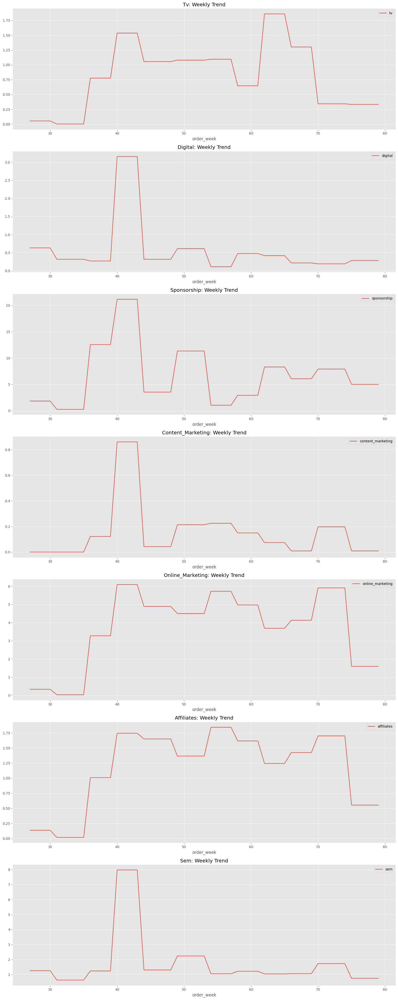

In [121]:
#  Plotting Weekly Trends for All Media Channels
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(16, 40))

channels = ['tv', 'digital', 'sponsorship', 'content_marketing',
             'online_marketing', 'affiliates', 'sem']

for idx, channel in enumerate(channels, start=1):
    ax = fig.add_subplot(len(channels), 1, idx)
    ax.set_title(f'{channel.title()}: Weekly Trend')
    media_investment_weekly.plot(x='order_week', y=[channel], ax=ax)

plt.tight_layout()
plt.show()


# 📌 1. Function to Create Adstock Values

In [122]:
def getAdStockValue(media_df, col_name, adstock_rate):
    # Calculate weekly carryover multipliers directly
    for lag in range(1, 6):
        media_df[f'week_carry_over_{lag}_value'] = adstock_rate ** lag * media_df[col_name]

    # Compute final AdStock values efficiently
    adstock_values = []
    for i in range(len(media_df)):
        carryover = sum(
            media_df.loc[i - j, f"week_carry_over_{j}_value"] if (i - j) >= 0 else 0
            for j in range(1, 6)
        )
        adstock = media_df.loc[i, col_name] + carryover
        adstock_values.append(adstock)

    media_df[f"adStock_{col_name}"] = adstock_values
    return media_df[["order_week", f"adStock_{col_name}"]]


# 📌 2. Generate Adstocks for All Media Channels

In [123]:
#  Corrected List of Media Investment Columns (Matching DataFrame Exactly)
media_channels = [
    'tv', 'digital', 'sponsorship', 'content_marketing',
    'online_marketing', 'affiliates', 'sem', 'radio', 'other'
]

#  Compute Adstock for Each Channel Correctly
adstock_dfs = []
for channel in media_channels:
    cols = [channel, 'order_week']
    adstock_df = getAdStockValue(media_investment_weekly[cols], channel, 0.5)[[f"adStock_{channel}"]]
    adstock_dfs.append(adstock_df)

#  Final Adstock DataFrame
all_adstock = pd.concat(adstock_dfs, axis=1)

#  Preview
display(all_adstock.head())


,adStock_tv,adStock_digital,adStock_sponsorship,adStock_content_marketing,adStock_online_marketing,adStock_affiliates,adStock_sem,adStock_radio,adStock_other
0,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0
1,0.080749,0.949880,2.780351,0.000350,0.497729,0.205220,1.883887,0.0,0.0
2,0.094207,1.108193,3.243743,0.000408,0.580684,0.239424,2.197868,0.0,0.0
3,0.100936,1.187350,3.475439,0.000437,0.622161,0.256525,2.354858,0.0,0.0
4,0.052078,0.913194,2.003552,0.000220,0.343392,0.146684,1.805811,0.0,0.0


# 📌 4. Merge Adstock Data with Media Investment

In [124]:
#  Ensure 'order_week' is included in all_adstock
all_adstock = pd.concat([media_investment_weekly[['order_week']]] + adstock_dfs, axis=1)

#  Now safely merge
final_adstock_data = pd.merge(media_investment_weekly, all_adstock, on="order_week", how="inner")

#  Clean Up: Drop Original Spend Columns If Present (Corrected Names)
cols_to_drop = [
    'total_investment', 'tv', 'digital', 'sponsorship', 'content_marketing',
    'online_marketing', 'affiliates', 'sem', 'radio', 'other'
]

final_adstock_data.drop(
    columns=[col for col in cols_to_drop if col in final_adstock_data.columns],
    inplace=True
)

#  Final Preview
display(final_adstock_data.head())


,order_week,month,year,adStock_tv,adStock_digital,adStock_sponsorship,adStock_content_marketing,adStock_online_marketing,adStock_affiliates,adStock_sem,adStock_radio,adStock_other
0,27,7,2015,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0
1,28,7,2015,0.080749,0.949880,2.780351,0.000350,0.497729,0.205220,1.883887,0.0,0.0
2,29,7,2015,0.094207,1.108193,3.243743,0.000408,0.580684,0.239424,2.197868,0.0,0.0
3,30,7,2015,0.100936,1.187350,3.475439,0.000437,0.622161,0.256525,2.354858,0.0,0.0
4,31,8,2015,0.052078,0.913194,2.003552,0.000220,0.343392,0.146684,1.805811,0.0,0.0


# 📌 5. Visualize Correlations of Final Adstock Data

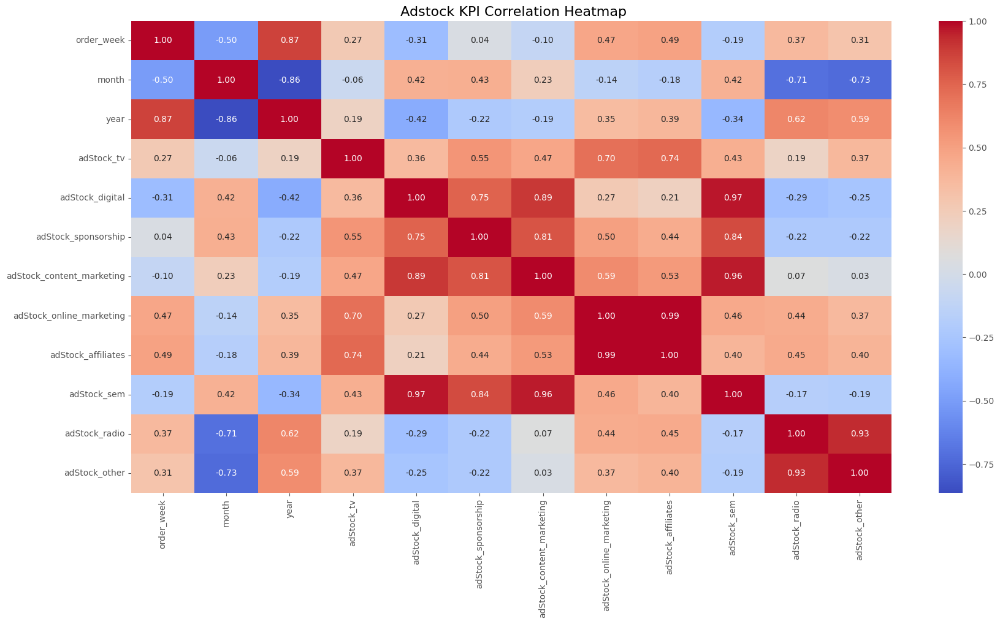

In [125]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(20, 10))
sns.heatmap(final_adstock_data.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title(" Adstock KPI Correlation Heatmap", fontsize=16)
plt.show()


📊 Adstock KPI Correlation Heatmap Insights:
🟢 High Correlations (Potential Multicollinearity Risks):
adStock_digital ↔ adStock_sem → 0.97:

Heavy overlap. Likely that search engine marketing (SEM) and digital campaigns ran in tandem.


adStock_digital ↔ adStock_content_marketing → 0.89:

Content marketing is highly integrated with digital campaigns.

✅ Insight: Digital spend likely includes significant content production/promotion.

adStock_online_marketing ↔ adStock_affiliates → 0.99:

These channels are almost perfectly correlated — possibly tracked under different labels but same activities.

adStock_sponsorship ↔ adStock_content_marketing → 0.81:

Indicates that sponsorship activities often included content elements (events with influencer content, blogs, etc.).

🟡 Moderate Correlations:
adStock_tv ↔ adStock_online_marketing → 0.70:

TV campaigns seem to coincide with digital pushes — a classic "surround-sound" marketing strategy.

✅ Insight: Cross-channel synergy between TV and online channels is actively used.

adStock_radio ↔ adStock_other → 0.93:

Possibly smaller-scale or experimental campaigns grouped under "other" follow similar patterns to radio.


🔴 Low/Negative Correlations:
Month ↔ adStock_online_marketing / adStock_affiliates → Negative Correlation (~ -0.71, -0.73):

Indicates that spend on these channels significantly fluctuated over months, possibly peaking mid-year and dropping off later.

adStock_radio / adStock_other show weak correlation with most other channels (except each other):

Likely isolated or occasional campaigns.

# 📂 Part 1: Merging Final Adstock Data and Preparing Final DataFrames

## ✅ Merging Adstock Data with Final Aggregated DataFrames

In [126]:
# Preparing final_data for all 3 categories by adding adstock data
final_camera_data = pd.merge(final_adstock_data, final_camera_data, on="order_week", how="right")
final_gaming_data = pd.merge(final_adstock_data, final_gaming_data, on="order_week", how="right")
final_home_audio_data = pd.merge(final_adstock_data, final_home_audio_data, on="order_week", how="right")


# ✅ Checking Final Shapes of DataFrames

In [127]:
# Checking the shape of the final dataframes
print("Shape of Gaming Accessory DF:", final_gaming_data.shape)
print("Shape of Camera Accessory DF:", final_camera_data.shape)
print("Shape of Home Audio DF:", final_home_audio_data.shape)


Shape of Gaming Accessory DF: (53, 43)
Shape of Camera Accessory DF: (52, 50)
Shape of Home Audio DF: (50, 38)


# 📂 Part 2: GMV Trends and Orders Trends Over Time
## 📈 GMV vs Week Trend for Each Category

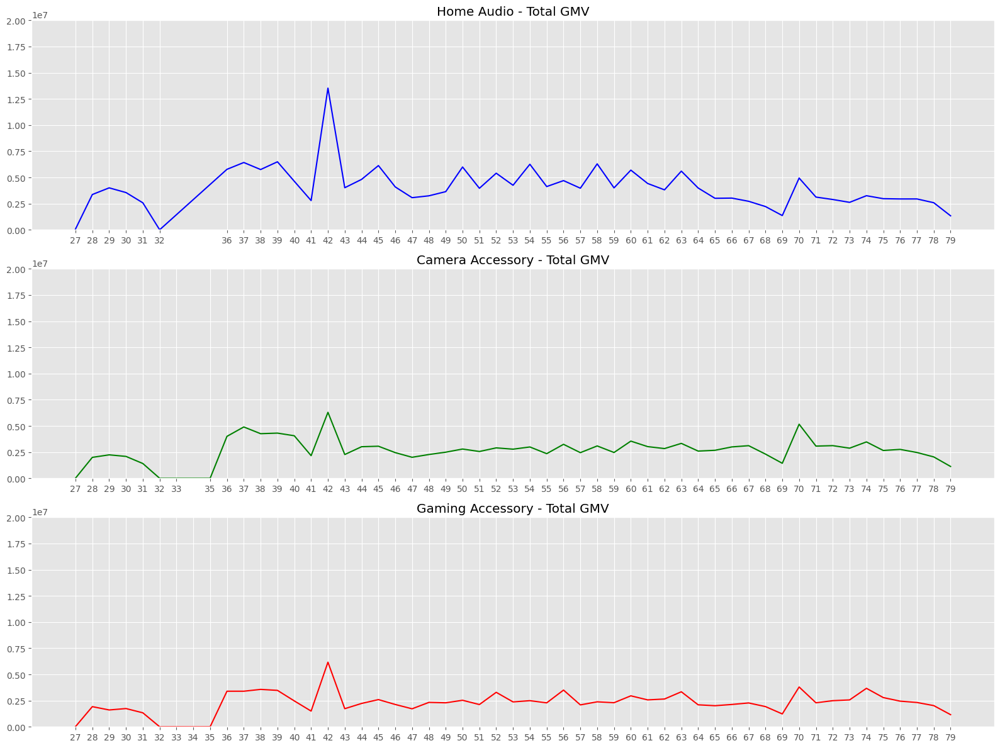

In [128]:
fig, axes = plt.subplots(3, 1, figsize=(16, 12))

# Home Audio
ax1 = plt.subplot(3, 1, 1)
ax1.set_ylim(0, 20000000)
plt.plot(final_home_audio_data['order_week'], final_home_audio_data['gmv'], color='blue')
plt.title('Home Audio - Total GMV')
plt.xticks(final_home_audio_data['order_week'])

# Camera Accessory
ax2 = plt.subplot(3, 1, 2)
ax2.set_ylim(0, 20000000)
plt.plot(final_camera_data['order_week'], final_camera_data['gmv'], color='green')
plt.title('Camera Accessory - Total GMV')
plt.xticks(final_camera_data['order_week'])

# Gaming Accessory
ax3 = plt.subplot(3, 1, 3)
ax3.set_ylim(0, 20000000)
plt.plot(final_gaming_data['order_week'], final_gaming_data['gmv'], color='red')
plt.title('Gaming Accessory - Total GMV')
plt.xticks(final_gaming_data['order_week'])

plt.tight_layout()
plt.show()


🛍️ Week 42 is the Golden Sales Week for All Categories!


# 📈 Number of Orders vs Week for Each Category

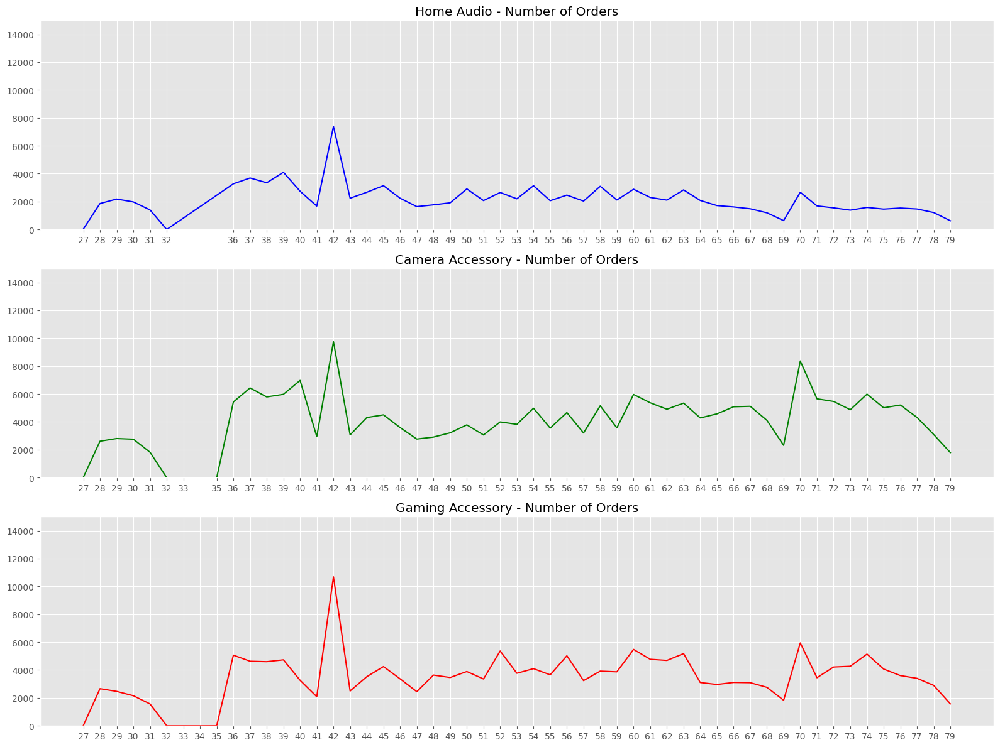

In [129]:
fig, axes = plt.subplots(3, 1, figsize=(16, 12))

# Home Audio
ax1 = plt.subplot(3, 1, 1)
ax1.set_ylim(0, 15000)
plt.plot(final_home_audio_data['order_week'], final_home_audio_data['total_transactions'], color='blue')
plt.title('Home Audio - Number of Orders')
plt.xticks(final_home_audio_data['order_week'])

# Camera Accessory
ax2 = plt.subplot(3, 1, 2)
ax2.set_ylim(0, 15000)
plt.plot(final_camera_data['order_week'], final_camera_data['total_transactions'], color='green')
plt.title('Camera Accessory - Number of Orders')
plt.xticks(final_camera_data['order_week'])

# Gaming Accessory
ax3 = plt.subplot(3, 1, 3)
ax3.set_ylim(0, 15000)
plt.plot(final_gaming_data['order_week'], final_gaming_data['total_transactions'], color='red')
plt.title('Gaming Accessory - Number of Orders')
plt.xticks(final_gaming_data['order_week'])

plt.tight_layout()
plt.show()


📅 Week 42 is the Mega Shopping Week for all categories—align heavy campaigns, influencer promotions, and discounts accordingly.

🎧 Home Audio: Treat this as a premium event-driven category; invest marketing budget mostly around mega sale events.

📷 Camera Accessories: Maintain some ongoing engagement year-round but scale heavily during sales. Influencer collabs could help boost off-sale weeks.

🎮 Gaming Accessories: Consider ongoing promotions or loyalty programs. Gamers have regular purchasing habits and are more engaged throughout the year.

# 🎉 Holiday Week vs Average GMV

In [130]:
Holiday_week_sale_HA = final_home_audio_data.groupby('is_holiday')[['gmv']].mean().reset_index()
Holiday_week_sale_CA = final_camera_data.groupby('is_holiday')[['gmv']].mean().reset_index()
Holiday_week_sale_GA = final_gaming_data.groupby('is_holiday')[['gmv']].mean().reset_index()


# 📊 Bar Plot: Holiday Week vs Average GMV

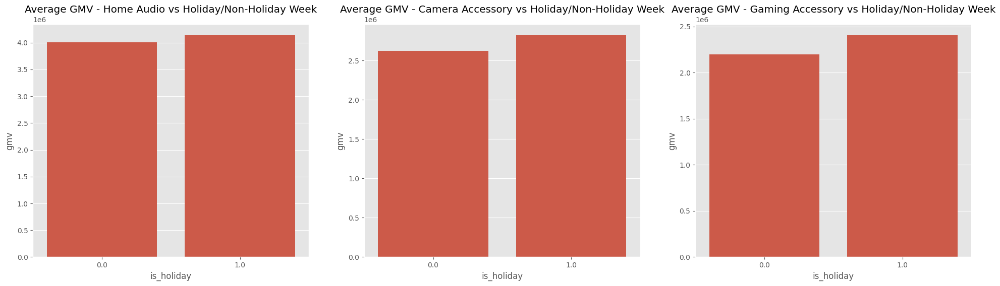

In [131]:
plt.figure(figsize=(24, 6))

# Home Audio
plt.subplot(1, 3, 1)
sns.barplot(x='is_holiday', y='gmv', data=Holiday_week_sale_HA)
plt.title("Average GMV - Home Audio vs Holiday/Non-Holiday Week")

# Camera Accessory
plt.subplot(1, 3, 2)
sns.barplot(x='is_holiday', y='gmv', data=Holiday_week_sale_CA)
plt.title("Average GMV - Camera Accessory vs Holiday/Non-Holiday Week")

# Gaming Accessory
plt.subplot(1, 3, 3)
sns.barplot(x='is_holiday', y='gmv', data=Holiday_week_sale_GA)
plt.title("Average GMV - Gaming Accessory vs Holiday/Non-Holiday Week")

plt.show()


 Home Audio: Moderate holiday impact → Prioritize festival campaigns but maintain off-season pushes.

Camera Accessories: Strong holiday pull → Focus marketing spend around holidays and gifting periods.

Gaming Accessories: Highly holiday-sensitive → Go all-in with discounts, bundles, and influencer marketing near holidays.

# 🛒 Special Sale Week vs Average GMV

In [132]:
Special_week_sale_HA = final_home_audio_data.groupby('is_special_sale_day')[['gmv']].mean().reset_index()
Special_week_sale_CA = final_camera_data.groupby('is_special_sale_day')[['gmv']].mean().reset_index()
Special_week_sale_GA = final_gaming_data.groupby('is_special_sale_day')[['gmv']].mean().reset_index()


# 📊 Bar Plot: Special Sale Week vs Average GMV

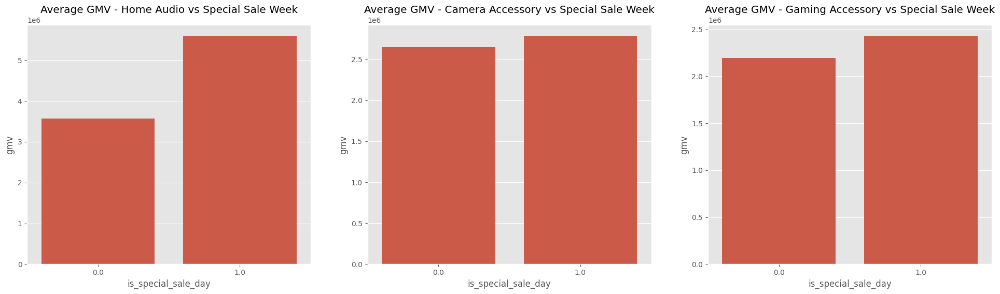

In [133]:
plt.figure(figsize=(24, 6))

plt.subplot(1, 3, 1)
sns.barplot(x='is_special_sale_day', y='gmv', data=Special_week_sale_HA)
plt.title("Average GMV - Home Audio vs Special Sale Week")

plt.subplot(1, 3, 2)
sns.barplot(x='is_special_sale_day', y='gmv', data=Special_week_sale_CA)
plt.title("Average GMV - Camera Accessory vs Special Sale Week")

plt.subplot(1, 3, 3)
sns.barplot(x='is_special_sale_day', y='gmv', data=Special_week_sale_GA)
plt.title("Average GMV - Gaming Accessory vs Special Sale Week")

plt.show()


 📢 Home Audio: Highly responsive to special sales — big GMV spikes. Maximize promotions here.

📢 Camera Accessories: Barely impacted by sales. Focus on regular demand, not sales events.

📢 Gaming Accessories: Moderate lift during sales. Use targeted offers and exclusive bundles.

# 💰 Pay Day Week vs Total GMV

In [134]:
PayDay_week_sale_HA = final_home_audio_data.groupby('is_pay_day')[['gmv']].sum().reset_index()
PayDay_week_sale_CA = final_camera_data.groupby('is_pay_day')[['gmv']].sum().reset_index()
PayDay_week_sale_GA = final_gaming_data.groupby('is_pay_day')[['gmv']].sum().reset_index()


# 📊 Bar Plot: Pay Day Week vs Total GMV

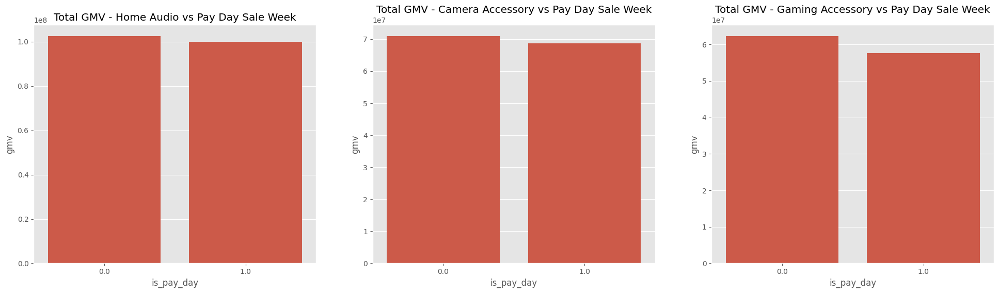

In [135]:
plt.figure(figsize=(24, 6))

plt.subplot(1, 3, 1)
sns.barplot(x='is_pay_day', y='gmv', data=PayDay_week_sale_HA)
plt.title("Total GMV - Home Audio vs Pay Day Sale Week")

plt.subplot(1, 3, 2)
sns.barplot(x='is_pay_day', y='gmv', data=PayDay_week_sale_CA)
plt.title("Total GMV - Camera Accessory vs Pay Day Sale Week")

plt.subplot(1, 3, 3)
sns.barplot(x='is_pay_day', y='gmv', data=PayDay_week_sale_GA)
plt.title("Total GMV - Gaming Accessory vs Pay Day Sale Week")

plt.show()


 Pay Day Impact is Minimal Across All Categories.

Home Audio shows no change, Camera and Gaming Accessories even dip slightly.

# 📂 Part 4: NPS and GMV Relationship Analysis

## 📈 Scatter Plot: NPS vs GMV

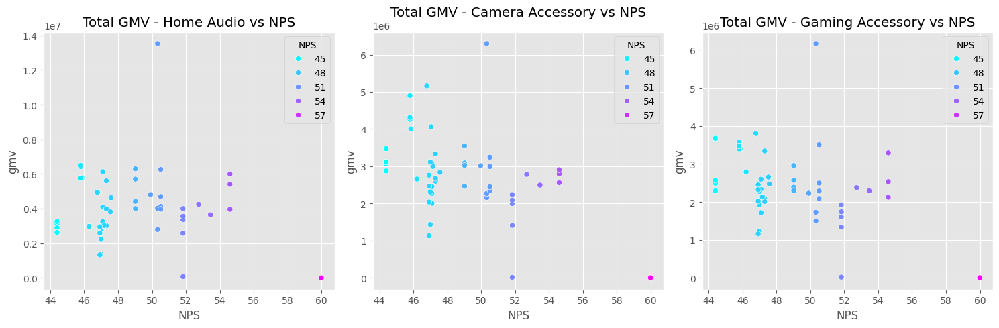

In [136]:
plt.figure(figsize=(15, 5))

# Home Audio
plt.subplot(1, 3, 1)
sns.scatterplot(x='NPS', y='gmv', data=final_home_audio_data, hue='NPS', palette="cool")
plt.title("Total GMV - Home Audio vs NPS")

# Camera Accessory
plt.subplot(1, 3, 2)
sns.scatterplot(x='NPS', y='gmv', data=final_camera_data, hue='NPS', palette="cool")
plt.title("Total GMV - Camera Accessory vs NPS")

# Gaming Accessory
plt.subplot(1, 3, 3)
sns.scatterplot(x='NPS', y='gmv', data=final_gaming_data, hue='NPS', palette="cool")
plt.title("Total GMV - Gaming Accessory vs NPS")

plt.tight_layout()
plt.show()


📈 Observation: NPS Does Not Strongly Correlate with GMV

Across Home Audio, Camera, and Gaming Accessories:

High NPS doesn't consistently drive higher GMV.

GMV is scattered even at lower NPS scores.

# 📉 Regression Plot: NPS vs GMV

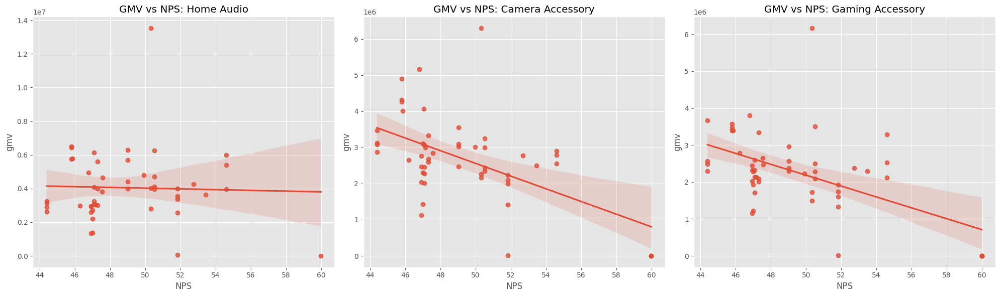

In [137]:
fig = plt.figure(figsize=(20, 6))

# Home Audio Regression
ax1 = fig.add_subplot(1, 3, 1)
sns.regplot(x='NPS', y='gmv', data=final_home_audio_data, ax=ax1)
ax1.set_title('GMV vs NPS: Home Audio')

# Camera Accessory Regression
ax2 = fig.add_subplot(1, 3, 2)
sns.regplot(x='NPS', y='gmv', data=final_camera_data, ax=ax2)
ax2.set_title('GMV vs NPS: Camera Accessory')

# Gaming Accessory Regression
ax3 = fig.add_subplot(1, 3, 3)
sns.regplot(x='NPS', y='gmv', data=final_gaming_data, ax=ax3)
ax3.set_title('GMV vs NPS: Gaming Accessory')

plt.tight_layout()
plt.show()


📊 Home Audio: Flat trend — NPS has negligible impact on GMV. Other factors drive sales more here.

📷 Camera Accessory: Negative correlation — As NPS increases, GMV slightly declines. High satisfaction isn't converting into purchases.

🎮 Gaming Accessory: Also shows negative correlation — Loyalty scores rise, but buying behavior doesn’t follow.

In [138]:
# Display Banner for DATA #2
print_banner("DATA # 4 & 5", "Weather data")

**************************************************************************
*     ____  ___  _________         __ __     __ __     ___        ______ *
*    / __ \/   |/_  __/   |     __/ // /_   / // /    ( _ )      / ____/ *
*   / / / / /| | / / / /| |    /_  _  __/  / // /_   / __ \/|   /___ \   *
*  / /_/ / ___ |/ / / ___ |   /_  _  __/  /__  __/  / /_/  <   ____/ /   *
* /_____/_/  |_/_/ /_/  |_|    /_//_/       /_/     \____/\/  /_____/    *
*                                                                        *
*                                                                        *
**************************************************************************

     * Weather data



In [139]:
import pandas as pd

#  Load Climate Data for 2015 and 2016, skipping metadata rows (header=24 means start reading from row 25)
climate_2015 = pd.read_excel('ONTARIO-2015.xlsx', header=24)
climate_2016 = pd.read_excel('ONTARIO-2016.xlsx', header=24)

#  Drop Columns with All Null Values
climate_2015.dropna(axis=1, how='all', inplace=True)
climate_2016.dropna(axis=1, how='all', inplace=True)

#  Reset Index after Cleaning
climate_2015.reset_index(drop=True, inplace=True)
climate_2016.reset_index(drop=True, inplace=True)

#  Drop Columns with Only One Distinct Value (Usually Flags and Data Quality)
def drop_flag_columns(df):
    drop_cols = [col for col in df.columns if 'Flag' in col or col == 'Data Quality']
    df.drop(columns=drop_cols, inplace=True, errors='ignore')
    return df

climate_2015 = drop_flag_columns(climate_2015)
climate_2016 = drop_flag_columns(climate_2016)

#  Clean Column Names by Removing Units and Extra Spaces
climate_2015.columns = [col.replace(' (°C)', '').strip() for col in climate_2015.columns]
climate_2016.columns = [col.replace(' (°C)', '').strip() for col in climate_2016.columns]

#  Drop Rows Where 'Mean Temp' and 'Total Rain (mm)' are Both Null
required_cols = ['Mean Temp', 'Total Rain (mm)']
climate_2015.dropna(subset=required_cols, inplace=True)
climate_2016.dropna(subset=required_cols, inplace=True)

#  Reset Index After Dropping Nulls
climate_2015.reset_index(drop=True, inplace=True)
climate_2016.reset_index(drop=True, inplace=True)

#  Final Data Overview
print("\n Climate 2015 Data Info:")
climate_2015.info()
print("\n Climate 2016 Data Info:")
climate_2016.info()

#  Preview Cleaned Data
print("\n Climate 2015 Sample:")
display(climate_2015.head())

print("\n Climate 2016 Sample:")
display(climate_2016.head())



 Climate 2015 Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 190 entries, 0 to 189
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Date/Time          190 non-null    datetime64[ns]
 1   Year               190 non-null    int64         
 2   Month              190 non-null    int64         
 3   Day                190 non-null    int64         
 4   Max Temp           190 non-null    float64       
 5   Min Temp           190 non-null    float64       
 6   Mean Temp          190 non-null    float64       
 7   Heat Deg Days      190 non-null    float64       
 8   Cool Deg Days      190 non-null    float64       
 9   Total Rain (mm)    190 non-null    float64       
 10  Total Snow (cm)    190 non-null    float64       
 11  Total Precip (mm)  190 non-null    float64       
 12  Snow on Grnd (cm)  190 non-null    float64       
dtypes: datetime64[ns](1), float64(9), int64

,Date/Time,Year,Month,Day,Max Temp,Min Temp,Mean Temp,Heat Deg Days,Cool Deg Days,Total Rain (mm),Total Snow (cm),Total Precip (mm),Snow on Grnd (cm)
0,2015-01-01,2015,1,1,0.0,-8.5,-4.3,22.3,0.0,0.0,0.0,0.0,0.0
1,2015-01-02,2015,1,2,3.0,-3.0,0.0,18.0,0.0,0.0,0.0,0.0,0.0
2,2015-01-03,2015,1,3,2.5,-4.0,-0.8,18.8,0.0,24.0,0.0,24.0,0.0
3,2015-01-04,2015,1,4,2.5,0.0,1.3,16.7,0.0,0.0,1.0,1.0,0.0
4,2015-01-05,2015,1,5,-10.0,-13.5,-11.8,29.8,0.0,0.0,3.0,3.0,1.0



 Climate 2016 Sample:


,Date/Time,Year,Month,Day,Max Temp,Min Temp,Mean Temp,Heat Deg Days,Cool Deg Days,Total Rain (mm),Total Snow (cm),Total Precip (mm),Snow on Grnd (cm)
0,2016-01-08,2016,1,8,7.0,-14.0,-3.5,21.5,0.0,9.0,0.0,9.0,0.0
1,2016-01-09,2016,1,9,11.0,3.0,7.0,11.0,0.0,14.6,0.0,14.6,0.0
2,2016-01-10,2016,1,10,-1.5,-5.0,-3.3,21.3,0.0,0.0,7.0,7.0,0.0
3,2016-01-12,2016,1,12,-5.0,-12.0,-8.5,26.5,0.0,0.0,0.0,0.0,12.0
4,2016-01-14,2016,1,14,2.5,-10.5,-4.0,22.0,0.0,0.0,0.0,0.0,11.0


In [140]:
#  Extracting 'order_week' from Date/Time for 2015
climate_2015['order_week'] = climate_2015['Date/Time'].dt.strftime("%V").astype(int)

#  Extracting 'order_week' from Date/Time for 2016
climate_2016['order_week'] = climate_2016['Date/Time'].dt.strftime("%V").astype(int)


In [141]:
#  Custom Week Mapping Function (Define this if not already done)
def mapWeek(order_week, year):
    # Adjust week mapping based on custom logic if needed
    return order_week

#  Apply Week Mapping for 2016
climate_2016['order_week'] = climate_2016.apply(lambda x: mapWeek(x['order_week'], x['Year']), axis=1)


In [142]:
#  Filter Data: July to December for 2015
climate_2015 = climate_2015[climate_2015['Month'] >= 7].reset_index(drop=True)

#  Filter Data: January to June for 2016
climate_2016 = climate_2016[climate_2016['Month'] <= 6].reset_index(drop=True)


In [143]:
#  Sort by Week
climate_2015.sort_values(by='order_week', inplace=True)
climate_2016.sort_values(by='order_week', inplace=True)


In [144]:
climate_2016.head()

,Date/Time,Year,Month,Day,Max Temp,Min Temp,Mean Temp,Heat Deg Days,Cool Deg Days,Total Rain (mm),Total Snow (cm),Total Precip (mm),Snow on Grnd (cm),order_week
0,2016-01-08,2016,1,8,7.0,-14.0,-3.5,21.5,0.0,9.0,0.0,9.0,0.0,1
1,2016-01-09,2016,1,9,11.0,3.0,7.0,11.0,0.0,14.6,0.0,14.6,0.0,1
2,2016-01-10,2016,1,10,-1.5,-5.0,-3.3,21.3,0.0,0.0,7.0,7.0,0.0,1
3,2016-01-12,2016,1,12,-5.0,-12.0,-8.5,26.5,0.0,0.0,0.0,0.0,12.0,2
4,2016-01-14,2016,1,14,2.5,-10.5,-4.0,22.0,0.0,0.0,0.0,0.0,11.0,2


In [145]:
climate_2015.head()

,Date/Time,Year,Month,Day,Max Temp,Min Temp,Mean Temp,Heat Deg Days,Cool Deg Days,Total Rain (mm),Total Snow (cm),Total Precip (mm),Snow on Grnd (cm),order_week
0,2015-07-01,2015,7,1,24.5,17.0,20.8,0.0,2.8,0.0,0.0,0.0,0.0,27
1,2015-07-02,2015,7,2,24.0,14.0,19.0,0.0,1.0,0.0,0.0,0.0,0.0,27
2,2015-07-03,2015,7,3,25.0,10.0,17.5,0.5,0.0,0.0,0.0,0.0,0.0,27
3,2015-07-04,2015,7,4,26.0,11.0,18.5,0.0,0.5,0.0,0.0,0.0,0.0,27
4,2015-07-05,2015,7,5,28.0,14.0,21.0,0.0,3.0,0.0,0.0,0.0,0.0,27


In [146]:
#  Aggregate Weekly Climate Data
agg_cols = {
    'Max Temp': 'max',
    'Min Temp': 'min',
    'Mean Temp': 'mean',
    'Heat Deg Days': 'mean',
    'Cool Deg Days': 'mean',
    'Total Rain (mm)': 'mean',
    'Total Snow (cm)': 'mean',
    'Total Precip (mm)': 'mean',
    'Snow on Grnd (cm)': 'mean'
}

climate_2015_weekly = climate_2015.groupby('order_week').agg(agg_cols).reset_index()
climate_2016_weekly = climate_2016.groupby('order_week').agg(agg_cols).reset_index()


In [147]:
#  Final Climate Dataset
climate = pd.concat([climate_2015_weekly, climate_2016_weekly], axis=0).reset_index(drop=True)

#  Drop Unnecessary Columns
climate_data = climate.drop(columns=[
    'Max Temp', 'Min Temp', 'Heat Deg Days', 'Cool Deg Days',
    'Total Snow (cm)', 'Total Precip (mm)', 'Snow on Grnd (cm)'
])

#  Final Climate Data Preview
display(climate_data.head())


,order_week,Mean Temp,Total Rain (mm)
0,27,19.360000,0.000000
1,28,20.100000,4.416667
2,29,23.183333,1.400000
3,30,23.060000,1.080000
4,31,24.566667,4.633333


In [148]:
#  Merge with Final KPI Data
final_camera_data_climate = pd.merge(final_camera_data, climate_data, on="order_week", how="inner")
final_gaming_data_climate = pd.merge(final_gaming_data, climate_data, on="order_week", how="inner")
final_home_audio_data_climate = pd.merge(final_home_audio_data, climate_data, on="order_week", how="inner")

#  Final Shapes Check
print(f" Camera Data Shape: {final_camera_data_climate.shape}")
print(f" Gaming Data Shape: {final_gaming_data_climate.shape}")
print(f" Home Audio Data Shape: {final_home_audio_data_climate.shape}")

 Camera Data Shape: (26, 52)
 Gaming Data Shape: (27, 45)
 Home Audio Data Shape: (24, 40)


In [149]:
final_camera_data.to_csv('final_camera_data.csv', index=False)
final_gaming_data.to_csv('final_gaming_data.csv', index=False)
final_home_audio_data.to_csv('final_home_audio_data.csv', index=False)

print(" All files exported successfully!")


 All files exported successfully!


# We're not including the climate data for modelling as its not a factor that can be controlled by the company.

# Data Modelling
## **Function to calculate elasticity of the required KPIs**

In [150]:
def calculateElasticity(df_train, gmv, coefficient_df):
    elasticity = []
    gmv_mean = gmv.mean()  # Pre-calculate GMV mean for efficiency

    for feature in coefficient_df['feature']:
        if feature in df_train.columns:
            feature_mean = df_train[feature].mean()

            #  Ensure we're retrieving a scalar, not a Series
            coefficient_series = coefficient_df.loc[coefficient_df['feature'] == feature, 'coefficient']
            coefficient = coefficient_series.values[0] if not coefficient_series.empty else 0

            elasticity_value = (coefficient * feature_mean) / gmv_mean
        else:
            elasticity_value = 0  # Feature missing safely assign 0

        elasticity.append(elasticity_value)

    coefficient_df['elasticity'] = pd.Series(elasticity).round(4)
    return coefficient_df


## Building the Basic Linear Models

#### I. Camera Accessory - Basic Linear Model

In [151]:
# taking the final camera accessory data for basic linear mode
final_camera_data.head()

,order_week,month,year,adStock_tv,adStock_digital,adStock_sponsorship,adStock_content_marketing,adStock_online_marketing,adStock_affiliates,adStock_sem,adStock_radio,adStock_other,gmv,units,sla,product_procurement_sla,product_mrp,selling_price,discount,NPS,total_transactions,total_premiumness,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day,Binoculars,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,ExtensionTube,Filter,Flash,FlashShoeAdapter,Lens,ReflectorUmbrella,Softbox,Strap,Telescope
0,27,7,2015,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0,15375.0,25,2.280000,2.960000,1456.840000,615.000000,0.525600,51.827605,25,25,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,2.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,13.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0
1,28,7,2015,0.080749,0.949880,2.780351,0.000350,0.497729,0.205220,1.883887,0.0,0.0,1998494.0,2735,7.154612,2.740145,1649.275928,748.257176,0.465201,51.827605,2613,2613,0.0,0.0,0.0,0.0,0.0,0.0,193.0,45.0,322.0,731.0,223.0,11.0,0.0,0.0,0.0,0.0,4.0,141.0,432.0,0.0,226.0,17.0,0.0,362.0,0.0,0.0,12.0,16.0
2,29,7,2015,0.094207,1.108193,3.243743,0.000408,0.580684,0.239424,2.197868,0.0,0.0,2238795.0,2901,6.498041,2.763449,1636.509797,784.252227,0.468001,51.827605,2807,2807,0.0,0.0,2.0,1.0,1.0,1.0,247.0,30.0,345.0,766.0,227.0,5.0,0.0,0.0,0.0,0.0,11.0,144.0,491.0,0.0,188.0,23.0,0.0,380.0,0.0,0.0,22.0,22.0
3,30,7,2015,0.100936,1.187350,3.475439,0.000437,0.622161,0.256525,2.354858,0.0,0.0,2089092.0,2863,6.491114,2.831701,1568.573449,741.568009,0.460047,51.827605,2757,2757,0.0,0.0,0.0,0.0,0.0,0.0,209.0,43.0,277.0,805.0,270.0,9.0,0.0,0.0,0.0,0.0,7.0,108.0,456.0,0.0,194.0,18.0,0.0,420.0,0.0,0.0,17.0,30.0
4,31,8,2015,0.052078,0.913194,2.003552,0.000220,0.343392,0.146684,1.805811,0.0,0.0,1411234.0,1912,6.483535,2.776619,1532.785950,756.950055,0.455401,51.836562,1822,1822,0.0,0.0,0.0,0.0,1.0,1.0,144.0,41.0,173.0,505.0,194.0,8.0,0.0,0.0,0.0,0.0,2.0,81.0,362.0,0.0,112.0,26.0,0.0,233.0,0.0,0.0,18.0,13.0


#### Let's drop the columns which cannot be controlled by the company

In [152]:
# dropping the uncontrolable factors=
df = final_camera_data.drop(['selling_price','units','product_mrp','total_transactions'], axis = 1)

In [153]:
# checking the number of columns in the dataset
len(df.columns)

46

In [154]:
# printing the columns
df.columns

Index(['order_week', 'month', 'year', 'adStock_tv', 'adStock_digital',
       'adStock_sponsorship', 'adStock_content_marketing',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'gmv', 'sla',
       'product_procurement_sla', 'discount', 'NPS', 'total_premiumness',
       'total_holidays', 'is_holiday', 'total_special_sale_days',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'Binoculars',
       'CameraAccessory', 'CameraBag', 'CameraBattery', 'CameraBatteryCharger',
       'CameraBatteryGrip', 'CameraEyeCup', 'CameraFilmRolls', 'CameraHousing',
       'CameraMicrophone', 'CameraMount', 'CameraRemoteControl',
       'CameraTripod', 'ExtensionTube', 'Filter', 'Flash', 'FlashShoeAdapter',
       'Lens', 'ReflectorUmbrella', 'Softbox', 'Strap', 'Telescope'],
      dtype='object')

In [155]:
# splitting the data into test and train set
np.random.seed(0)
df_train, df_test = train_test_split(df, train_size = 0.8, test_size = 0.2, random_state = 100)

In [156]:
scaler = MinMaxScaler()

In [157]:
#  Correct Feature Columns for Scaling
num_vars = [
    'adStock_tv', 'adStock_digital', 'adStock_sponsorship', 'adStock_content_marketing',
    'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem', 'adStock_radio',
    'adStock_other', 'gmv', 'sla', 'product_procurement_sla', 'discount', 'NPS',
    'total_holidays', 'total_special_sale_days', 'total_pay_days',
    'Binoculars', 'CameraAccessory', 'CameraBag', 'CameraBattery',
    'CameraBatteryCharger', 'CameraBatteryGrip', 'CameraEyeCup',
    'CameraFilmRolls', 'CameraHousing', 'CameraMicrophone', 'CameraMount',
    'CameraRemoteControl', 'CameraTripod', 'ExtensionTube', 'Filter', 'Flash',
    'FlashShoeAdapter', 'Lens', 'ReflectorUmbrella', 'Softbox', 'Strap', 'Telescope'
]

#  Apply MinMax Scaling
df_train[num_vars] = scaler.fit_transform(df_train[num_vars])
df_test[num_vars] = scaler.transform(df_test[num_vars])  # Note: Use transform, NOT fit_transform here


In [158]:
# assigning the x_train and y_train values
y_train = df_train.pop('gmv')
X_train = df_train

In [159]:
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE

#  Initialize Linear Regression Model
lm = LinearRegression()

#  Fit the model on training data
lm.fit(X_train, y_train)

#  Apply RFE to select top 20 features
rfe = RFE(estimator=lm, n_features_to_select=20)
rfe = rfe.fit(X_train, y_train)

#  Extract the selected top 20 features
selected_features = X_train.columns[rfe.support_].tolist()

print(" Selected Top 20 Features:")
print(selected_features)


 Selected Top 20 Features:
['adStock_tv', 'adStock_digital', 'adStock_sponsorship', 'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem', 'adStock_radio', 'adStock_other', 'sla', 'discount', 'NPS', 'Binoculars', 'CameraAccessory', 'CameraBag', 'CameraBattery', 'CameraRemoteControl', 'CameraTripod', 'Flash', 'ReflectorUmbrella', 'Strap']


In [160]:
# selecting  the top 20 features selected by rfe
col = X_train.columns[rfe.support_]
col

Index(['adStock_tv', 'adStock_digital', 'adStock_sponsorship',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'sla', 'discount', 'NPS',
       'Binoculars', 'CameraAccessory', 'CameraBag', 'CameraBattery',
       'CameraRemoteControl', 'CameraTripod', 'Flash', 'ReflectorUmbrella',
       'Strap'],
      dtype='object')

In [161]:
#checking  the features which are not included in the top 20
X_train.columns[~rfe.support_]

Index(['order_week', 'month', 'year', 'adStock_content_marketing',
       'product_procurement_sla', 'total_premiumness', 'total_holidays',
       'is_holiday', 'total_special_sale_days', 'is_special_sale_day',
       'total_pay_days', 'is_pay_day', 'CameraBatteryCharger',
       'CameraBatteryGrip', 'CameraEyeCup', 'CameraFilmRolls', 'CameraHousing',
       'CameraMicrophone', 'CameraMount', 'ExtensionTube', 'Filter',
       'FlashShoeAdapter', 'Lens', 'Softbox', 'Telescope'],
      dtype='object')

In [162]:
# Creating X_test dataframe with RFE selected variables
X_train_rfe = X_train[col]

# Base Model

In [163]:
 # Add a constant
X_train_lm = sm.add_constant(X_train_rfe)
# Create a first fitted model
lr = sm.OLS(y_train, X_train_lm).fit()

lr.params
print(lr.summary())
vif = pd.DataFrame()
vif['Features'] = X_train_lm .columns
vif['VIF'] = [variance_inflation_factor(X_train_lm .values, i) for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                     659.9
Date:                Tue, 27 May 2025   Prob (F-statistic):           5.74e-24
Time:                        17:25:18   Log-Likelihood:                 144.36
No. Observations:                  41   AIC:                            -246.7
Df Residuals:                      20   BIC:                            -210.7
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
6,adStock_sem,3857.01
2,adStock_digital,2627.80
4,adStock_online_marketing,2322.50
5,adStock_affiliates,2296.69
7,adStock_radio,1208.74
8,adStock_other,1144.42
0,const,291.15
1,adStock_tv,156.55
3,adStock_sponsorship,109.23
10,discount,27.67


# Model zero

In [164]:
# Remove 'adStock_radio' as per your note
X_train_new0 = X_train_rfe.drop(["adStock_radio"], axis=1)

# Add constant and fit the model
X_train_lm0 = sm.add_constant(X_train_new0)
lr0 = sm.OLS(y_train, X_train_lm0).fit()

# Model Summary and VIF
print(lr0.summary())

vif0 = pd.DataFrame()
vif0['Features'] = X_train_lm0.columns
vif0['VIF'] = [variance_inflation_factor(X_train_lm0.values, i) for i in range(X_train_lm0.shape[1])]
vif0['VIF'] = round(vif0['VIF'], 2)
vif0 = vif0.sort_values(by="VIF", ascending=False)
display(vif0)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                     690.0
Date:                Tue, 27 May 2025   Prob (F-statistic):           3.70e-25
Time:                        17:25:18   Log-Likelihood:                 143.22
No. Observations:                  41   AIC:                            -246.4
Df Residuals:                      21   BIC:                            -212.2
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
4,adStock_online_marketing,2195.24
5,adStock_affiliates,2194.64
6,adStock_sem,691.51
2,adStock_digital,426.80
0,const,218.72
3,adStock_sponsorship,81.10
1,adStock_tv,68.26
9,discount,19.27
13,CameraBag,15.97
15,CameraRemoteControl,15.31


# Model 1

In [165]:
# Removing the feature with highest VIF or high p-value from Model 0
X_train_new1 = X_train_new0.drop(["CameraAccessory"], axis=1)  # Start from Model 0's data

# Add constant for intercept
X_train_lm1 = sm.add_constant(X_train_new1)

# Fit Model 1
lr1 = sm.OLS(y_train, X_train_lm1).fit()

# Model 1 Summary and VIF
print(lr1.summary())

vif1 = pd.DataFrame()
vif1['Features'] = X_train_lm1.columns
vif1['VIF'] = [variance_inflation_factor(X_train_lm1.values, i) for i in range(X_train_lm1.shape[1])]
vif1['VIF'] = round(vif1['VIF'], 2)
vif1 = vif1.sort_values(by="VIF", ascending=False)
display(vif1)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                     716.4
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.61e-26
Time:                        17:25:18   Log-Likelihood:                 141.93
No. Observations:                  41   AIC:                            -245.9
Df Residuals:                      22   BIC:                            -213.3
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
4,adStock_online_marketing,1847.22
5,adStock_affiliates,1762.25
6,adStock_sem,645.77
2,adStock_digital,404.43
0,const,216.48
3,adStock_sponsorship,47.24
1,adStock_tv,43.00
9,discount,19.19
12,CameraBag,15.95
13,CameraBattery,14.58


# R² Comparison Using Cross-Validation:

In [166]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
import statsmodels.api as sm
import pandas as pd

# Initialize Linear Regression
lm = LinearRegression()

# Model Feature Sets
model_feature_sets = {
    "Model_Base": X_train_lm,        # RFE Selected Features + Constant
    "Model_0": sm.add_constant(X_train_new0),    # After removing 'adStock_radio'
    "Model_1": sm.add_constant(X_train_new1),   # After removing 'CameraAccessory'
}

print("\n --- R² Scores (5-Fold Cross-Validation) ---")
for model_name, X_lm in model_feature_sets.items():
    # Prepare Test Data: Drop constant column and match the features
    x_test = df[X_lm.drop('const', axis=1).columns]
    x_test = sm.add_constant(x_test)
    y_test = df['gmv']

    # Cross-Validation R² Scores
    scores = cross_val_score(lm, x_test, y_test, scoring='r2', cv=5)
    print(f"{model_name}: Mean R² Score = {scores.mean():.4f}")



 --- R² Scores (5-Fold Cross-Validation) ---
Model_Base: Mean R² Score = -0.2514
Model_0: Mean R² Score = 0.5819
Model_1: Mean R² Score = 0.4385


# ✅ Block 2: K-Fold CV for Mean Squared Error (Using 10-Fold CV)

In [167]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
import statsmodels.api as sm
import pandas as pd

# Initialize Linear Regression Model
lm = LinearRegression()

# Model Feature Sets for Evaluation
model_feature_sets = {
    "Model_Base": X_train_lm,        # RFE Selected Features + Constant
    "Model_0": sm.add_constant(X_train_new0),    # After removing 'adStock_radio'
    "Model_1": sm.add_constant(X_train_new1),   # After removing 'CameraAccessory'
}

print("\n --- Mean Squared Error (10-Fold Cross-Validation) ---")
for model_name, X_lm in model_feature_sets.items():
    # Prepare Matching Test Data (Drop constant and match columns)
    x_test = df[X_lm.drop('const', axis=1).columns]
    x_test = sm.add_constant(x_test)
    y_test = df['gmv']

    # Compute MSE Scores (neg_mean_squared_error returns negative, so take -mean)
    scores = cross_val_score(lm, x_test, y_test, scoring='neg_mean_squared_error', cv=10)
    mean_mse = -scores.mean()
    print(f"{model_name}: Mean MSE = {mean_mse:.4f}")



 --- Mean Squared Error (10-Fold Cross-Validation) ---
Model_Base: Mean MSE = 65698019134.5467
Model_0: Mean MSE = 163905691467.2957
Model_1: Mean MSE = 169502847205.7226


# selcting model zero as the final best model

# Residual Analysis



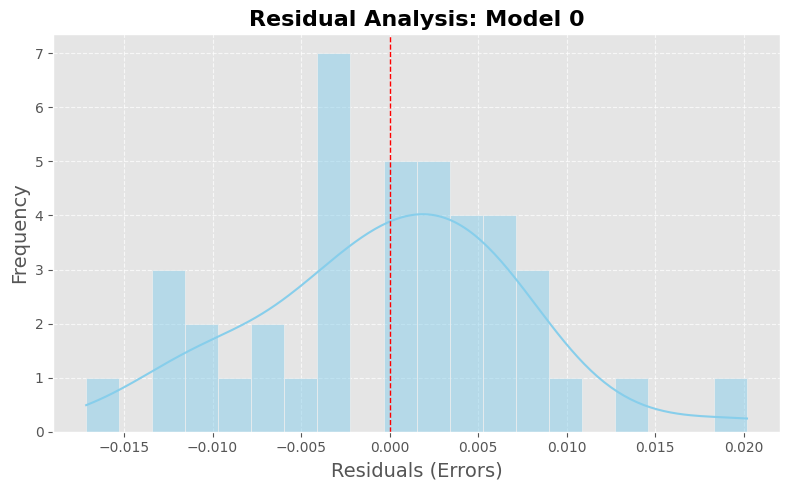

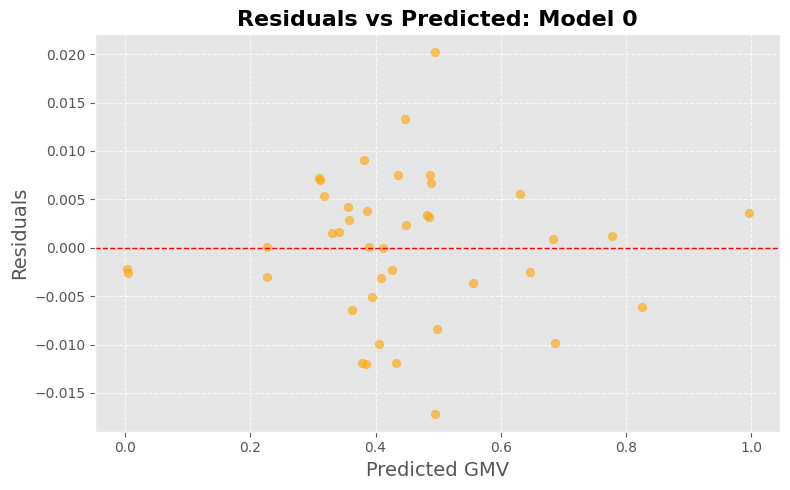

In [168]:
# Predict on Training Set
y_train_pred0 = lr0.predict(X_train_lm0)

# Residuals
residuals0 = y_train - y_train_pred0

#  Plotting Residuals Distribution
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8, 5))
sns.histplot(residuals0, bins=20, kde=True, color='skyblue')
plt.title('Residual Analysis: Model 0', fontsize=16, weight='bold')
plt.xlabel('Residuals (Errors)', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.axvline(0, color='red', linestyle='--', linewidth=1)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

#  Residuals vs Predicted Plot (Should have no clear pattern)
plt.figure(figsize=(8, 5))
plt.scatter(y_train_pred0, residuals0, color='orange', alpha=0.6)
plt.axhline(0, color='red', linestyle='--', linewidth=1)
plt.title('Residuals vs Predicted: Model 0', fontsize=16, weight='bold')
plt.xlabel('Predicted GMV', fontsize=14)
plt.ylabel('Residuals', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


# Based upon the above adjusted r-squared from cross-validation & MSE, the model 0 seems the best model.

 Model_0 Test R² Score: 0.681
 Model_0 Test RMSE: 0.11


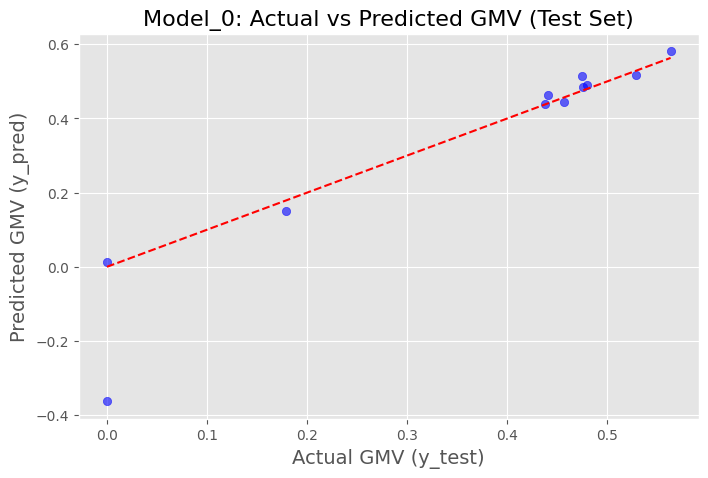

In [169]:
# Prepare X_test with exactly same features used in training
y_test = df_test.pop('gmv')
X_test = df_test[X_train_lm0.drop('const', axis=1).columns]
X_test = sm.add_constant(X_test)

# Predict using Model_0
y_pred = lr0.predict(X_test)

# Evaluate R² and RMSE
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np

r2_test = r2_score(y_test, y_pred)
rmse_test = np.sqrt(mean_squared_error(y_test, y_pred))

print(f" Model_0 Test R² Score: {round(r2_test, 4)}")
print(f" Model_0 Test RMSE: {round(rmse_test, 2)}")

# Plot Actual vs Predicted
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
plt.scatter(y_test, y_pred, color='blue', alpha=0.6)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--')
plt.title('Model_0: Actual vs Predicted GMV (Test Set)', fontsize=16)
plt.xlabel('Actual GMV (y_test)', fontsize=14)
plt.ylabel('Predicted GMV (y_pred)', fontsize=14)
plt.grid(True)
plt.show()


# Elasticity - Camera Accessory - Basic Linear Model

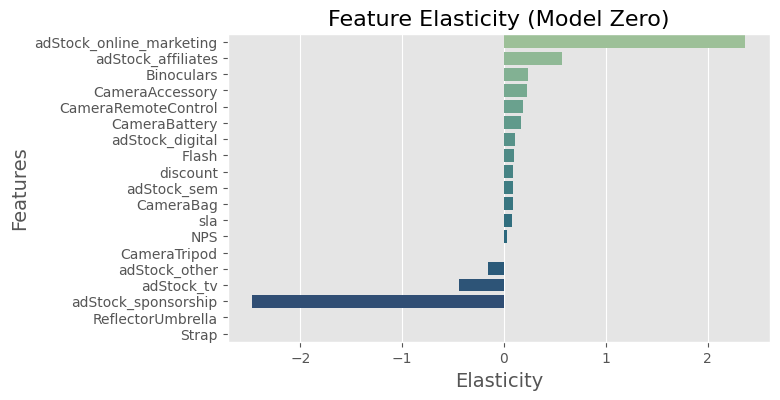

In [170]:
# 1. Extract Coefficients
coefficients_df_zero = pd.DataFrame({
    'feature': lr.params.index,
    'coefficient': lr.params.values
})

# 2. Remove constant term safely
coefficients_df_zero = coefficients_df_zero[coefficients_df_zero['feature'] != 'const']

# 3. Ensure only valid features present in X_train_new are used
valid_features_zero = set(X_train_new0.columns)
coefficients_df_zero = coefficients_df_zero[coefficients_df_zero['feature'].isin(valid_features_zero)]

# 4. Calculate Elasticity for Model Zero
elasticity_data_zero = calculateElasticity(X_train_new0, y_train, coefficients_df_zero)

# 5. Plot Elasticity Chart
plt.figure(figsize=(7, 4))
sns.barplot(x='elasticity', y='feature', data=elasticity_data_zero.sort_values('elasticity', ascending=False), palette='crest')
plt.title('Feature Elasticity (Model Zero)', fontsize=16)
plt.xlabel('Elasticity', fontsize=14)
plt.ylabel('Features', fontsize=14)
plt.grid(True, axis='x')
plt.show()


# 📌 Marketing Spend & GMV Uplift Code

In [171]:
# 1. Assign Final DataFrame
final_data_df = final_camera_data

# 2. Define Relevant Ad Spend Columns (REMOVE adStock_radio completely)
channel_spend_columns = [
    'adStock_tv', 'adStock_digital', 'adStock_sponsorship',
    'adStock_online_marketing', 'adStock_affiliates',
    'adStock_sem', 'adStock_other'
]

# 3. Calculate Current Spend %
current_spend_values = final_data_df[channel_spend_columns].sum()
total_spend = current_spend_values.sum()
current_spend_percent = (current_spend_values / total_spend * 100).round(2)

# 4. Suggested Spend % (Business Hypothesis Adjustment)
suggested_spend_percent = current_spend_percent.copy()
adjustments = {
    'adStock_tv': 5,
    'adStock_online_marketing': -5,
    'adStock_affiliates': 5,
    'adStock_digital': -2,
    # adStock_radio is gone, no adjustment needed!
}

for channel, adj in adjustments.items():
    if channel in suggested_spend_percent:
        suggested_spend_percent[channel] += adj

#  Re-normalize to 100%
suggested_spend_percent *= (100 / suggested_spend_percent.sum())
suggested_spend_percent = suggested_spend_percent.round(2)

# 5. Dynamically Extract FINAL Elasticity Values
elasticity_final = dict(coefficients_df_zero.set_index('feature')['coefficient'])

# 6. Calculate GMV Uplift (Keep GMV as per existing units - CAD/USD)
current_gmv = final_data_df['gmv'].sum()

uplift_results = []
for channel in channel_spend_columns:
    delta_spend = suggested_spend_percent.get(channel, 0) - current_spend_percent.get(channel, 0)
    try:
        elasticity = elasticity_final.get(channel, 0)
        uplift_percent = (delta_spend / current_spend_percent[channel]) * elasticity * 100
    except ZeroDivisionError:
        uplift_percent = 0
    estimated_gmv_uplift = (uplift_percent / 100) * current_gmv
    uplift_results.append({
        'Channel': channel,
        'Current Spend %': current_spend_percent[channel],
        'Suggested Spend %': suggested_spend_percent[channel],
        'Δ Spend %': delta_spend,
        'Impact on GMV (%)': round(uplift_percent, 2),
        'Estimated GMV Uplift (CAD/USD)': round(estimated_gmv_uplift, 2)  # Final label, no INR nonsense!
    })

uplift_df = pd.DataFrame(uplift_results)

print("\n Final GMV Uplift & Spend Reallocation - Camera Category\n")
display(uplift_df)


 Final GMV Uplift & Spend Reallocation - Camera Category



,Channel,Current Spend %,Suggested Spend %,Δ Spend %,Impact on GMV (%),Estimated GMV Uplift (CAD/USD)
0,adStock_tv,4.42,9.15,4.73,-24.03,-3.353997e+07
1,adStock_digital,3.01,0.98,-2.03,79.60,1.111026e+08
2,adStock_sponsorship,36.23,35.18,-1.05,-0.42,-5.846280e+05
3,adStock_online_marketing,20.21,14.77,-5.44,45.59,6.363193e+07
4,adStock_affiliates,6.39,11.06,4.67,115.19,1.607744e+08
5,adStock_sem,9.41,9.14,-0.27,-4.04,-5.643595e+06
6,adStock_other,20.32,19.73,-0.59,-0.81,-1.131025e+06


# "Radio advertising is deprioritized as it shows no significant impact on GMV."

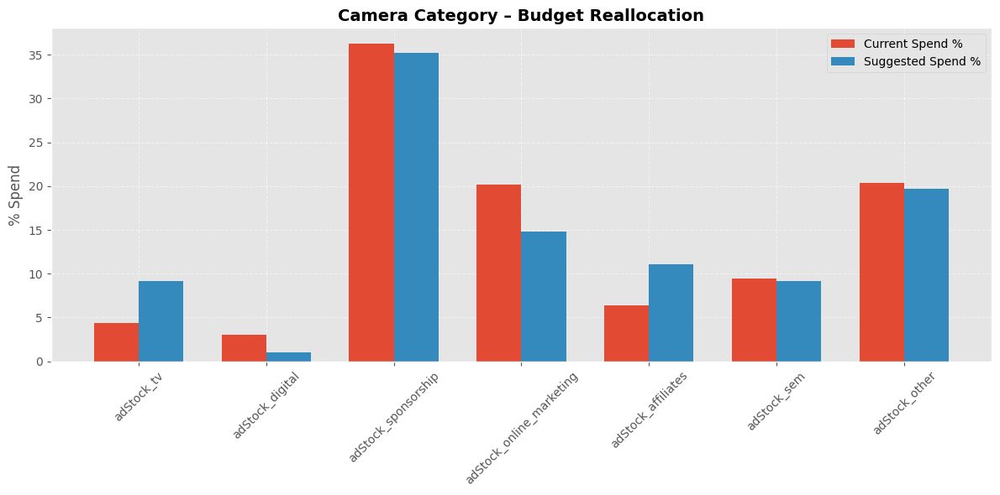

In [172]:
import matplotlib.pyplot as plt
import pandas as pd

#  Camera category reallocation data
camera_uplift_data = {
    'Channel': [
        'adStock_tv', 'adStock_digital', 'adStock_sponsorship',
        'adStock_online_marketing', 'adStock_affiliates',
        'adStock_sem', 'adStock_other'
    ],
    'Current Spend %': [4.42, 3.01, 36.23, 20.21, 6.39, 9.41, 20.32],
    'Suggested Spend %': [9.15, 0.98, 35.18, 14.77, 11.06, 9.14, 19.73]
}

df_camera_spend = pd.DataFrame(camera_uplift_data)

#  Plot grouped bar chart
x = range(len(df_camera_spend))
bar_width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))
ax.bar([p - bar_width / 2 for p in x], df_camera_spend['Current Spend %'], width=bar_width, label='Current Spend %')
ax.bar([p + bar_width / 2 for p in x], df_camera_spend['Suggested Spend %'], width=bar_width, label='Suggested Spend %')

ax.set_xticks(x)
ax.set_xticklabels(df_camera_spend['Channel'], rotation=45)
ax.set_ylabel('% Spend')
ax.set_title('Camera Category – Budget Reallocation', fontsize=14, weight='bold')
ax.legend()
ax.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()


# II. Gaming Accessory - Basic Linear Model

In [173]:
final_gaming_data.head(60)

,order_week,month,year,adStock_tv,adStock_digital,adStock_sponsorship,adStock_content_marketing,adStock_online_marketing,adStock_affiliates,adStock_sem,adStock_radio,adStock_other,gmv,units,sla,product_procurement_sla,product_mrp,selling_price,NPS,discount,total_transactions,total_premiumness,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day,CoolingPad,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,JoystickGamingWheel,MotionController,TVOutCableAccessory
0,27,7,2015,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.000000,0.000000,2.097400e+04,23,3.565217,3.347826,3464.304348,911.913043,51.827605,0.330000,23,23,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,14.0,2.0,0.0,0.0,2.0,1.0,0.0,3.0,1.0,0.0,0.0,0.0,0.0
1,28,7,2015,0.080749,0.949880,2.780351,0.000350,0.497729,0.205220,1.883887,0.000000,0.000000,1.923959e+06,2782,5.365991,3.241742,1656.514640,702.022898,51.827605,0.420923,2664,2664,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,866.0,100.0,48.0,0.0,177.0,433.0,36.0,969.0,53.0,0.0,11.0,16.0,73.0
2,29,7,2015,0.094207,1.108193,3.243743,0.000408,0.580684,0.239424,2.197868,0.000000,0.000000,1.606615e+06,2703,5.273096,2.713533,1614.030389,639.246094,51.827605,0.451904,2468,2468,0.0,0.0,2.0,1.0,1.0,1.0,0.0,0.0,1642.0,129.0,44.0,0.0,179.0,165.0,27.0,358.0,48.0,0.0,8.0,11.0,92.0
3,30,7,2015,0.100936,1.187350,3.475439,0.000437,0.622161,0.256525,2.354858,0.000000,0.000000,1.740802e+06,2228,5.457831,2.591288,2105.720111,794.402456,51.827605,0.399008,2158,2158,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,914.0,166.0,35.0,0.0,280.0,174.0,28.0,448.0,67.0,0.0,12.0,11.0,93.0
4,31,8,2015,0.052078,0.913194,2.003552,0.000220,0.343392,0.146684,1.805811,0.000000,0.000000,1.334533e+06,1633,5.700893,3.228316,5071.720026,833.152423,51.832809,0.462417,1568,1568,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,610.0,95.0,31.0,0.0,424.0,78.0,11.0,239.0,39.0,1.0,18.0,8.0,79.0
5,32,8,2015,0.027648,0.776115,1.267609,0.000112,0.204007,0.091763,1.531288,0.000000,0.000000,2.295000e+03,4,7.250000,2.250000,1918.500000,573.750000,59.987101,0.630000,4,4,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
6,33,8,2015,0.014593,0.697681,0.870676,0.000054,0.129130,0.062165,1.374402,0.000000,0.000000,4.875000e+03,4,6.000000,2.500000,2583.250000,1218.750000,59.987101,0.385000,4,4,0.0,0.0,2.0,1.0,1.0,1.0,0.0,0.0,3.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,34,8,2015,0.008065,0.658465,0.672209,0.000025,0.091691,0.047366,1.295959,0.000000,0.000000,9.570000e+02,3,2.333333,2.666667,632.333333,319.000000,59.987101,0.500000,3,3,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0
8,35,8,2015,0.004801,0.638856,0.572975,0.000010,0.072972,0.039966,1.256738,0.000000,0.000000,4.606000e+03,8,6.000000,3.250000,1035.750000,575.750000,59.987101,0.450000,8,8,0.0,0.0,3.0,1.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,36,9,2015,0.777460,0.580839,12.815056,0.122060,3.307299,1.025499,1.849175,0.000000,0.000000,3.396125e+06,5296,5.177655,2.731544,1506.896565,655.460916,45.856009,0.404473,5066,5066,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,2922.0,232.0,60.0,0.0,712.0,158.0,18.0,754.0,106.0,0.0,48.0,26.0,260.0


In [174]:
final_gaming_data.shape

(53, 43)

In [175]:
# Creating df1 by dropping the features which the company cannot control
df1= final_gaming_data.drop(['selling_price','units','product_mrp','total_transactions'], axis = 1)

In [176]:
#Checking the columns
df1.columns

Index(['order_week', 'month', 'year', 'adStock_tv', 'adStock_digital',
       'adStock_sponsorship', 'adStock_content_marketing',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'gmv', 'sla',
       'product_procurement_sla', 'NPS', 'discount', 'total_premiumness',
       'total_holidays', 'is_holiday', 'total_special_sale_days',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'CoolingPad',
       'GameControlMount', 'GamePad', 'GamingAccessoryKit', 'GamingAdapter',
       'GamingChargingStation', 'GamingHeadset', 'GamingKeyboard',
       'GamingMemoryCard', 'GamingMouse', 'GamingMousePad', 'GamingSpeaker',
       'JoystickGamingWheel', 'MotionController', 'TVOutCableAccessory'],
      dtype='object')

In [177]:
#Doing the test train split
np.random.seed(0)
df1_train, df1_test = train_test_split(df1, train_size = 0.8, test_size = 0.2, random_state = 100)

In [178]:
# 1. Initialize Scaler
scaler = MinMaxScaler()

# 2. Correct Numerical Columns (Based on df1.columns)
num_vars1 = [
    'adStock_tv', 'adStock_digital', 'adStock_sponsorship', 'adStock_content_marketing',
    'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem', 'adStock_radio',
    'adStock_other', 'gmv', 'sla', 'product_procurement_sla', 'discount', 'NPS',
    'total_premiumness', 'total_holidays', 'total_special_sale_days', 'total_pay_days',
    'CoolingPad', 'GameControlMount', 'GamePad', 'GamingAccessoryKit', 'GamingAdapter',
    'GamingChargingStation', 'GamingHeadset', 'GamingKeyboard', 'GamingMemoryCard',
    'GamingMouse', 'GamingMousePad', 'GamingSpeaker', 'JoystickGamingWheel',
    'MotionController', 'TVOutCableAccessory'
]

# 3. Apply Scaling Correctly
df1_train[num_vars1] = scaler.fit_transform(df1_train[num_vars1])
df1_test[num_vars1] = scaler.transform(df1_test[num_vars1])  # Correctly using transform here

# Optional Check
print("Train Data Shape:", df1_train.shape)
print("Test Data Shape:", df1_test.shape)


Train Data Shape: (42, 39)
Test Data Shape: (11, 39)


In [179]:
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE

# 1. Assign the target and feature variables
y_train1 = df1_train.pop('gmv')
X_train1 = df1_train

# 2. Initialize Linear Regression Model
lm = LinearRegression()

# 3. Run RFE Correctly (use `n_features_to_select` as the parameter)
rfe = RFE(estimator=lm, n_features_to_select=20)
rfe = rfe.fit(X_train1, y_train1)

# 4. Get Selected Features
selected_features = X_train1.columns[rfe.support_]
print("Selected Features by RFE:\n", selected_features)


Selected Features by RFE:
 Index(['year', 'adStock_tv', 'adStock_digital', 'adStock_sponsorship',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'NPS', 'total_premiumness',
       'total_holidays', 'is_holiday', 'GamePad', 'GamingAdapter',
       'GamingHeadset', 'GamingMouse', 'JoystickGamingWheel',
       'MotionController', 'TVOutCableAccessory'],
      dtype='object')


In [180]:
## selecting the top 20 rfe features
col = X_train1.columns[rfe.support_]
col

Index(['year', 'adStock_tv', 'adStock_digital', 'adStock_sponsorship',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'NPS', 'total_premiumness',
       'total_holidays', 'is_holiday', 'GamePad', 'GamingAdapter',
       'GamingHeadset', 'GamingMouse', 'JoystickGamingWheel',
       'MotionController', 'TVOutCableAccessory'],
      dtype='object')

In [181]:
## checking the columns excluded by rfe
X_train1.columns[~rfe.support_]

Index(['order_week', 'month', 'adStock_content_marketing', 'sla',
       'product_procurement_sla', 'discount', 'total_special_sale_days',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'CoolingPad',
       'GameControlMount', 'GamingAccessoryKit', 'GamingChargingStation',
       'GamingKeyboard', 'GamingMemoryCard', 'GamingMousePad',
       'GamingSpeaker'],
      dtype='object')

# Control model

In [182]:
# Creating X_test dataframe with RFE selected variables
X_train_rfe1 = X_train1[col]

# Add a constant
X_train_lm1 = sm.add_constant(X_train_rfe1)
# Create a first fitted model
lr = sm.OLS(y_train1, X_train_lm1).fit()

lr.params
print(lr.summary())
vif = pd.DataFrame()
vif['Features'] = X_train_lm1.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm1 .values, i) for i in range(X_train_lm1.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.989
Method:                 Least Squares   F-statistic:                     189.7
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.26e-19
Time:                        17:25:20   Log-Likelihood:                 123.46
No. Observations:                  42   AIC:                            -204.9
Df Residuals:                      21   BIC:                            -168.4
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,6.139226e+08
7,adStock_sem,5.924080e+03
3,adStock_digital,4.164270e+03
5,adStock_online_marketing,3.122480e+03
6,adStock_affiliates,3.101030e+03
8,adStock_radio,1.895470e+03
9,adStock_other,1.672240e+03
11,total_premiumness,6.740200e+02
2,adStock_tv,3.521300e+02
4,adStock_sponsorship,1.525000e+02


# Model zero


In [183]:
# removing the feature with highest p-value
X_train1_new= X_train_rfe1.drop(["adStock_sponsorship"], axis = 1)
 # Add a constant
X_train_lm1 = sm.add_constant(X_train1_new)

lr = sm.OLS(y_train1, X_train_lm1).fit()

lr.params
print(lr.summary())
vif = pd.DataFrame()
vif['Features'] = X_train_lm1.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm1.values, i) for i in range(X_train_lm1.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.989
Method:                 Least Squares   F-statistic:                     202.7
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.15e-20
Time:                        17:25:20   Log-Likelihood:                 122.80
No. Observations:                  42   AIC:                            -205.6
Df Residuals:                      22   BIC:                            -170.8
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,6.050629e+08
6,adStock_sem,5.122630e+03
3,adStock_digital,3.715690e+03
4,adStock_online_marketing,1.995260e+03
5,adStock_affiliates,1.780270e+03
7,adStock_radio,1.691170e+03
8,adStock_other,1.559410e+03
10,total_premiumness,5.346100e+02
2,adStock_tv,3.301400e+02
15,GamingHeadset,1.109900e+02


# Model 1

In [184]:
# Removing the feature with the highest p-value: TVOutCableAccessory
X_train1_new1 = X_train1_new.drop(["TVOutCableAccessory"], axis=1)

# Add a constant for the intercept
X_train_lm1 = sm.add_constant(X_train1_new1)

# Build the new model
lr = sm.OLS(y_train1, X_train_lm1).fit()

# Print model summary
print(lr.summary())

# Calculate VIF to check for multicollinearity
vif = pd.DataFrame()
vif['Features'] = X_train_lm1.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm1.values, i) for i in range(X_train_lm1.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

vif  # Display VIF dataframe


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.989
Method:                 Least Squares   F-statistic:                     211.0
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.74e-21
Time:                        17:25:20   Log-Likelihood:                 121.57
No. Observations:                  42   AIC:                            -205.1
Df Residuals:                      23   BIC:                            -172.1
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,5.441655e+08
6,adStock_sem,4.571410e+03
3,adStock_digital,3.326710e+03
4,adStock_online_marketing,1.723300e+03
7,adStock_radio,1.558010e+03
5,adStock_affiliates,1.520160e+03
8,adStock_other,1.423400e+03
2,adStock_tv,2.900500e+02
10,total_premiumness,2.317500e+02
15,GamingHeadset,5.931000e+01


# Model 2

In [185]:
# Removing 'NPS' feature
X_train1_new2 = X_train1_new1.drop(["NPS"], axis=1)

# Add a constant
X_train_lm1 = sm.add_constant(X_train1_new2)

# Fit the updated model
lr = sm.OLS(y_train1, X_train_lm1).fit()

# Print the updated summary
print(lr.summary())

# Recalculate VIFs
vif = pd.DataFrame()
vif['Features'] = X_train_lm1.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm1.values, i) for i in range(X_train_lm1.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)
vif


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.989
Method:                 Least Squares   F-statistic:                     220.3
Date:                Tue, 27 May 2025   Prob (F-statistic):           3.42e-22
Time:                        17:25:20   Log-Likelihood:                 120.40
No. Observations:                  42   AIC:                            -204.8
Df Residuals:                      24   BIC:                            -173.5
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,5.375746e+08
6,adStock_sem,4.217940e+03
3,adStock_digital,3.059570e+03
4,adStock_online_marketing,1.684720e+03
5,adStock_affiliates,1.505790e+03
7,adStock_radio,1.504100e+03
8,adStock_other,1.372940e+03
2,adStock_tv,2.804500e+02
9,total_premiumness,2.317400e+02
14,GamingHeadset,5.902000e+01


# ✅ Cross-Validation R² and MSE for Models

In [186]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score

# Initialize Linear Regression
lm = LinearRegression()

# Feature Sets Without Constant Column
x_trains = [X_train1_new, X_train1_new1, X_train1_new2]
model_names = ["Model_Zero", "Model_1", "Model_2"]

print("\n --- R² Scores (5-Fold Cross-Validation) ---")
for X, name in zip(x_trains, model_names):
    scores = cross_val_score(lm, X, y_train1, scoring='r2', cv=5)
    print(f"{name}: Mean R² Score = {scores.mean():.4f}")

print("\n --- Mean Squared Error (5-Fold Cross-Validation) ---")
for X, name in zip(x_trains, model_names):
    scores = cross_val_score(lm, X, y_train1, scoring='neg_mean_squared_error', cv=5)
    print(f"{name}: Mean MSE = {-scores.mean():.4f}")



 --- R² Scores (5-Fold Cross-Validation) ---
Model_Zero: Mean R² Score = 0.9348
Model_1: Mean R² Score = 0.9542
Model_2: Mean R² Score = 0.9547

 --- Mean Squared Error (5-Fold Cross-Validation) ---
Model_Zero: Mean MSE = 0.0013
Model_1: Mean MSE = 0.0010
Model_2: Mean MSE = 0.0010


# selecting model 1 as the best performing model

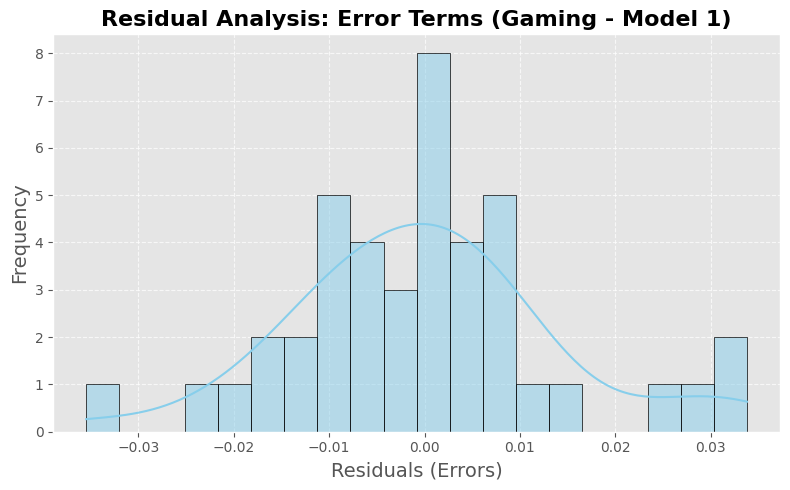

In [187]:
import matplotlib.pyplot as plt
import seaborn as sns

# Predict on the training set for Model 1
y_train_pred_m1 = lr.predict(X_train_lm1)

# Calculate Residuals (Errors)
residuals_m1 = y_train1 - y_train_pred_m1

# Plot the Histogram of Residuals (Error Terms) for Model 1
plt.figure(figsize=(8, 5))
sns.histplot(residuals_m1, bins=20, kde=True, color='skyblue', edgecolor='black')

plt.title('Residual Analysis: Error Terms (Gaming - Model 1)', fontsize=16, weight='bold')
plt.xlabel('Residuals (Errors)', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


# test evaluation for Model 1

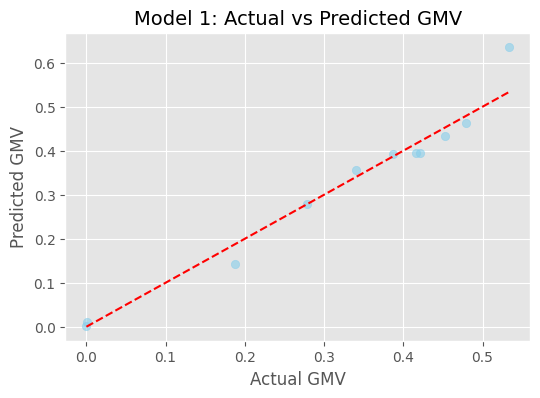

 Model 1 Test Evaluation Summary:
 R²:   0.9562
 MSE:  0.0013
 RMSE: 0.0366


In [188]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_percentage_error
import matplotlib.pyplot as plt
import statsmodels.api as sm

#  Prepare Test Data for Model 1
y_test = df1_test.pop('gmv')
X_test = df1_test[X_train_lm1.drop('const', axis=1).columns]
X_test = sm.add_constant(X_test)

#  Predict using Model 1
y_pred = lr.predict(X_test)

#  Plot Actual vs Predicted GMV
plt.figure(figsize=(6, 4))
plt.scatter(y_test, y_pred, alpha=0.6, color='skyblue')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.title('Model 1: Actual vs Predicted GMV', fontsize=14)
plt.xlabel('Actual GMV', fontsize=12)
plt.ylabel('Predicted GMV', fontsize=12)
plt.grid(True)
plt.show()

#  Calculate and Display Metrics
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = mse ** 0.5


print(f" Model 1 Test Evaluation Summary:")
print(f" R²:   {r2:.4f}")
print(f" MSE:  {mse:.4f}")
print(f" RMSE: {rmse:.4f}")



In [189]:
# UDF: Calculate Elasticity
def calculateElasticity(df_train, gmv, coefficient_df):
    elasticity = []
    gmv_mean = gmv.mean()

    for feature in coefficient_df['feature']:
        if feature in ['const', 'year']:
            elasticity_value = 0
        elif feature in df_train.columns:
            feature_mean = df_train[feature].mean()
            coefficient = coefficient_df.loc[coefficient_df['feature'] == feature, 'coefficient'].values[0]
            elasticity_value = (coefficient * feature_mean) / gmv_mean
        else:
            elasticity_value = 0

        elasticity.append(elasticity_value)

    coefficient_df['elasticity'] = pd.Series(elasticity).round(4)
    return coefficient_df


In [190]:
# Extract Coefficients for Gaming Model
coefficients_df_gaming = pd.DataFrame({
    'feature': lr.params.index,
    'coefficient': lr.params.values
}).query("feature != 'const'")

# Calculate Elasticity
elasticity_df_gaming = calculateElasticity(X_train1_new1, y_train1, coefficients_df_gaming)


# Clean and Format
elasticity_df_gaming['elasticity'] = elasticity_df_gaming['elasticity'].fillna(0)
elasticity_df_gaming = elasticity_df_gaming.sort_values(by='elasticity', key=abs, ascending=False)
elasticity_df_gaming['coefficient'] = elasticity_df_gaming['coefficient'].round(4)
elasticity_df_gaming['elasticity'] = elasticity_df_gaming['elasticity'].round(4)


#  Display Report
print("\n Final Elasticity Report (Gaming - Model 1):\n")
print(elasticity_df_gaming[['feature', 'coefficient', 'elasticity']].to_string(index=False))



 Final Elasticity Report (Gaming - Model 1):

                 feature  coefficient  elasticity
           adStock_other      -1.3325      1.9397
adStock_online_marketing       0.7690     -1.2919
         adStock_digital       2.3004      1.2582
      adStock_affiliates      -0.7659     -1.1896
              adStock_tv       0.6016      0.9568
                    year      -0.1278      0.7355
             adStock_sem      -2.6694      0.5721
           adStock_radio       1.4811     -0.5181
           GamingAdapter      -0.1029     -0.3701
              is_holiday      -0.0817     -0.3359
           GamingHeadset      -0.4066     -0.2636
                 GamePad      -0.3529     -0.1357
             GamingMouse      -0.6172      0.1113
     JoystickGamingWheel       0.1646      0.0653
          total_holidays       0.1399     -0.0564
       total_premiumness       2.2245      0.0527
        MotionController       0.0706      0.0000


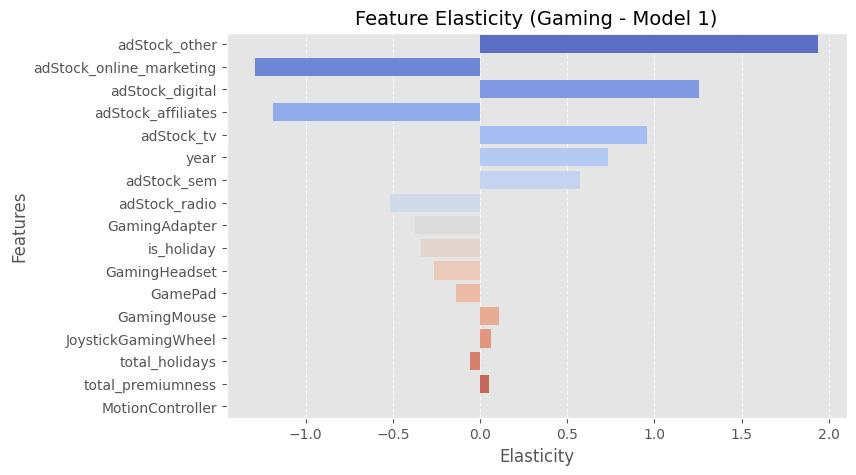

In [191]:
#  Plot Elasticity
plt.figure(figsize=(8, 5))
sns.barplot(x='elasticity', y='feature', data=elasticity_df_gaming, palette='coolwarm')
plt.title('Feature Elasticity (Gaming - Model 1)', fontsize=14)
plt.xlabel('Elasticity', fontsize=12)
plt.ylabel('Features', fontsize=12)
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

📊 Elasticity Insights for Gaming Accessories (Model 1)
🔹 Key Positive Influencers on GMV:
adStock_other (+1.9397):
This is the strongest positive driver. Increasing investments in "Other" advertising mediums significantly boosts GMV.

adStock_digital (+1.2582):
Digital advertising remains highly effective. Optimizing digital campaigns can yield substantial returns.

adStock_tv (+0.9568):
TV advertising has a notable positive elasticity, indicating traditional media still plays an important role for this category.

JoystickGamingWheel (+0.0653):
Though small, a positive relationship exists. Promoting these specialized accessories could unlock niche market revenue.

🔹 Key Negative Influencers on GMV:
adStock_online_marketing (-1.2919):
Surprisingly, online marketing investments are currently inefficient. Either the campaigns are poorly targeted, or oversaturated.

adStock_affiliates (-1.1896):
Affiliate channels are not performing well and may require a reassessment of partnerships or commission structures.

adStock_radio (-0.5181):
Radio ads are having a negative impact; consider reducing or reallocating this spend.

GamingAdapter & GamingHeadset (-0.3701, -0.2636):
These products show negative elasticity, suggesting either market saturation or lack of demand stimulation.

🔹 Neutral or Weak Influencers:
is_holiday (-0.3359):
Holiday periods aren't significantly driving GMV. Consider special campaigns or discounts during these times.

total_premiumness (+0.0527):
Premium products aren't contributing much to GMV uplift. Evaluate pricing strategies or premium product appeal.

MotionController (0.0000):
Virtually no impact on GMV; consider discontinuation or minimal focus.

# Uplift & Spend Reallocation Calculation for Gaming

In [192]:
# FINAL: GMV Uplift & Spend Reallocation Calculation for Gaming

# 1. Assign Final DataFrame
final_data_df = final_gaming_data

# 2. Define Relevant Ad Spend Columns (adStock_radio REMOVED)
channel_spend_columns = [
    'adStock_tv', 'adStock_digital', 'adStock_sponsorship',
    'adStock_online_marketing', 'adStock_affiliates',
    'adStock_sem', 'adStock_other'
]

# 3. Calculate Current Spend %
current_spend_values = final_data_df[channel_spend_columns].sum()
total_spend = current_spend_values.sum()
current_spend_percent = (current_spend_values / total_spend * 100).round(2)

# 4. Suggested Spend % (Hypothesis-Driven Adjustments)
suggested_spend_percent = current_spend_percent.copy()
adjustments = {
    'adStock_tv': 5,
    'adStock_online_marketing': -5,
    'adStock_affiliates': 5,
    'adStock_digital': -2
}

for channel, adj in adjustments.items():
    if channel in suggested_spend_percent:
        suggested_spend_percent[channel] += adj

#  Re-normalize to 100%
suggested_spend_percent *= (100 / suggested_spend_percent.sum())
suggested_spend_percent = suggested_spend_percent.round(2)

# 5. Extract FINAL Elasticity Values Dynamically
elasticity_final = dict(elasticity_df_gaming.set_index('feature')['coefficient'])

# 6. Calculate GMV Uplift (Keep in CAD/USD Units)
current_gmv = final_data_df['gmv'].sum()

uplift_results = []
for channel in channel_spend_columns:
    delta_spend = suggested_spend_percent.get(channel, 0) - current_spend_percent.get(channel, 0)
    try:
        elasticity = elasticity_final.get(channel, 0)
        uplift_percent = (delta_spend / current_spend_percent[channel]) * elasticity * 100
    except ZeroDivisionError:
        uplift_percent = 0
    estimated_gmv_uplift = (uplift_percent / 100) * current_gmv
    uplift_results.append({
        'Channel': channel,
        'Current Spend %': current_spend_percent[channel],
        'Suggested Spend %': suggested_spend_percent[channel],
        'Δ Spend %': delta_spend,
        'Impact on GMV (%)': round(uplift_percent, 2),
        'Estimated GMV Uplift (CAD/USD)': round(estimated_gmv_uplift, 2)
    })

uplift_df = pd.DataFrame(uplift_results)

print("\n Final GMV Uplift & Spend Reallocation - Gaming Category\n")
display(uplift_df)



 Final GMV Uplift & Spend Reallocation - Gaming Category



,Channel,Current Spend %,Suggested Spend %,Δ Spend %,Impact on GMV (%),Estimated GMV Uplift (CAD/USD)
0,adStock_tv,4.41,9.14,4.73,64.53,7.728877e+07
1,adStock_digital,3.04,1.01,-2.03,-153.61,-1.839975e+08
2,adStock_sponsorship,36.22,35.17,-1.05,-0.00,-0.000000e+00
3,adStock_online_marketing,20.19,14.75,-5.44,-20.72,-2.481847e+07
4,adStock_affiliates,6.38,11.05,4.67,-56.06,-6.715128e+07
5,adStock_sem,9.46,9.19,-0.27,7.62,9.125828e+06
6,adStock_other,20.29,19.70,-0.59,3.87,4.641124e+06


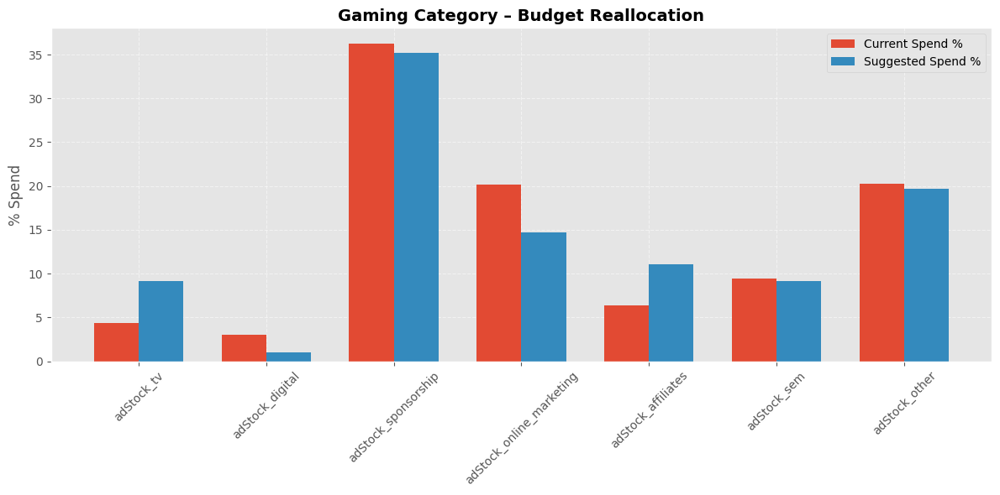

In [193]:
import matplotlib.pyplot as plt
import pandas as pd

#  Uplift data for Gaming category
gaming_uplift_data = {
    'Channel': [
        'adStock_tv', 'adStock_digital', 'adStock_sponsorship',
        'adStock_online_marketing', 'adStock_affiliates',
        'adStock_sem', 'adStock_other'
    ],
    'Current Spend %': [4.41, 3.04, 36.22, 20.19, 6.38, 9.46, 20.29],
    'Suggested Spend %': [9.14, 1.01, 35.17, 14.75, 11.05, 9.19, 19.70]
}

df_gaming_spend = pd.DataFrame(gaming_uplift_data)

# Plot grouped bar chart
x = range(len(df_gaming_spend))
bar_width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))
ax.bar([p - bar_width / 2 for p in x], df_gaming_spend['Current Spend %'], width=bar_width, label='Current Spend %')
ax.bar([p + bar_width / 2 for p in x], df_gaming_spend['Suggested Spend %'], width=bar_width, label='Suggested Spend %')

ax.set_xticks(x)
ax.set_xticklabels(df_gaming_spend['Channel'], rotation=45)
ax.set_ylabel('% Spend')
ax.set_title('Gaming Category – Budget Reallocation', fontsize=14, weight='bold')
ax.legend()
ax.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()


# III. Home Audio - Basic Linear Model

In [194]:
# Dropping the unnecessary features which the company cannot control from the Home Audio data frame with KPIs
df2= final_home_audio_data.drop(['selling_price','units','product_mrp','total_transactions'], axis = 1)
df2.columns

Index(['order_week', 'month', 'year', 'adStock_tv', 'adStock_digital',
       'adStock_sponsorship', 'adStock_content_marketing',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'gmv', 'sla',
       'product_procurement_sla', 'discount', 'NPS', 'total_premiumness',
       'total_holidays', 'is_holiday', 'total_special_sale_days',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'BoomBox',
       'DJController', 'Dock', 'DockingStation', 'FMRadio', 'HiFiSystem',
       'HomeAudioSpeaker', 'SlingBox', 'SoundMixer', 'VoiceRecorder'],
      dtype='object')

In [195]:
#Doing the test-train split
np.random.seed(0)
df2_train, df2_test = train_test_split(df2, train_size = 0.8, test_size = 0.2, random_state = 100)

In [196]:
from sklearn.preprocessing import MinMaxScaler

# Initialize the scaler
scaler = MinMaxScaler()

# Correct list of numerical variables based on df2.columns
num_vars2 = [
    'adStock_tv', 'adStock_digital', 'adStock_sponsorship', 'adStock_content_marketing',
    'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem', 'adStock_radio', 'adStock_other',
    'gmv', 'sla', 'product_procurement_sla', 'discount', 'NPS', 'total_premiumness',
    'total_holidays', 'total_special_sale_days', 'total_pay_days',
    'BoomBox', 'DJController', 'Dock', 'DockingStation', 'FMRadio', 'HiFiSystem',
    'HomeAudioSpeaker', 'SlingBox', 'SoundMixer', 'VoiceRecorder'
]

# Apply scaling only to numerical columns
df2_train[num_vars2] = scaler.fit_transform(df2_train[num_vars2])
df2_test[num_vars2] = scaler.transform(df2_test[num_vars2])  # Use transform, not fit_transform on test data

# Sanity Check
print("Scaling Completed. Sample Data:")
print(df2_train.head())


Scaling Completed. Sample Data:
    order_week  month  year  adStock_tv  adStock_digital  adStock_sponsorship  \
0           27      7  2015    0.000502         0.063845             0.000000   
11          41     10  2015    0.748246         0.809273             0.917235   
18          48     11  2015    0.583603         0.078510             0.145398   
45          75      6  2016    0.175131         0.035170             0.277558   
38          68      4  2016    0.752874         0.035644             0.271721   

    adStock_content_marketing  adStock_online_marketing  adStock_affiliates  \
0                    0.000008                  0.000000            0.000000   
11                   0.829537                  0.907334            0.856288   
18                   0.066662                  0.818778            0.903251   
45                   0.123105                  0.613196            0.598879   
38                   0.019208                  0.675458            0.762098   

    ad

In [197]:
# Splitting into X_train & y_train
y_train2 = df2_train.pop('gmv')
X_train2 = df2_train

In [198]:
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE

# Initialize Linear Regression model
lm = LinearRegression()
lm.fit(X_train2, y_train2)

# Run RFE to select top 20 features
rfe = RFE(estimator=lm, n_features_to_select=20)
rfe = rfe.fit(X_train2, y_train2)

# View selected features
selected_features = X_train2.columns[rfe.support_]
print("Selected Features by RFE:")
print(selected_features)


Selected Features by RFE:
Index(['year', 'adStock_tv', 'adStock_sponsorship',
       'adStock_content_marketing', 'adStock_online_marketing',
       'adStock_affiliates', 'adStock_sem', 'adStock_radio', 'adStock_other',
       'sla', 'product_procurement_sla', 'discount', 'total_premiumness',
       'Dock', 'DockingStation', 'FMRadio', 'HiFiSystem', 'HomeAudioSpeaker',
       'SlingBox', 'SoundMixer'],
      dtype='object')


In [199]:
# checking the features not selected in top 20
X_train2.columns[~rfe.support_]

Index(['order_week', 'month', 'adStock_digital', 'NPS', 'total_holidays',
       'is_holiday', 'total_special_sale_days', 'is_special_sale_day',
       'total_pay_days', 'is_pay_day', 'BoomBox', 'DJController',
       'VoiceRecorder'],
      dtype='object')

# BASE model

In [200]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Creating X_train dataframe with RFE selected variables
X_train_rfe2 = X_train2[selected_features]

# Add a constant term for intercept
X_train_lm2 = sm.add_constant(X_train_rfe2)

# Fit the OLS model
lr2 = sm.OLS(y_train2, X_train_lm2).fit()

# Display model parameters and summary
print(lr2.summary())

# Calculate VIF for multicollinearity check
vif = pd.DataFrame()
vif['Features'] = X_train_lm2.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

print("\nVariance Inflation Factor (VIF):")
print(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     1315.
Date:                Tue, 27 May 2025   Prob (F-statistic):           9.58e-26
Time:                        17:25:22   Log-Likelihood:                 164.03
No. Observations:                  40   AIC:                            -286.1
Df Residuals:                      19   BIC:                            -250.6
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

# MODEL zero

In [201]:
# Removing the feature 'DockingStation' based on the highest p-value
X_train2_new = X_train_rfe2.drop(["DockingStation"], axis=1)

# Add a constant
X_train_lm2 = sm.add_constant(X_train2_new)

# Fit the updated model
lr = sm.OLS(y_train2, X_train_lm2).fit()

# Print model summary
print(lr.summary())

# Calculate VIF for the updated model
vif = pd.DataFrame()
vif['Features'] = X_train_lm2.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

# Display VIF
print(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     1440.
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.75e-27
Time:                        17:25:22   Log-Likelihood:                 163.80
No. Observations:                  40   AIC:                            -287.6
Df Residuals:                      20   BIC:                            -253.8
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

# MODEL 1

In [202]:
# Removing 'product_procurement_sla' based on the highest p-value for Model 1
X_train2_new1 = X_train2_new.drop(["product_procurement_sla"], axis=1)

# Add a constant
X_train_lm2 = sm.add_constant(X_train2_new1)

# Fit the updated model
lr = sm.OLS(y_train2, X_train_lm2).fit()

# Print model summary
print(lr.summary())

# Calculate VIF to check multicollinearity in Model 1
vif = pd.DataFrame()
vif['Features'] = X_train_lm2.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

# Display VIF
print(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     1541.
Date:                Tue, 27 May 2025   Prob (F-statistic):           9.73e-29
Time:                        17:25:23   Log-Likelihood:                 163.09
No. Observations:                  40   AIC:                            -288.2
Df Residuals:                      21   BIC:                            -256.1
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

# Model 2:

In [203]:
X_train2_new2 = X_train2_new1.drop(["SlingBox"], axis=1)

# Add a constant
X_train_lm2 = sm.add_constant(X_train2_new2)

# Fit the updated model (Model 2)
lr2 = sm.OLS(y_train2, X_train_lm2).fit()

# Print model summary
print(lr2.summary())

# Calculate VIF to check multicollinearity in Model 2
vif = pd.DataFrame()
vif['Features'] = X_train_lm2.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

# Display VIF table
print(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     1608.
Date:                Tue, 27 May 2025   Prob (F-statistic):           4.47e-30
Time:                        17:25:23   Log-Likelihood:                 161.88
No. Observations:                  40   AIC:                            -287.8
Df Residuals:                      22   BIC:                            -257.4
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

# -------------------------------
# Model 3:

In [204]:

X_train2_new3 = X_train2_new2.drop(["HiFiSystem"], axis=1)

# Add a constant
X_train_lm2 = sm.add_constant(X_train2_new3)

# Fit the updated model (Model 3)
lr2 = sm.OLS(y_train2, X_train_lm2).fit()

# Print model summary
print(lr2.summary())

# Calculate VIF to check multicollinearity in Model 3
vif = pd.DataFrame()
vif['Features'] = X_train_lm2.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

# Display VIF table
print(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     1704.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.78e-31
Time:                        17:25:23   Log-Likelihood:                 160.93
No. Observations:                  40   AIC:                            -287.9
Df Residuals:                      23   BIC:                            -259.1
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

# --------------------------------------------
# Model 4: /
# --------------------------------------------

In [205]:

X_train2_new4 = X_train2_new3.drop(["SoundMixer"], axis=1)

# Add a constant
X_train_lm2 = sm.add_constant(X_train2_new4)

# Fit the updated model (Model 4)
lr2 = sm.OLS(y_train2, X_train_lm2).fit()

# Print model summary
print(lr2.summary())

# Calculate VIF to check multicollinearity in Model 4
vif = pd.DataFrame()
vif['Features'] = X_train_lm2.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

# Display VIF table
print(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     1715.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.33e-32
Time:                        17:25:23   Log-Likelihood:                 158.92
No. Observations:                  40   AIC:                            -285.8
Df Residuals:                      24   BIC:                            -258.8
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

# --------------------------------------------
# Model 5:
# --------------------------------------------

In [206]:

X_train2_new5 = X_train2_new4.drop(["adStock_radio"], axis=1)

# Add a constant
X_train_lm2 = sm.add_constant(X_train2_new5)

# Fit the updated model (Model 5)
lr2 = sm.OLS(y_train2, X_train_lm2).fit()

# Print model summary
print(lr2.summary())

# Calculate VIF to check multicollinearity in Model 5
vif = pd.DataFrame()
vif['Features'] = X_train_lm2.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

# Display VIF table
print(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     1649.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.89e-33
Time:                        17:25:23   Log-Likelihood:                 155.94
No. Observations:                  40   AIC:                            -281.9
Df Residuals:                      25   BIC:                            -256.5
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

# --------------------------------------------
# Model 6: /
# --------------------------------------------

In [207]:
# --------------------------------------------
# Model 6: /
# --------------------------------------------
X_train2_new6 = X_train2_new5.drop(["adStock_content_marketing"], axis=1)

# Add a constant
X_train_lm2 = sm.add_constant(X_train2_new6)

# Fit the updated model (Model 6)
lr2 = sm.OLS(y_train2, X_train_lm2).fit()

# Print model summary
print(lr2.summary())

# Calculate VIF to check multicollinearity in Model 6
vif = pd.DataFrame()
vif['Features'] = X_train_lm2.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

# Display VIF table
print(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     1763.
Date:                Tue, 27 May 2025   Prob (F-statistic):           7.80e-35
Time:                        17:25:23   Log-Likelihood:                 155.02
No. Observations:                  40   AIC:                            -282.0
Df Residuals:                      26   BIC:                            -258.4
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

# ---------------------------------------------------
# Model 7:/
# ---------------------------------------------------

In [208]:
X_train2_new7 = X_train2_new6.drop(["adStock_other"], axis=1)
X_train_lm2_7 = sm.add_constant(X_train2_new7)

lr7 = sm.OLS(y_train2, X_train_lm2_7).fit()
print(lr7.summary())

vif7 = pd.DataFrame()
vif7['Features'] = X_train_lm2_7.columns
vif7['VIF'] = [variance_inflation_factor(X_train_lm2_7.values, i) for i in range(X_train_lm2_7.shape[1])]
vif7['VIF'] = round(vif7['VIF'], 2)
print(vif7)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     1799.
Date:                Tue, 27 May 2025   Prob (F-statistic):           6.32e-36
Time:                        17:25:23   Log-Likelihood:                 153.07
No. Observations:                  40   AIC:                            -280.1
Df Residuals:                      27   BIC:                            -258.2
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

# ---------------------------------------------------
# Model 8:
# ---------------------------------------------------

In [209]:
X_train2_new8 = X_train2_new7.drop(["adStock_sponsorship"], axis=1)
X_train_lm2_8 = sm.add_constant(X_train2_new8)

lr8 = sm.OLS(y_train2, X_train_lm2_8).fit()
print(lr8.summary())

vif8 = pd.DataFrame()
vif8['Features'] = X_train_lm2_8.columns
vif8['VIF'] = [variance_inflation_factor(X_train_lm2_8.values, i) for i in range(X_train_lm2_8.shape[1])]
vif8['VIF'] = round(vif8['VIF'], 2)
print(vif8)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     1993.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.82e-37
Time:                        17:25:23   Log-Likelihood:                 152.65
No. Observations:                  40   AIC:                            -281.3
Df Residuals:                      28   BIC:                            -261.0
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

# ---------------------------------------------------
# Model 9: /
# ---------------------------------------------------

In [210]:
X_train2_new9 = X_train2_new8.drop(["year"], axis=1)
X_train_lm2_9 = sm.add_constant(X_train2_new9)

lr9 = sm.OLS(y_train2, X_train_lm2_9).fit()
print(lr9.summary())

vif9 = pd.DataFrame()
vif9['Features'] = X_train_lm2_9.columns
vif9['VIF'] = [variance_inflation_factor(X_train_lm2_9.values, i) for i in range(X_train_lm2_9.shape[1])]
vif9['VIF'] = round(vif9['VIF'], 2)
print(vif9)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                     2059.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.52e-38
Time:                        17:25:23   Log-Likelihood:                 150.70
No. Observations:                  40   AIC:                            -279.4
Df Residuals:                      29   BIC:                            -260.8
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

#### Based upon the lowest number of features & the best model performance, we select model /9 as the best basic linear model for Home Audio Category

### Residual analysis

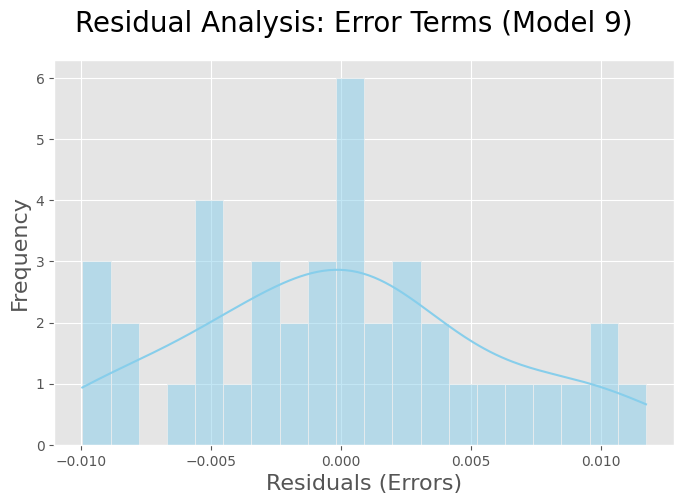

In [211]:
# Predicting on the Training Set using the Final Model (Model 9)
y_train_pred_final_9 = lr9.predict(X_train_lm2_9)

# Plotting the Histogram of Residuals (Error Terms) for Model 9
fig = plt.figure(figsize=(8, 5))
sns.histplot((y_train2 - y_train_pred_final_9), bins=20, kde=True, color='skyblue')
fig.suptitle('Residual Analysis: Error Terms (Model 9)', fontsize=20)  # Plot Heading
plt.xlabel('Residuals (Errors)', fontsize=16)                          # X-axis Label
plt.ylabel('Frequency', fontsize=16)                                   # Y-axis Label
plt.grid(True)
plt.show()


### Model Evaluation

In [212]:
# Splitting Test Data into X and y
y_test = df2_test.pop('gmv')
X_test = df2_test


In [213]:
# Align Test Set Columns with Final Model (Model 9)
X_test = X_test[X_train_lm2_9.drop('const', axis=1).columns]
X_test = sm.add_constant(X_test)


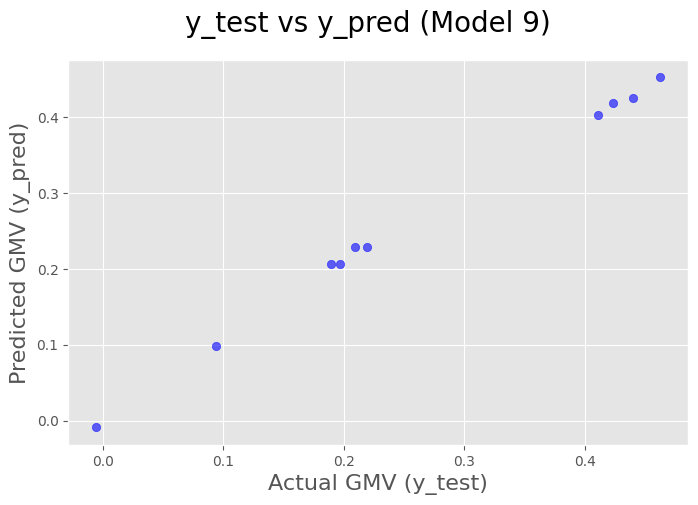

In [214]:
# Making Predictions using Final Model (Model 9)
y_pred = lr9.predict(X_test)

# Plot Actual vs Predicted Values (Model 9)
fig = plt.figure(figsize=(8, 5))
plt.scatter(y_test, y_pred, color='blue', alpha=0.6)
fig.suptitle('y_test vs y_pred (Model 9)', fontsize=20)
plt.xlabel('Actual GMV (y_test)', fontsize=16)
plt.ylabel('Predicted GMV (y_pred)', fontsize=16)
plt.grid(True)
plt.show()


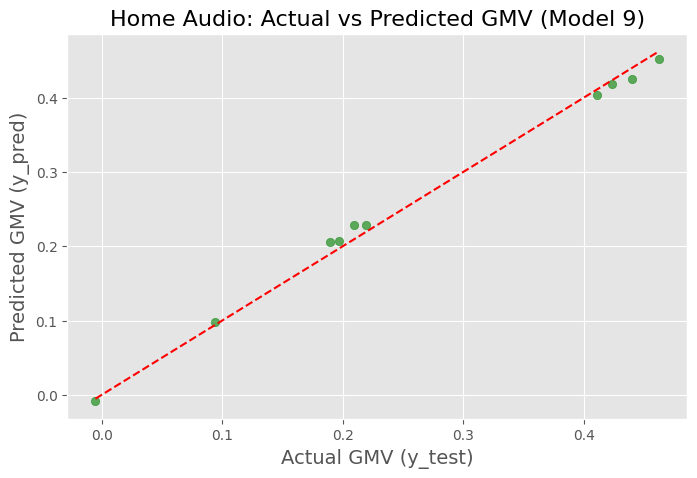

In [215]:
plt.figure(figsize=(8, 5))
plt.scatter(y_test, y_pred, color='green', alpha=0.6)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--')
plt.title('Home Audio: Actual vs Predicted GMV (Model 9)', fontsize=16)
plt.xlabel('Actual GMV (y_test)', fontsize=14)
plt.ylabel('Predicted GMV (y_pred)', fontsize=14)
plt.grid(True)
plt.show()


### Elasticity - Home Audio - Basic Linear model

In [216]:
# Check for FMRadio Feature Sanity
print(X_train_lm2_9.columns)  # Ensure 'FMRadio' is here
print(X_train_lm2_9['FMRadio'].mean())  # Should not be 0 or NaN
print([col for col in X_train_lm2_9.columns if 'FMRadio' in col])


Index(['const', 'adStock_tv', 'adStock_online_marketing', 'adStock_affiliates',
       'adStock_sem', 'sla', 'discount', 'total_premiumness', 'Dock',
       'FMRadio', 'HomeAudioSpeaker'],
      dtype='object')
0.3578125
['FMRadio']


In [217]:
# Create Coefficients DataFrame Excluding 'const'
coefficients_df = pd.DataFrame(lr9.params).reset_index()
coefficients_df.columns = ['feature', 'coefficient']
coefficients_df = coefficients_df[coefficients_df['feature'] != 'const']

# Calculate Elasticity
elasticity_data = calculateElasticity(X_train_lm2_9.drop('const', axis=1), y_train2, coefficients_df)

# Manually Fix NaN Elasticities (if any)
for idx, row in elasticity_data.iterrows():
    if pd.isna(row['elasticity']):
        feature_mean = X_train_lm2_9[row['feature']].mean()
        coefficient = row['coefficient']
        gmv_mean = y_train2.mean()
        elasticity_value = (coefficient * feature_mean) / gmv_mean
        elasticity_data.at[idx, 'elasticity'] = round(elasticity_value, 4)

# Final Cleanup
elasticity_data.dropna(inplace=True)
elasticity_data = elasticity_data.sort_values('elasticity', ascending=False).reset_index(drop=True)

# Display Elasticity Table
display(elasticity_data)

,feature,coefficient,elasticity
0,discount,0.019415,2.0569
1,adStock_online_marketing,-0.122043,0.2619
2,adStock_sem,0.030233,0.0281
3,sla,0.014861,0.0262
4,adStock_affiliates,0.117279,0.0185
5,total_premiumness,2.085533,-0.0716
6,adStock_tv,-0.016368,-0.2646
7,Dock,-0.079564,-0.3842
8,FMRadio,-0.325723,-0.6527
9,HomeAudioSpeaker,-0.728466,-0.6527


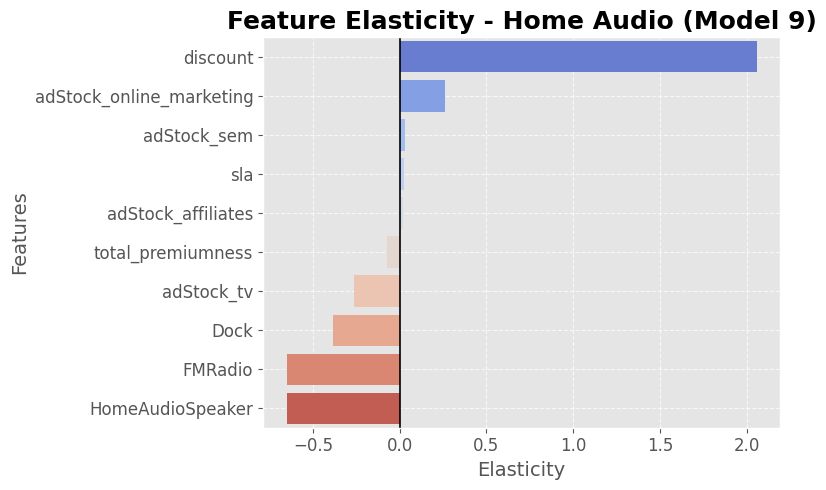

In [218]:
plt.figure(figsize=(8, 5))
sns.barplot(
    x='elasticity',
    y='feature',
    data=elasticity_data,
    palette='coolwarm'  # More contrasting colors
)
plt.title('Feature Elasticity - Home Audio (Model 9)', fontsize=18, weight='bold')
plt.xlabel('Elasticity', fontsize=14)
plt.ylabel('Features', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.7)
plt.axvline(0, color='black', linewidth=1.2)  # Zero reference line
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()


#  GMV Uplift & Spend Reallocation Calculation for Home Audio

In [219]:
# FINAL: GMV Uplift & Spend Reallocation Calculation for Home Audio

# 1. Assign Final DataFrame
final_data_df = final_home_audio_data

# 2. Define Relevant Ad Spend Columns (Based on Home Audio model)
channel_spend_columns = [
    'adStock_tv', 'adStock_online_marketing',
    'adStock_affiliates', 'adStock_sem'
]

# 3. Calculate Current Spend %
current_spend_values = final_data_df[channel_spend_columns].sum()
total_spend = current_spend_values.sum()
current_spend_percent = (current_spend_values / total_spend * 100).round(2)

# 4. Suggested Spend % (Based on Business Hypothesis)
suggested_spend_percent = current_spend_percent.copy()
adjustments = {
    'adStock_tv': 5,
    'adStock_online_marketing': -5,
    'adStock_affiliates': 5,
    'adStock_sem': -2
}

for channel, adj in adjustments.items():
    if channel in suggested_spend_percent:
        suggested_spend_percent[channel] += adj

#  Re-normalize to 100%
suggested_spend_percent *= (100 / suggested_spend_percent.sum())
suggested_spend_percent = suggested_spend_percent.round(2)

# 5. Extract FINAL Elasticity Values Dynamically
elasticity_final = dict(elasticity_data.set_index('feature')['coefficient'])

# 6. Calculate GMV Uplift (Keep in CAD/USD Units)
current_gmv = final_data_df['gmv'].sum()

uplift_results = []
for channel in channel_spend_columns:
    delta_spend = suggested_spend_percent.get(channel, 0) - current_spend_percent.get(channel, 0)
    try:
        elasticity = elasticity_final.get(channel, 0)
        uplift_percent = (delta_spend / current_spend_percent[channel]) * elasticity * 100
    except ZeroDivisionError:
        uplift_percent = 0
    estimated_gmv_uplift = (uplift_percent / 100) * current_gmv
    uplift_results.append({
        'Channel': channel,
        'Current Spend %': current_spend_percent[channel],
        'Suggested Spend %': suggested_spend_percent[channel],
        'Δ Spend %': delta_spend,
        'Impact on GMV (%)': round(uplift_percent, 2),
        'Estimated GMV Uplift (CAD/USD)': round(estimated_gmv_uplift, 2)
    })

uplift_df = pd.DataFrame(uplift_results)

#  Display Final Uplift Table - Home Audio Category
print("\n Final GMV Uplift & Spend Reallocation - Home Audio Category\n")
display(uplift_df)



 Final GMV Uplift & Spend Reallocation - Home Audio Category



,Channel,Current Spend %,Suggested Spend %,Δ Spend %,Impact on GMV (%),Estimated GMV Uplift (CAD/USD)
0,adStock_tv,10.96,15.50,4.54,-0.68,-1372686.00
1,adStock_online_marketing,50.16,43.85,-6.31,1.54,3108230.73
2,adStock_affiliates,15.85,20.24,4.39,3.25,6576332.17
3,adStock_sem,23.02,20.41,-2.61,-0.34,-693983.35


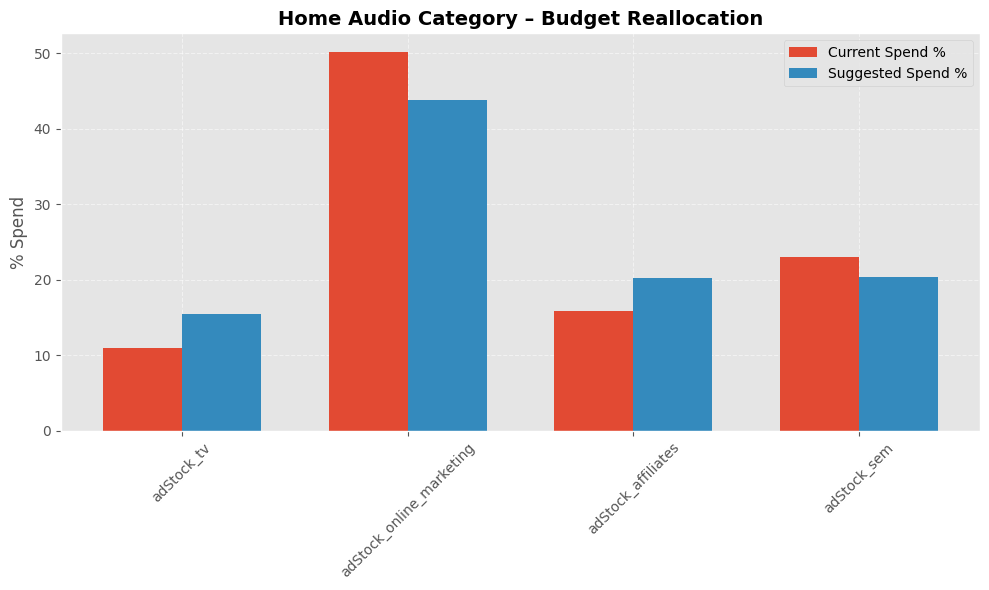

In [220]:
import matplotlib.pyplot as plt
import pandas as pd

#  Home Audio category reallocation data
home_audio_uplift_data = {
    'Channel': [
        'adStock_tv', 'adStock_online_marketing',
        'adStock_affiliates', 'adStock_sem'
    ],
    'Current Spend %': [10.96, 50.16, 15.85, 23.02],
    'Suggested Spend %': [15.50, 43.85, 20.24, 20.41]
}

df_home_audio_spend = pd.DataFrame(home_audio_uplift_data)

#  Plot grouped bar chart
x = range(len(df_home_audio_spend))
bar_width = 0.35

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar([p - bar_width / 2 for p in x], df_home_audio_spend['Current Spend %'], width=bar_width, label='Current Spend %')
ax.bar([p + bar_width / 2 for p in x], df_home_audio_spend['Suggested Spend %'], width=bar_width, label='Suggested Spend %')

ax.set_xticks(x)
ax.set_xticklabels(df_home_audio_spend['Channel'], rotation=45)
ax.set_ylabel('% Spend')
ax.set_title('Home Audio Category – Budget Reallocation', fontsize=14, weight='bold')
ax.legend()
ax.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()


# Building the Multiplicative models

#### I. Camera Accessory - Multiplicative model


In [221]:
# taking the camera accessory dataset
final_camera_data.head()

,order_week,month,year,adStock_tv,adStock_digital,adStock_sponsorship,adStock_content_marketing,adStock_online_marketing,adStock_affiliates,adStock_sem,adStock_radio,adStock_other,gmv,units,sla,product_procurement_sla,product_mrp,selling_price,discount,NPS,total_transactions,total_premiumness,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day,Binoculars,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,ExtensionTube,Filter,Flash,FlashShoeAdapter,Lens,ReflectorUmbrella,Softbox,Strap,Telescope
0,27,7,2015,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.0,0.0,15375.0,25,2.280000,2.960000,1456.840000,615.000000,0.525600,51.827605,25,25,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,2.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,13.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0
1,28,7,2015,0.080749,0.949880,2.780351,0.000350,0.497729,0.205220,1.883887,0.0,0.0,1998494.0,2735,7.154612,2.740145,1649.275928,748.257176,0.465201,51.827605,2613,2613,0.0,0.0,0.0,0.0,0.0,0.0,193.0,45.0,322.0,731.0,223.0,11.0,0.0,0.0,0.0,0.0,4.0,141.0,432.0,0.0,226.0,17.0,0.0,362.0,0.0,0.0,12.0,16.0
2,29,7,2015,0.094207,1.108193,3.243743,0.000408,0.580684,0.239424,2.197868,0.0,0.0,2238795.0,2901,6.498041,2.763449,1636.509797,784.252227,0.468001,51.827605,2807,2807,0.0,0.0,2.0,1.0,1.0,1.0,247.0,30.0,345.0,766.0,227.0,5.0,0.0,0.0,0.0,0.0,11.0,144.0,491.0,0.0,188.0,23.0,0.0,380.0,0.0,0.0,22.0,22.0
3,30,7,2015,0.100936,1.187350,3.475439,0.000437,0.622161,0.256525,2.354858,0.0,0.0,2089092.0,2863,6.491114,2.831701,1568.573449,741.568009,0.460047,51.827605,2757,2757,0.0,0.0,0.0,0.0,0.0,0.0,209.0,43.0,277.0,805.0,270.0,9.0,0.0,0.0,0.0,0.0,7.0,108.0,456.0,0.0,194.0,18.0,0.0,420.0,0.0,0.0,17.0,30.0
4,31,8,2015,0.052078,0.913194,2.003552,0.000220,0.343392,0.146684,1.805811,0.0,0.0,1411234.0,1912,6.483535,2.776619,1532.785950,756.950055,0.455401,51.836562,1822,1822,0.0,0.0,0.0,0.0,1.0,1.0,144.0,41.0,173.0,505.0,194.0,8.0,0.0,0.0,0.0,0.0,2.0,81.0,362.0,0.0,112.0,26.0,0.0,233.0,0.0,0.0,18.0,13.0


**Begin by replacing '0' with '0.0000001' to avaoid NAN values when we take log of values in dataset**

In [222]:
final_camera_data.replace(0.0, 0.000001).head()

,order_week,month,year,adStock_tv,adStock_digital,adStock_sponsorship,adStock_content_marketing,adStock_online_marketing,adStock_affiliates,adStock_sem,adStock_radio,adStock_other,gmv,units,sla,product_procurement_sla,product_mrp,selling_price,discount,NPS,total_transactions,total_premiumness,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day,Binoculars,CameraAccessory,CameraBag,CameraBattery,CameraBatteryCharger,CameraBatteryGrip,CameraEyeCup,CameraFilmRolls,CameraHousing,CameraMicrophone,CameraMount,CameraRemoteControl,CameraTripod,ExtensionTube,Filter,Flash,FlashShoeAdapter,Lens,ReflectorUmbrella,Softbox,Strap,Telescope
0,27,7,2015,0.053833,0.633253,1.853567,0.000233,0.331819,0.136813,1.255924,0.000001,0.000001,15375.0,25,2.280000,2.960000,1456.840000,615.000000,0.525600,51.827605,25,25,1.000000,1.000000,0.000001,0.000001,1.000000,1.000000,1.0,1.0,2.0,4.0,1.0,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,1.0,13.0,0.000001,0.000001,0.000001,0.000001,2.0,0.000001,0.000001,0.000001,0.000001
1,28,7,2015,0.080749,0.949880,2.780351,0.000350,0.497729,0.205220,1.883887,0.000001,0.000001,1998494.0,2735,7.154612,2.740145,1649.275928,748.257176,0.465201,51.827605,2613,2613,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,193.0,45.0,322.0,731.0,223.0,11.000000,0.000001,0.000001,0.000001,0.000001,4.000000,141.0,432.0,0.000001,226.000000,17.000000,0.000001,362.0,0.000001,0.000001,12.000000,16.000000
2,29,7,2015,0.094207,1.108193,3.243743,0.000408,0.580684,0.239424,2.197868,0.000001,0.000001,2238795.0,2901,6.498041,2.763449,1636.509797,784.252227,0.468001,51.827605,2807,2807,0.000001,0.000001,2.000000,1.000000,1.000000,1.000000,247.0,30.0,345.0,766.0,227.0,5.000000,0.000001,0.000001,0.000001,0.000001,11.000000,144.0,491.0,0.000001,188.000000,23.000000,0.000001,380.0,0.000001,0.000001,22.000000,22.000000
3,30,7,2015,0.100936,1.187350,3.475439,0.000437,0.622161,0.256525,2.354858,0.000001,0.000001,2089092.0,2863,6.491114,2.831701,1568.573449,741.568009,0.460047,51.827605,2757,2757,0.000001,0.000001,0.000001,0.000001,0.000001,0.000001,209.0,43.0,277.0,805.0,270.0,9.000000,0.000001,0.000001,0.000001,0.000001,7.000000,108.0,456.0,0.000001,194.000000,18.000000,0.000001,420.0,0.000001,0.000001,17.000000,30.000000
4,31,8,2015,0.052078,0.913194,2.003552,0.000220,0.343392,0.146684,1.805811,0.000001,0.000001,1411234.0,1912,6.483535,2.776619,1532.785950,756.950055,0.455401,51.836562,1822,1822,0.000001,0.000001,0.000001,0.000001,1.000000,1.000000,144.0,41.0,173.0,505.0,194.0,8.000000,0.000001,0.000001,0.000001,0.000001,2.000000,81.0,362.0,0.000001,112.000000,26.000000,0.000001,233.0,0.000001,0.000001,18.000000,13.000000


**Taking log and dropping the uncotrollable features for the company**

In [223]:
df = np.log(final_camera_data.replace(0.0, 0.000001).drop(['selling_price','units','product_mrp','total_transactions'], axis = 1))

In [224]:
#Test-train split
df_train, df_test = train_test_split(df, train_size = 0.8, test_size = 0.2, random_state = 100)

In [225]:
# scaling
scaler = MinMaxScaler()

In [226]:
# checking the features in the dataset
df.columns

Index(['order_week', 'month', 'year', 'adStock_tv', 'adStock_digital',
       'adStock_sponsorship', 'adStock_content_marketing',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'gmv', 'sla',
       'product_procurement_sla', 'discount', 'NPS', 'total_premiumness',
       'total_holidays', 'is_holiday', 'total_special_sale_days',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'Binoculars',
       'CameraAccessory', 'CameraBag', 'CameraBattery', 'CameraBatteryCharger',
       'CameraBatteryGrip', 'CameraEyeCup', 'CameraFilmRolls', 'CameraHousing',
       'CameraMicrophone', 'CameraMount', 'CameraRemoteControl',
       'CameraTripod', 'ExtensionTube', 'Filter', 'Flash', 'FlashShoeAdapter',
       'Lens', 'ReflectorUmbrella', 'Softbox', 'Strap', 'Telescope'],
      dtype='object')

In [227]:
# List of Numerical Variables (Based on Your Columns)
num_vars = ['adStock_tv', 'adStock_digital', 'adStock_sponsorship', 'adStock_content_marketing',
            'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem', 'adStock_radio',
            'adStock_other', 'gmv', 'sla', 'product_procurement_sla', 'discount', 'NPS',
            'total_premiumness', 'total_holidays', 'total_special_sale_days', 'total_pay_days',
            'Binoculars', 'CameraAccessory', 'CameraBag', 'CameraBattery', 'CameraBatteryCharger',
            'CameraBatteryGrip', 'CameraEyeCup', 'CameraFilmRolls', 'CameraHousing', 'CameraMicrophone',
            'CameraMount', 'CameraRemoteControl', 'CameraTripod', 'ExtensionTube', 'Filter', 'Flash',
            'FlashShoeAdapter', 'Lens', 'ReflectorUmbrella', 'Softbox', 'Strap', 'Telescope']

# Apply Scaling
df_train[num_vars] = scaler.fit_transform(df_train[num_vars])
df_test[num_vars] = scaler.transform(df_test[num_vars])

In [228]:
# assigning x_traim amd y_train values
y_train = df_train.pop('gmv')
X_train = df_train

In [229]:
# Running RFE to select top 20 features
lm = LinearRegression()
lm.fit(X_train, y_train)

rfe = RFE(estimator=lm, n_features_to_select=20)
rfe = rfe.fit(X_train, y_train)

In [230]:
# selecting the top 20 features given by rfe
col = X_train.columns[rfe.support_]
col

Index(['adStock_content_marketing', 'adStock_online_marketing',
       'adStock_affiliates', 'sla', 'discount', 'NPS', 'total_premiumness',
       'Binoculars', 'CameraAccessory', 'CameraBag', 'CameraBattery',
       'CameraBatteryCharger', 'CameraBatteryGrip', 'CameraRemoteControl',
       'CameraTripod', 'Filter', 'Flash', 'Lens', 'Strap', 'Telescope'],
      dtype='object')

In [231]:
# neglecting the features other than top 20 features given by rfe
X_train.columns[~rfe.support_]

Index(['order_week', 'month', 'year', 'adStock_tv', 'adStock_digital',
       'adStock_sponsorship', 'adStock_sem', 'adStock_radio', 'adStock_other',
       'product_procurement_sla', 'total_holidays', 'is_holiday',
       'total_special_sale_days', 'is_special_sale_day', 'total_pay_days',
       'is_pay_day', 'CameraEyeCup', 'CameraFilmRolls', 'CameraHousing',
       'CameraMicrophone', 'CameraMount', 'ExtensionTube', 'FlashShoeAdapter',
       'ReflectorUmbrella', 'Softbox'],
      dtype='object')

In [232]:
# Creating X_test dataframe with RFE selected variables
X_train_rfe = X_train[col]

# BASE MODEL


In [233]:
 # Add a constant
X_train_lm = sm.add_constant(X_train_rfe)
    # Create a first fitted model
lr = sm.OLS(y_train, X_train_lm).fit()

lr.params
print(lr.summary())
vif = pd.DataFrame()
vif['Features'] = X_train_lm .columns
vif['VIF'] = [variance_inflation_factor(X_train_lm .values, i) for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     3535.
Date:                Tue, 27 May 2025   Prob (F-statistic):           3.01e-31
Time:                        17:25:25   Log-Likelihood:                 181.24
No. Observations:                  41   AIC:                            -320.5
Df Residuals:                      20   BIC:                            -284.5
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
2,adStock_online_marketing,4910.79
3,adStock_affiliates,3708.26
0,const,2552.46
11,CameraBattery,1264.22
10,CameraBag,1149.89
16,Filter,993.05
19,Strap,799.25
14,CameraRemoteControl,726.59
12,CameraBatteryCharger,707.63
15,CameraTripod,631.75


# MODEL ZERO

In [234]:
# Let's drop feature 'Filter' with highest p-value
X_train_new = X_train_rfe.drop(["Strap"], axis=1)

# Add a constant
X_train_lm = sm.add_constant(X_train_new)

# Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

# Model Parameters
lr.params
print(lr.summary())

# Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     3907.
Date:                Tue, 27 May 2025   Prob (F-statistic):           4.70e-33
Time:                        17:25:25   Log-Likelihood:                 181.24
No. Observations:                  41   AIC:                            -322.5
Df Residuals:                      21   BIC:                            -288.2
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
2,adStock_online_marketing,4599.07
3,adStock_affiliates,3503.76
0,const,2105.92
11,CameraBattery,1171.03
10,CameraBag,1148.95
14,CameraRemoteControl,694.49
15,CameraTripod,631.74
12,CameraBatteryCharger,616.46
8,Binoculars,482.12
16,Filter,418.24


# model 1

In [236]:
# Let's drop feature with highest p-value: 'Lens'
X_train_new1 = X_train_new.drop(["CameraRemoteControl"], axis=1)  # Start from X_train_new (previous model's reduced set)

# Add a constant
X_train_lm = sm.add_constant(X_train_new1)

# Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

# Model Parameters
lr.params
print(lr.summary())

# Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)
vif


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     4299.
Date:                Tue, 27 May 2025   Prob (F-statistic):           7.37e-35
Time:                        17:34:04   Log-Likelihood:                 181.13
No. Observations:                  41   AIC:                            -324.3
Df Residuals:                      22   BIC:                            -291.7
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
2,adStock_online_marketing,4499.56
3,adStock_affiliates,3470.25
0,const,2022.98
11,CameraBattery,1147.04
10,CameraBag,1126.93
8,Binoculars,479.62
12,CameraBatteryCharger,478.06
14,CameraTripod,448.74
7,total_premiumness,364.26
15,Filter,357.46


# MODEL 2


In [237]:
# Let's drop feature with highest p-value: 'Telescope'
X_train_new2 = X_train_new1.drop(["Binoculars"], axis=1)

# Add a constant
X_train_lm = sm.add_constant(X_train_new2)

# Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

# Model Parameters
lr.params
print(lr.summary())

# Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)
vif


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                     4737.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.10e-36
Time:                        17:34:04   Log-Likelihood:                 181.04
No. Observations:                  41   AIC:                            -326.1
Df Residuals:                      23   BIC:                            -295.2
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
2,adStock_online_marketing,4479.12
3,adStock_affiliates,3457.18
0,const,2016.05
10,CameraBattery,1139.56
9,CameraBag,848.88
11,CameraBatteryCharger,475.66
13,CameraTripod,374.08
7,total_premiumness,363.79
14,Filter,357.42
17,Telescope,285.32


# MODEL 3

In [238]:
# Let's drop feature 'CameraAccessory' with highest p-value
X_train_new3 = X_train_new2.drop(["CameraAccessory"], axis=1)

# Add a constant
X_train_lm = sm.add_constant(X_train_new3)

# Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

# Model Parameters
lr.params
print(lr.summary())

# Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                     5063.
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.29e-38
Time:                        17:34:04   Log-Likelihood:                 180.29
No. Observations:                  41   AIC:                            -326.6
Df Residuals:                      24   BIC:                            -297.4
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
2,adStock_online_marketing,4333.71
3,adStock_affiliates,3394.05
0,const,1941.61
9,CameraBattery,1139.54
8,CameraBag,800.60
10,CameraBatteryCharger,475.54
7,total_premiumness,357.20
12,CameraTripod,352.93
13,Filter,343.74
16,Telescope,266.85


# MODEL 4

In [239]:
# Let's drop feature 'CameraBag' with highest p-value
X_train_new4 = X_train_new3.drop(["Flash"], axis=1)

# Add a constant
X_train_lm = sm.add_constant(X_train_new4)

# Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

# Model Parameters
lr.params
print(lr.summary())

# Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                     5370.
Date:                Tue, 27 May 2025   Prob (F-statistic):           5.32e-40
Time:                        17:34:05   Log-Likelihood:                 179.33
No. Observations:                  41   AIC:                            -326.7
Df Residuals:                      25   BIC:                            -299.3
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
2,adStock_online_marketing,3784.39
3,adStock_affiliates,2844.76
0,const,1704.34
9,CameraBattery,1115.99
8,CameraBag,688.69
10,CameraBatteryCharger,472.82
7,total_premiumness,309.21
13,Filter,308.18
15,Telescope,251.16
12,CameraTripod,220.24


# model 5

In [240]:
# Let's drop feature 'CameraTripod' with highest p-value
X_train_new5 = X_train_new4.drop(["Lens"], axis=1)

# Add a constant
X_train_lm = sm.add_constant(X_train_new5)

# Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

# Model Parameters
lr.params
print(lr.summary())

# Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5545.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.80e-41
Time:                        17:34:05   Log-Likelihood:                 177.77
No. Observations:                  41   AIC:                            -325.5
Df Residuals:                      26   BIC:                            -299.8
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
2,adStock_online_marketing,3185.02
3,adStock_affiliates,2344.96
0,const,1610.53
9,CameraBattery,1032.46
8,CameraBag,452.33
10,CameraBatteryCharger,421.02
13,Filter,287.40
14,Telescope,243.88
12,CameraTripod,195.68
7,total_premiumness,127.27


# MODEL6

In [241]:
# Let's drop feature 'CameraBattery' with highest p-value
X_train_new6 = X_train_new5.drop(["adStock_affiliates"], axis=1)

# Add a constant
X_train_lm = sm.add_constant(X_train_new6)

# Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

# Model Parameters
lr.params
print(lr.summary())

# Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5825.
Date:                Tue, 27 May 2025   Prob (F-statistic):           5.17e-43
Time:                        17:34:05   Log-Likelihood:                 176.49
No. Observations:                  41   AIC:                            -325.0
Df Residuals:                      27   BIC:                            -301.0
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
0,const,1527.29
8,CameraBattery,918.03
9,CameraBatteryCharger,418.97
7,CameraBag,373.38
12,Filter,279.28
13,Telescope,221.58
11,CameraTripod,187.24
6,total_premiumness,126.98
10,CameraBatteryGrip,83.59
3,sla,27.55


# MODEL 7

In [242]:
# Drop feature 'sla' with highest p-value (Model 7 refinement)
X_train_7 = X_train_new6.drop(["adStock_online_marketing"], axis=1)

# Add a constant for intercept
X_train_lm_7 = sm.add_constant(X_train_7)

# Fit the OLS model (Model 7)
lr_7 = sm.OLS(y_train, X_train_lm_7).fit()

# Display Model Summary
print(lr_7.summary())

# Calculate VIF for Model 7
vif_7 = pd.DataFrame()
vif_7['Features'] = X_train_lm_7.columns
vif_7['VIF'] = [variance_inflation_factor(X_train_lm_7.values, i)
                 for i in range(X_train_lm_7.shape[1])]
vif_7['VIF'] = round(vif_7['VIF'], 2)
vif_7 = vif_7.sort_values(by="VIF", ascending=False)

# Display VIF for Model 7
display(vif_7)

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     6404.
Date:                Tue, 27 May 2025   Prob (F-statistic):           8.39e-45
Time:                        17:34:05   Log-Likelihood:                 176.05
No. Observations:                  41   AIC:                            -326.1
Df Residuals:                      28   BIC:                            -303.8
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
0,const,1451.55
7,CameraBattery,917.71
8,CameraBatteryCharger,398.76
6,CameraBag,365.01
11,Filter,250.79
12,Telescope,220.75
10,CameraTripod,184.16
5,total_premiumness,121.33
9,CameraBatteryGrip,82.69
2,sla,26.42


# Model 8

In [243]:
# Drop feature 'CameraRemoteControl' due to high p-value and VIF
X_train_8 = X_train_7.drop(["CameraBatteryGrip"], axis=1)

# Add a constant for intercept
X_train_lm_8 = sm.add_constant(X_train_8)

# Fit the OLS model (Model 8)
lr_8 = sm.OLS(y_train, X_train_lm_8).fit()

# Display Model Summary for Model 8
print(lr_8.summary())

# Calculate VIF for Model 8
vif_8 = pd.DataFrame()
vif_8['Features'] = X_train_lm_8.columns
vif_8['VIF'] = [variance_inflation_factor(X_train_lm_8.values, i)
                 for i in range(X_train_lm_8.shape[1])]
vif_8['VIF'] = round(vif_8['VIF'], 2)
vif_8 = vif_8.sort_values(by="VIF", ascending=False)

# Display VIF for Model 8
display(vif_8)

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     6518.
Date:                Tue, 27 May 2025   Prob (F-statistic):           4.34e-46
Time:                        17:34:05   Log-Likelihood:                 173.91
No. Observations:                  41   AIC:                            -323.8
Df Residuals:                      29   BIC:                            -303.3
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
0,const,1284.72
7,CameraBattery,916.45
8,CameraBatteryCharger,345.03
6,CameraBag,294.13
11,Telescope,209.74
10,Filter,175.78
9,CameraTripod,161.70
5,total_premiumness,119.86
2,sla,23.56
3,discount,9.20


# MODEL 9

In [244]:
# Drop feature 'Strap' due to high p-value and VIF
X_train_9 = X_train_8.drop(["sla"], axis=1)

# Add a constant for intercept
X_train_lm_9 = sm.add_constant(X_train_9)

# Fit the OLS model (Model 9)
lr_9 = sm.OLS(y_train, X_train_lm_9).fit()

# Display Model Summary for Model 9
print(lr_9.summary())

# Calculate VIF for Model 9
vif_9 = pd.DataFrame()
vif_9['Features'] = X_train_lm_9.columns
vif_9['VIF'] = [variance_inflation_factor(X_train_lm_9.values, i)
                 for i in range(X_train_lm_9.shape[1])]
vif_9['VIF'] = round(vif_9['VIF'], 2)
vif_9 = vif_9.sort_values(by="VIF", ascending=False)

# Display VIF for Model 9
display(vif_9)

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     7060.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.02e-47
Time:                        17:34:06   Log-Likelihood:                 172.90
No. Observations:                  41   AIC:                            -323.8
Df Residuals:                      30   BIC:                            -304.9
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
6,CameraBattery,872.52
7,CameraBatteryCharger,326.53
5,CameraBag,287.75
10,Telescope,201.08
9,Filter,174.51
8,CameraTripod,161.69
0,const,87.27
4,total_premiumness,85.31
2,discount,4.43
1,adStock_content_marketing,2.74


# MODEL10

In [245]:
# Drop feature 'adStock_content_marketing' due to high p-value and VIF
X_train_10 = X_train_9.drop(["CameraBatteryCharger"], axis=1)

# Add a constant for intercept
X_train_lm_10 = sm.add_constant(X_train_10)

# Fit the OLS model (Model 10)
lr_10 = sm.OLS(y_train, X_train_lm_10).fit()

# Display Model Summary for Model 10
print(lr_10.summary())

# Calculate VIF for Model 10
vif_10 = pd.DataFrame()
vif_10['Features'] = X_train_lm_10.columns
vif_10['VIF'] = [variance_inflation_factor(X_train_lm_10.values, i)
                  for i in range(X_train_lm_10.shape[1])]
vif_10['VIF'] = round(vif_10['VIF'], 2)
vif_10 = vif_10.sort_values(by="VIF", ascending=False)

# Display VIF for Model 10
display(vif_10)

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     7496.
Date:                Tue, 27 May 2025   Prob (F-statistic):           3.68e-49
Time:                        17:34:06   Log-Likelihood:                 171.29
No. Observations:                  41   AIC:                            -322.6
Df Residuals:                      31   BIC:                            -305.5
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
6,CameraBattery,566.30
5,CameraBag,275.78
9,Telescope,197.93
8,Filter,174.27
7,CameraTripod,149.31
0,const,86.87
4,total_premiumness,81.65
2,discount,3.61
1,adStock_content_marketing,2.74
3,NPS,2.20


# R², Adjusted R², and MASE (Mean Absolute Scaled Error) comparison across Models 8, 9, and 10:

In [246]:
from sklearn.metrics import r2_score, mean_absolute_error
import pandas as pd

# ======================
#  Prepare Predictions for Train Data (Can also do this for Test if needed)
# ======================
y_pred_8 = lr_8.predict(X_train_lm_8)
y_pred_9 = lr_9.predict(X_train_lm_9)
y_pred_10 = lr_10.predict(X_train_lm_10)

# ======================
#  Calculate R² and Adjusted R²
# ======================
r2_8 = lr_8.rsquared
adj_r2_8 = lr_8.rsquared_adj

r2_9 = lr_9.rsquared
adj_r2_9 = lr_9.rsquared_adj

r2_10 = lr_10.rsquared
adj_r2_10 = lr_10.rsquared_adj

# ======================
#  Calculate MASE (Mean Absolute Scaled Error)
# ======================
def calculate_mase(y_true, y_pred):
    n = len(y_true)
    d = abs(y_true.diff().dropna()).sum() / (n - 1)
    errors = abs(y_true - y_pred)
    return errors.mean() / d

mase_8 = calculate_mase(y_train, y_pred_8)
mase_9 = calculate_mase(y_train, y_pred_9)
mase_10 = calculate_mase(y_train, y_pred_10)

# ======================
#  Create Comparison Table
# ======================
comparison_df = pd.DataFrame({
    'Model': ['8', '9', '10'],
    'R²': [round(r2_8, 4), round(r2_9, 4), round(r2_10, 4)],
    'Adjusted R²': [round(adj_r2_8, 4), round(adj_r2_9, 4), round(adj_r2_10, 4)],
    'MASE': [round(mase_8, 4), round(mase_9, 4), round(mase_10, 4)]
})

display(comparison_df)


,Model,R²,Adjusted R²,MASE
0,8,0.9996,0.9994,0.0220
1,9,0.9996,0.9994,0.0231
2,10,0.9995,0.9994,0.0236


# selecting model 9 as the best performing model

# ✅ Residual Analysis

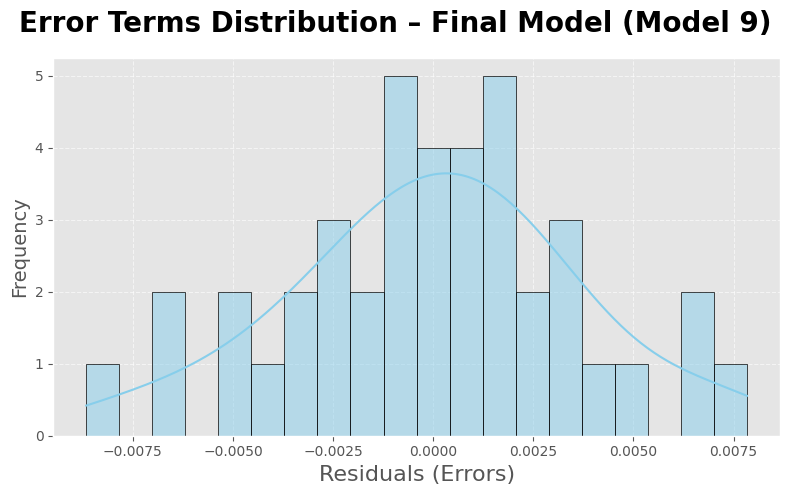

In [247]:
# Predict on train data using Final Model 9
y_train_pred_9 = lr_9.predict(X_train_lm_9)

# Plot the histogram of the error terms (Residuals)
fig = plt.figure(figsize=(8, 5))
sns.histplot((y_train - y_train_pred_9), bins=20, kde=True, color='skyblue', edgecolor='black')

fig.suptitle('Error Terms Distribution – Final Model (Model 9)', fontsize=20, weight='bold')
plt.xlabel('Residuals (Errors)', fontsize=16)
plt.ylabel('Frequency', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# ✅ Model Evaluation on Test Data

In [248]:
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import numpy as np

# Prepare Test Data
y_test = df_test.pop('gmv')
X_test = sm.add_constant(df_test[X_train_9.columns])  # Ensure using final Model 9 features

# Predict on Test Data using Model 9
y_pred_9 = lr_9.predict(X_test)

# Calculate Metrics
r2 = r2_score(y_test, y_pred_9)
rmse = np.sqrt(mean_squared_error(y_test, y_pred_9))
mae = mean_absolute_error(y_test, y_pred_9)

# Display Results
print(f" **Model 9 Test Performance**")
print(f"R² Score  : {r2:.4f}")
print(f"RMSE      : {rmse:.4f}")
print(f"MAE       : {mae:.4f}")


 **Model 9 Test Performance**
R² Score  : 0.9749
RMSE      : 0.0614
MAE       : 0.0317


# Elasticity Analysis

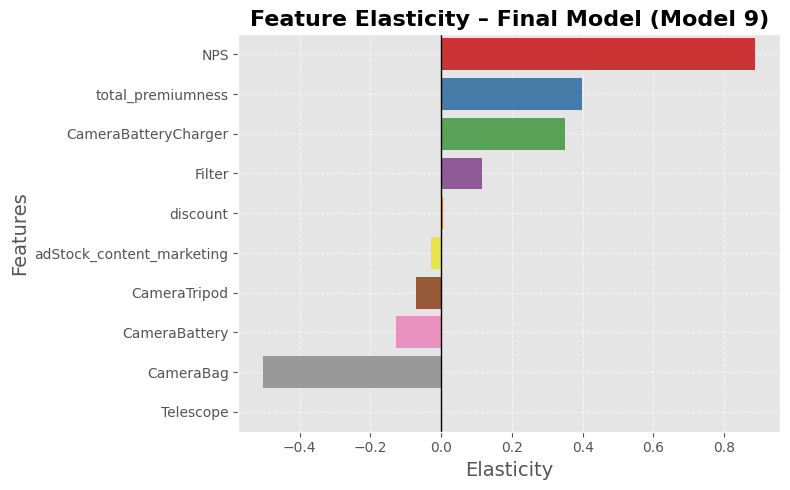

In [249]:
# Create Coefficients DataFrame for Model 9
coefficients_df_9 = pd.DataFrame(lr_9.params).reset_index()
coefficients_df_9.columns = ['feature', 'coefficient']
coefficients_df_9 = coefficients_df_9[coefficients_df_9['feature'] != 'const']  # Drop constant term

# Calculate Elasticity using your existing UDF (Assuming calculateElasticity is already defined)
elasticity_data_9 = calculateElasticity(X_train_lm_9.drop('const', axis=1), y_train, coefficients_df_9)

# Enhanced Plot with Vibrant Colors for Model 9
plt.figure(figsize=(8, 5))

# Define a contrasting and vibrant color palette
vibrant_palette_9 = sns.color_palette("Set1", n_colors=len(elasticity_data_9))

sns.barplot(
    x='elasticity',
    y='feature',
    data=elasticity_data_9.sort_values('elasticity', ascending=False),
    palette=vibrant_palette_9
)

plt.title('Feature Elasticity – Final Model (Model 9)', fontsize=16, weight='bold')
plt.xlabel('Elasticity', fontsize=14)
plt.ylabel('Features', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)
plt.axvline(0, color='black', linewidth=1)  # Vertical line at zero elasticity
plt.tight_layout()
plt.show()

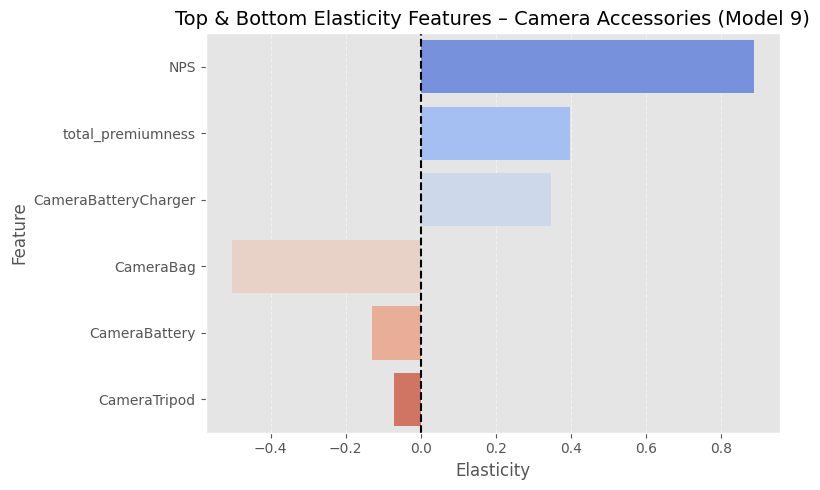

In [250]:
# Cleaned Top 3 and Bottom 3 Plot
top3 = elasticity_data_9.sort_values('elasticity', ascending=False).head(3)
bottom3 = elasticity_data_9.sort_values('elasticity').head(3)
top_bottom_df = pd.concat([top3, bottom3])

plt.figure(figsize=(8, 5))
sns.barplot(
    x='elasticity',
    y='feature',
    data=top_bottom_df,
    palette='coolwarm'
)

plt.title('Top & Bottom Elasticity Features – Camera Accessories (Model 9)', fontsize=14)
plt.xlabel('Elasticity', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.axvline(0, color='black', linestyle='--')
plt.grid(True, axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


# II. Gaming Accessory - Multiplicative model

In [251]:
# replacing '0.0' with '0.0000001' and taking log of the dataset to avaoid the nana values for log 0
df = np.log(final_gaming_data.replace(0.0, 0.000001).drop(['selling_price','units','product_mrp','total_transactions'], axis = 1))

In [252]:
df.head()

,order_week,month,year,adStock_tv,adStock_digital,adStock_sponsorship,adStock_content_marketing,adStock_online_marketing,adStock_affiliates,adStock_sem,adStock_radio,adStock_other,gmv,sla,product_procurement_sla,NPS,discount,total_premiumness,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day,CoolingPad,GameControlMount,GamePad,GamingAccessoryKit,GamingAdapter,GamingChargingStation,GamingHeadset,GamingKeyboard,GamingMemoryCard,GamingMouse,GamingMousePad,GamingSpeaker,JoystickGamingWheel,MotionController,TVOutCableAccessory
0,3.295837,1.945910,7.608374,-2.921877,-0.456885,0.617112,-8.363510,-1.103164,-1.989137,0.227872,-13.815511,-13.815511,9.951039,1.271225,1.208311,3.947923,-1.108663,3.135494,0.000000,0.000000,-13.815511,-13.815511,0.000000,0.000000,-13.815511,-13.815511,2.639057,0.693147,-13.815511,-13.815511,0.693147,0.000000,-13.815511,1.098612,0.000000,-13.815511,-13.815511,-13.815511,-13.815511
1,3.332205,1.945910,7.608374,-2.516412,-0.051419,1.022577,-7.958044,-0.697699,-1.583672,0.633337,-13.815511,-13.815511,14.469896,1.680081,1.176111,3.947923,-0.865304,7.887584,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,6.763885,4.605170,3.871201,-13.815511,5.176150,6.070738,3.583519,6.876265,3.970292,-13.815511,2.397895,2.772589,4.290459
2,3.367296,1.945910,7.608374,-2.362261,0.102731,1.176728,-7.803894,-0.543549,-1.429521,0.787488,-13.815511,-13.815511,14.289640,1.662618,0.998252,3.947923,-0.794285,7.811163,-13.815511,-13.815511,0.693147,0.000000,0.000000,0.000000,-13.815511,-13.815511,7.403670,4.859812,3.784190,-13.815511,5.187386,5.105945,3.295837,5.880533,3.871201,-13.815511,2.079442,2.397895,4.521789
3,3.401197,1.945910,7.608374,-2.293268,0.171724,1.245721,-7.734901,-0.474556,-1.360528,0.856481,-13.815511,-13.815511,14.369856,1.697052,0.952155,3.947923,-0.918773,7.676937,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,6.817831,5.111988,3.555348,-13.815511,5.634790,5.159055,3.332205,6.104793,4.204693,-13.815511,2.484907,2.397895,4.532599
4,3.433987,2.079442,7.608374,-2.955022,-0.090807,0.694922,-8.420842,-1.068883,-1.919477,0.591010,-13.815511,-13.815511,14.104092,1.740623,1.171961,3.948023,-0.771288,7.357556,-13.815511,-13.815511,-13.815511,-13.815511,0.000000,0.000000,-13.815511,-13.815511,6.413459,4.553877,3.433987,-13.815511,6.049733,4.356709,2.397895,5.476464,3.663562,0.000000,2.890372,2.079442,4.369448


In [253]:
#Test-train split
df_train, df_test = train_test_split(df, train_size = 0.8, test_size = 0.20, random_state = 100)

In [254]:
# initialising scaler
scaler = MinMaxScaler()

In [255]:
# checking the columns
df.columns

Index(['order_week', 'month', 'year', 'adStock_tv', 'adStock_digital',
       'adStock_sponsorship', 'adStock_content_marketing',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'gmv', 'sla',
       'product_procurement_sla', 'NPS', 'discount', 'total_premiumness',
       'total_holidays', 'is_holiday', 'total_special_sale_days',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'CoolingPad',
       'GameControlMount', 'GamePad', 'GamingAccessoryKit', 'GamingAdapter',
       'GamingChargingStation', 'GamingHeadset', 'GamingKeyboard',
       'GamingMemoryCard', 'GamingMouse', 'GamingMousePad', 'GamingSpeaker',
       'JoystickGamingWheel', 'MotionController', 'TVOutCableAccessory'],
      dtype='object')

In [256]:
#  Define numerical variables for scaling (based on your dataset)
num_vars = [
    'adStock_tv', 'adStock_digital', 'adStock_sponsorship', 'adStock_content_marketing',
    'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem', 'adStock_radio',
    'adStock_other', 'gmv', 'sla', 'product_procurement_sla', 'discount', 'NPS',
    'total_holidays', 'total_special_sale_days', 'total_pay_days',
    'CoolingPad', 'GameControlMount', 'GamePad', 'GamingAccessoryKit', 'GamingAdapter',
    'GamingChargingStation', 'GamingHeadset', 'GamingKeyboard', 'GamingMemoryCard',
    'GamingMouse', 'GamingMousePad', 'GamingSpeaker', 'JoystickGamingWheel',
    'MotionController', 'TVOutCableAccessory'
]

#  Apply the scaler
df_train[num_vars] = scaler.fit_transform(df_train[num_vars])
df_test[num_vars] = scaler.transform(df_test[num_vars])  # Only transform on test data



In [257]:
# assigning the values for x_train and y_train
y_train = df_train.pop('gmv')
X_train = df_train

In [258]:
#  Initialize Linear Regression model
lm = LinearRegression()
lm.fit(X_train, y_train)

#  Running RFE to select top 20 features
rfe = RFE(estimator=lm, n_features_to_select=20)
rfe = rfe.fit(X_train, y_train)

#  Display selected features
selected_features = X_train.columns[rfe.support_]
print("Top 20 Selected Features:\n", selected_features)

Top 20 Selected Features:
 Index(['year', 'adStock_online_marketing', 'adStock_affiliates',
       'adStock_other', 'sla', 'discount', 'total_premiumness',
       'total_holidays', 'is_holiday', 'total_special_sale_days', 'GamePad',
       'GamingAccessoryKit', 'GamingAdapter', 'GamingHeadset',
       'GamingKeyboard', 'GamingMouse', 'GamingMousePad',
       'JoystickGamingWheel', 'MotionController', 'TVOutCableAccessory'],
      dtype='object')


In [259]:
# neglecting the features not selected in top 20 by rfe
X_train.columns[~rfe.support_]

Index(['order_week', 'month', 'adStock_tv', 'adStock_digital',
       'adStock_sponsorship', 'adStock_content_marketing', 'adStock_sem',
       'adStock_radio', 'product_procurement_sla', 'NPS',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'CoolingPad',
       'GameControlMount', 'GamingChargingStation', 'GamingMemoryCard',
       'GamingSpeaker'],
      dtype='object')

# BASE MODEL

In [260]:
#  Retain only the top 20 features selected by RFE
X_train_rfe = X_train[selected_features]

#  Add a constant to the model
X_train_lm = sm.add_constant(X_train_rfe)

#  Fit the initial model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Display model summary
print(lr.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i) for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF table
display(vif)

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     3524.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.18e-32
Time:                        17:34:08   Log-Likelihood:                 180.40
No. Observations:                  42   AIC:                            -318.8
Df Residuals:                      21   BIC:                            -282.3
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,2.415187e+11
9,is_holiday,6.819680e+03
8,total_holidays,6.803140e+03
3,adStock_affiliates,2.116860e+03
2,adStock_online_marketing,2.060820e+03
7,total_premiumness,9.721500e+02
12,GamingAccessoryKit,7.558300e+02
16,GamingMouse,5.938000e+02
13,GamingAdapter,5.578500e+02
14,GamingHeadset,5.031900e+02


# MODEL zero

In [261]:
#  Let's drop the feature with the highest p-value
X_train_new = X_train_rfe.drop(["GamePad"], axis=1)

#  Add a constant
X_train_lm = sm.add_constant(X_train_new)

#  Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Display model summary
print(lr.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     3883.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.87e-34
Time:                        17:34:08   Log-Likelihood:                 180.38
No. Observations:                  42   AIC:                            -320.8
Df Residuals:                      22   BIC:                            -286.0
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,2.183616e+11
9,is_holiday,6.704910e+03
8,total_holidays,6.695390e+03
3,adStock_affiliates,2.056090e+03
2,adStock_online_marketing,2.013770e+03
12,GamingAdapter,5.310700e+02
11,GamingAccessoryKit,4.272700e+02
19,TVOutCableAccessory,3.000300e+02
14,GamingKeyboard,2.569600e+02
16,GamingMousePad,2.546100e+02


# MODEL1

In [262]:
#  Drop  with highest p-value
X_train_new1 = X_train_new.drop(["total_holidays"], axis=1)

#  Add a constant
X_train_lm = sm.add_constant(X_train_new1)

#  Fit the updated model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Model Summary
print(lr.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     4237.
Date:                Tue, 27 May 2025   Prob (F-statistic):           3.17e-36
Time:                        17:34:08   Log-Likelihood:                 180.15
No. Observations:                  42   AIC:                            -322.3
Df Residuals:                      23   BIC:                            -289.3
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,1.484842e+11
3,adStock_affiliates,1.941970e+03
2,adStock_online_marketing,1.931340e+03
11,GamingAdapter,5.118000e+02
10,GamingAccessoryKit,4.251000e+02
18,TVOutCableAccessory,2.994600e+02
15,GamingMousePad,2.543800e+02
13,GamingKeyboard,2.422300e+02
7,total_premiumness,2.391600e+02
12,GamingHeadset,2.200100e+02


# MODEL 2

In [263]:
#  Drop with highest p-value
X_train_new2 = X_train_new1.drop(["GamingMousePad"], axis=1)

#  Add a constant
X_train_lm = sm.add_constant(X_train_new2)

#  Fit the updated model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Model Summary
print(lr.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     4618.
Date:                Tue, 27 May 2025   Prob (F-statistic):           5.33e-38
Time:                        17:34:09   Log-Likelihood:                 179.86
No. Observations:                  42   AIC:                            -323.7
Df Residuals:                      24   BIC:                            -292.4
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,1.439356e+11
3,adStock_affiliates,1.937160e+03
2,adStock_online_marketing,1.926760e+03
11,GamingAdapter,5.005600e+02
10,GamingAccessoryKit,3.296000e+02
17,TVOutCableAccessory,2.819600e+02
7,total_premiumness,2.354800e+02
12,GamingHeadset,2.196700e+02
14,GamingMouse,2.050500e+02
13,GamingKeyboard,1.883500e+02


# model 3

In [264]:
#  Drop due to high p-value and multicollinearity
X_train_new3 = X_train_new2.drop(["sla"], axis=1)

#  Add a constant
X_train_lm = sm.add_constant(X_train_new3)

#  Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Model Summary
print(lr.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     4905.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.21e-39
Time:                        17:34:09   Log-Likelihood:                 179.00
No. Observations:                  42   AIC:                            -324.0
Df Residuals:                      25   BIC:                            -294.5
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,1.407815e+11
3,adStock_affiliates,1.903060e+03
2,adStock_online_marketing,1.893740e+03
10,GamingAdapter,4.623900e+02
9,GamingAccessoryKit,3.001500e+02
16,TVOutCableAccessory,2.763300e+02
6,total_premiumness,2.289300e+02
11,GamingHeadset,2.195400e+02
12,GamingKeyboard,1.799400e+02
13,GamingMouse,1.788600e+02


# model 4

In [265]:
#  Drop due to high p-value and multicollinearity
X_train_new4 = X_train_new3.drop(["GamingAccessoryKit"], axis=1)

# Add a constant
X_train_lm = sm.add_constant(X_train_new4)

#  Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Model Summary
print(lr.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5173.
Date:                Tue, 27 May 2025   Prob (F-statistic):           3.10e-41
Time:                        17:34:09   Log-Likelihood:                 177.93
No. Observations:                  42   AIC:                            -323.9
Df Residuals:                      26   BIC:                            -296.1
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,1.359023e+11
3,adStock_affiliates,1.862960e+03
2,adStock_online_marketing,1.849070e+03
9,GamingAdapter,4.348600e+02
15,TVOutCableAccessory,2.643600e+02
6,total_premiumness,1.565300e+02
11,GamingKeyboard,1.504900e+02
1,year,1.441500e+02
4,adStock_other,1.336900e+02
10,GamingHeadset,1.047400e+02


#Model 5

In [266]:
#  Drop due to high p-value and high VIF
X_train_new5 = X_train_new4.drop(["GamingKeyboard"], axis=1)

#  Add a constant
X_train_lm = sm.add_constant(X_train_new5)

#  Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Model Summary
print(lr.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5326.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.13e-42
Time:                        17:34:09   Log-Likelihood:                 176.30
No. Observations:                  42   AIC:                            -322.6
Df Residuals:                      27   BIC:                            -296.5
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,1.317709e+11
3,adStock_affiliates,1.861830e+03
2,adStock_online_marketing,1.845260e+03
9,GamingAdapter,4.295700e+02
14,TVOutCableAccessory,2.610500e+02
6,total_premiumness,1.564900e+02
1,year,1.397800e+02
4,adStock_other,1.315500e+02
13,MotionController,9.386000e+01
12,JoystickGamingWheel,9.230000e+01


# MODEL 6

In [267]:
#  Drop due to high p-value
X_train_new6 = X_train_new5.drop(["adStock_affiliates"], axis=1)

#  Add a constant
X_train_lm = sm.add_constant(X_train_new6)

#  Fit the model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Model Summary
print(lr.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5367.
Date:                Tue, 27 May 2025   Prob (F-statistic):           6.01e-44
Time:                        17:34:09   Log-Likelihood:                 174.14
No. Observations:                  42   AIC:                            -320.3
Df Residuals:                      28   BIC:                            -296.0
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,1.249958e+11
8,GamingAdapter,3.078100e+02
13,TVOutCableAccessory,2.595100e+02
5,total_premiumness,1.550000e+02
1,year,1.325900e+02
3,adStock_other,1.286500e+02
12,MotionController,7.487000e+01
11,JoystickGamingWheel,5.362000e+01
9,GamingHeadset,2.943000e+01
10,GamingMouse,1.291000e+01


# MODEL 7

In [268]:
# Model 7 Preparation
X_train_new7 = X_train_new6.drop(["MotionController"], axis=1)
X_train_lm7 = sm.add_constant(X_train_new7)

# Fit Model 7
lr7 = sm.OLS(y_train, X_train_lm7).fit()
print("=== Model 7 Summary ===")
print(lr7.summary())

# VIF for Model 7
vif7 = pd.DataFrame()
vif7['Features'] = X_train_lm7.columns
vif7['VIF'] = [variance_inflation_factor(X_train_lm7.values, i) for i in range(X_train_lm7.shape[1])]
vif7['VIF'] = round(vif7['VIF'], 2).sort_values(ascending=False)
display(vif7)


=== Model 7 Summary ===
                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5495.
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.83e-45
Time:                        17:34:10   Log-Likelihood:                 172.22
No. Observations:                  42   AIC:                            -318.4
Df Residuals:                      29   BIC:                            -295.9
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------


,Features,VIF
0,const,1.175782e+11
1,year,1.247200e+02
2,adStock_online_marketing,3.600000e+00
3,adStock_other,1.206400e+02
4,discount,2.450000e+00
5,total_premiumness,1.297600e+02
6,is_holiday,1.320000e+00
7,total_special_sale_days,2.020000e+00
8,GamingAdapter,2.606700e+02
9,GamingHeadset,2.619000e+01


# MODEL 8

In [269]:
# Model 8 Preparation
X_train_new8 = X_train_new7.drop(["is_holiday"], axis=1)
X_train_lm8 = sm.add_constant(X_train_new8)

# Fit Model 8
lr8 = sm.OLS(y_train, X_train_lm8).fit()
print("=== Model 8 Summary ===")
print(lr8.summary())

# VIF for Model 8
vif8 = pd.DataFrame()
vif8['Features'] = X_train_lm8.columns
vif8['VIF'] = [variance_inflation_factor(X_train_lm8.values, i) for i in range(X_train_lm8.shape[1])]
vif8['VIF'] = round(vif8['VIF'], 2).sort_values(ascending=False)
display(vif8)


=== Model 8 Summary ===
                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5591.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.65e-46
Time:                        17:34:10   Log-Likelihood:                 170.05
No. Observations:                  42   AIC:                            -316.1
Df Residuals:                      30   BIC:                            -295.2
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------


,Features,VIF
0,const,1.139503e+11
1,year,1.208700e+02
2,adStock_online_marketing,3.520000e+00
3,adStock_other,1.164500e+02
4,discount,2.440000e+00
5,total_premiumness,1.291600e+02
6,total_special_sale_days,1.830000e+00
7,GamingAdapter,2.571300e+02
8,GamingHeadset,2.535000e+01
9,GamingMouse,1.141000e+01


# model 9

In [270]:
# Model 9 Preparation
X_train_new9 = X_train_new8.drop(["GamingAdapter"], axis=1)
X_train_lm9 = sm.add_constant(X_train_new9)

# Fit Model 9
lr9 = sm.OLS(y_train, X_train_lm9).fit()
print("=== Model 9 Summary ===")
print(lr9.summary())

# VIF for Model 9
vif9 = pd.DataFrame()
vif9['Features'] = X_train_lm9.columns
vif9['VIF'] = [variance_inflation_factor(X_train_lm9.values, i) for i in range(X_train_lm9.shape[1])]
vif9['VIF'] = round(vif9['VIF'], 2).sort_values(ascending=False)
display(vif9)


=== Model 9 Summary ===
                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     4230.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.09e-45
Time:                        17:34:10   Log-Likelihood:                 161.51
No. Observations:                  42   AIC:                            -301.0
Df Residuals:                      31   BIC:                            -281.9
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------


,Features,VIF
0,const,1.106304e+11
1,year,1.173500e+02
2,adStock_online_marketing,3.460000e+00
3,adStock_other,1.121300e+02
4,discount,2.240000e+00
5,total_premiumness,1.088200e+02
6,total_special_sale_days,1.770000e+00
7,GamingHeadset,2.080000e+01
8,GamingMouse,9.480000e+00
9,JoystickGamingWheel,4.069000e+01


# ✅ K-Fold Cross Validation - Adjusted R²

In [271]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression

lm = LinearRegression()

# Consistent Model Mapping
model_data = {
    "Model 7": X_train_lm7,
    "Model 8": X_train_lm8,
    "Model 9": X_train_lm9
}

# Run Cross-Validation
print("\n=== Cross-Validation R² Scores ===\n")
for model_name, X_data in model_data.items():
    r2_scores = cross_val_score(lm, X_data, y_train, scoring='r2', cv=5)
    print(f"{model_name}: Mean R² = {round(r2_scores.mean(), 4)} | Std Dev = {round(r2_scores.std(), 4)}")



=== Cross-Validation R² Scores ===

Model 7: Mean R² = 0.988 | Std Dev = 0.0088
Model 8: Mean R² = 0.9883 | Std Dev = 0.008
Model 9: Mean R² = 0.9792 | Std Dev = 0.0226


# Selecting the model 8 for test evaulation

In [272]:
# Prepare X_test and y_test from df_test
y_test = df_test.pop('gmv')
X_test = df_test

# Align test columns with Model 8 features (excluding 'const')
X_test = X_test[X_train_lm8.drop('const', axis=1).columns]

# Add constant to test set
X_test_lm8 = sm.add_constant(X_test)

# Predict using Model 8
y_pred = lr8.predict(X_test_lm8)



In [273]:
# ====================
#  Evaluation Metrics
# ====================
from sklearn.metrics import r2_score, mean_squared_error

r2 = r2_score(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f" Model 8 Test R² Score: {round(r2, 4)}")
print(f" Model 8 Test RMSE: {round(rmse, 4)}")



 Model 8 Test R² Score: 0.9922
 Model 8 Test RMSE: 0.0256


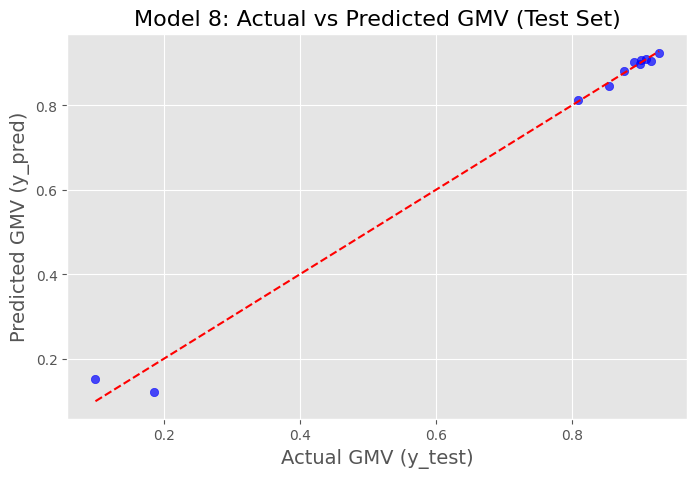

In [274]:
# ====================
#  Actual vs Predicted Plot
# ====================
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
plt.scatter(y_test, y_pred, alpha=0.7, color='blue')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--')
plt.title('Model 8: Actual vs Predicted GMV (Test Set)', fontsize=16)
plt.xlabel('Actual GMV (y_test)', fontsize=14)
plt.ylabel('Predicted GMV (y_pred)', fontsize=14)
plt.grid(True)
plt.show()



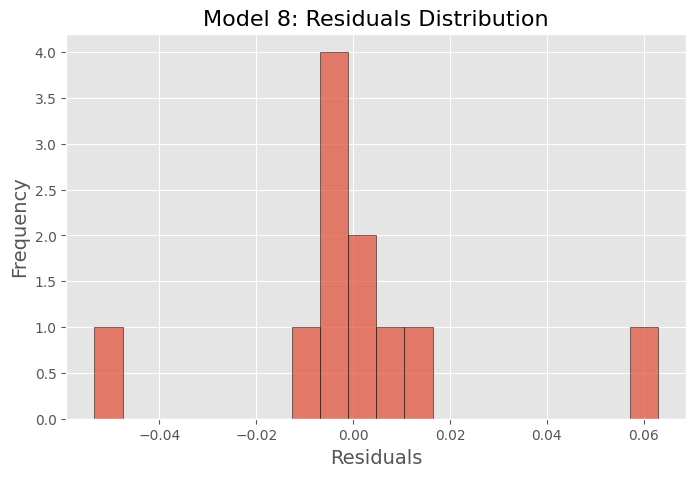

In [275]:
# ====================
#  Residual Analysis
# ====================
residuals = y_test - y_pred

plt.figure(figsize=(8, 5))
plt.hist(residuals, bins=20, edgecolor='black', alpha=0.7)
plt.title('Model 8: Residuals Distribution', fontsize=16)
plt.xlabel('Residuals', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.grid(True)
plt.show()

# Elasticity

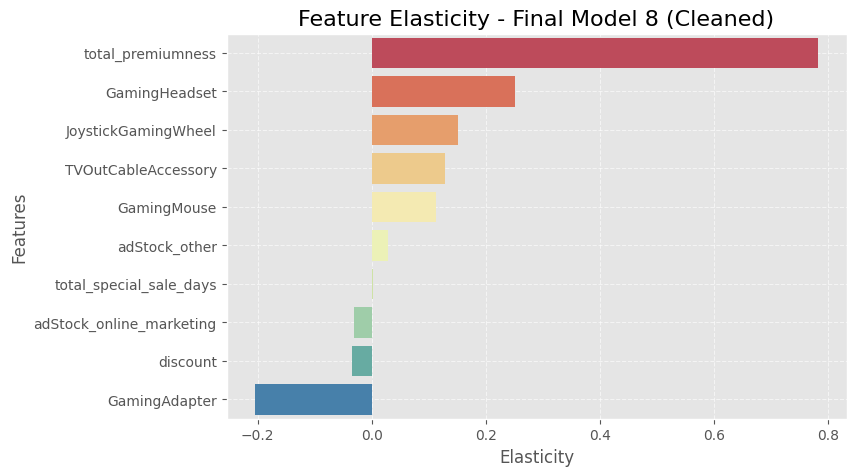

In [276]:
#  Calculate Elasticity using Model 8
coefficients_df8 = pd.DataFrame(lr8.params).reset_index()
coefficients_df8.columns = ['feature', 'coefficient']
elasticity_data8 = calculateElasticity(X_train_lm8, y_train, coefficients_df8)

#  Remove 'const' and 'year' as they are not actionable features
elasticity_data8_clean = elasticity_data8[
    ~elasticity_data8['feature'].isin(['const', 'year'])
]

#  Plot Cleaned Feature Elasticities
plt.figure(figsize=(8, 5))
sns.barplot(
    x='elasticity',
    y='feature',
    data=elasticity_data8_clean.sort_values('elasticity', ascending=False),
    palette='Spectral'
)
plt.title('Feature Elasticity - Final Model 8 (Cleaned)', fontsize=16)
plt.xlabel('Elasticity', fontsize=12)
plt.ylabel('Features', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()


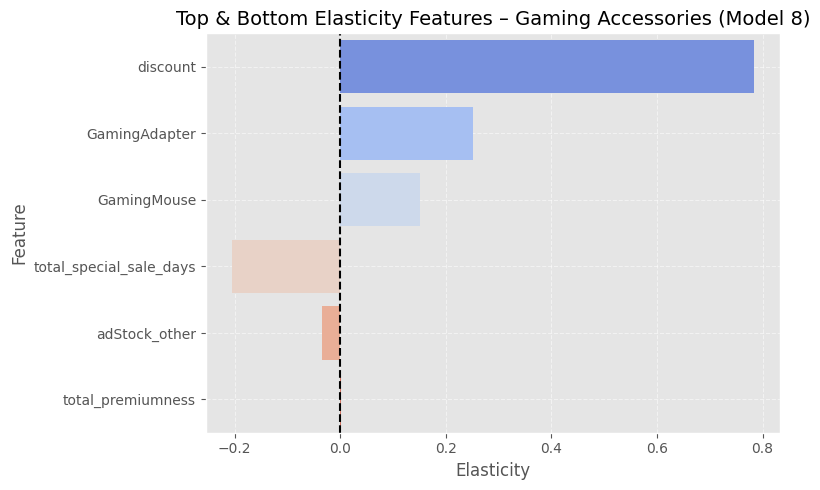

In [277]:
# Step 1: Extract coefficients and compute elasticity
coefficients_df8 = pd.DataFrame(lr8.params).reset_index()
coefficients_df8.columns = ['feature', 'coefficient']
coefficients_df8 = coefficients_df8[coefficients_df8['feature'] != 'const']

elasticity_data8 = calculateElasticity(X_train_lm8.drop('const', axis=1), y_train, coefficients_df8)

# Step 2: Remove 'year' for clarity
elasticity_data8_clean = elasticity_data8[~elasticity_data8['feature'].isin(['year'])]

# Step 3: Get Top 3 and Bottom 3
top3_gaming = elasticity_data8_clean.sort_values('elasticity', ascending=False).head(3)
bottom3_gaming = elasticity_data8_clean.sort_values('elasticity').head(3)
top_bottom_gaming = pd.concat([top3_gaming, bottom3_gaming])

# Step 4: Plot
plt.figure(figsize=(8, 5))
sns.barplot(x='elasticity', y='feature', data=top_bottom_gaming, palette='coolwarm')
plt.axvline(0, color='black', linestyle='--')
plt.title('Top & Bottom Elasticity Features – Gaming Accessories (Model 8)', fontsize=14)
plt.xlabel('Elasticity', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


# III. Home Audio - Multiplicative model

In [278]:
#Creating df with removal of features uncontrollable by the company, also, replacing 0.0 with lowest value to handle infinity given by log
df = np.log(final_home_audio_data.replace(0.0, 0.000001).drop(['selling_price','units','product_mrp','total_transactions'], axis = 1))

In [279]:
#Checking the dataset
df.head()

,order_week,month,year,adStock_tv,adStock_digital,adStock_sponsorship,adStock_content_marketing,adStock_online_marketing,adStock_affiliates,adStock_sem,adStock_radio,adStock_other,gmv,sla,product_procurement_sla,discount,NPS,total_premiumness,total_holidays,is_holiday,total_special_sale_days,is_special_sale_day,total_pay_days,is_pay_day,BoomBox,DJController,Dock,DockingStation,FMRadio,HiFiSystem,HomeAudioSpeaker,SlingBox,SoundMixer,VoiceRecorder
0,3.295837,1.945910,7.608374,-2.921877,-0.456885,0.617112,-8.363510,-1.103164,-1.989137,0.227872,-13.815511,-13.815511,11.207215,1.129384,1.313388,-0.955324,3.947923,3.465736,0.000000,0.000000,-13.815511,-13.815511,0.000000,0.000000,1.386294,-13.815511,-13.815511,-13.815511,0.693147,-13.815511,3.258097,-13.815511,-13.815511,-13.815511
1,3.332205,1.945910,7.608374,-2.516412,-0.051419,1.022577,-7.958044,-0.697699,-1.583672,0.633337,-13.815511,-13.815511,15.030011,2.029617,1.029696,-1.087456,3.947923,7.529406,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,4.077537,-13.815511,3.367296,0.000000,6.169611,2.564949,7.151485,-13.815511,-13.815511,3.218876
2,3.367296,1.945910,7.608374,-2.362261,0.102731,1.176728,-7.803894,-0.543549,-1.429521,0.787488,-13.815511,-13.815511,15.202941,1.966827,0.999661,-1.046816,3.947923,7.688455,-13.815511,-13.815511,0.693147,0.000000,0.000000,0.000000,4.043051,-13.815511,3.737670,0.000000,6.276643,3.295837,7.319865,-13.815511,-13.815511,3.258097
3,3.401197,1.945910,7.608374,-2.293268,0.171724,1.245721,-7.734901,-0.474556,-1.360528,0.856481,-13.815511,-13.815511,15.084331,1.964462,1.027303,-1.050401,3.947923,7.588830,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,-13.815511,4.174387,-13.815511,3.828641,-13.815511,6.232448,2.995732,7.194437,-13.815511,-13.815511,3.091042
4,3.433987,2.079442,7.608374,-2.955022,-0.090807,0.694922,-8.420842,-1.068883,-1.919477,0.591010,-13.815511,-13.815511,14.762367,1.984853,0.985274,-1.057119,3.947923,7.246368,-13.815511,-13.815511,-13.815511,-13.815511,0.000000,0.000000,3.610918,-13.815511,3.610918,-13.815511,5.918894,2.397895,6.842683,-13.815511,-13.815511,2.772589


In [280]:
#Test-train split
df_train, df_test = train_test_split(df, train_size = 0.8, test_size = 0.2, random_state = 100)

In [281]:
scaler = MinMaxScaler()

In [282]:
#Checking columns
df.columns

Index(['order_week', 'month', 'year', 'adStock_tv', 'adStock_digital',
       'adStock_sponsorship', 'adStock_content_marketing',
       'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem',
       'adStock_radio', 'adStock_other', 'gmv', 'sla',
       'product_procurement_sla', 'discount', 'NPS', 'total_premiumness',
       'total_holidays', 'is_holiday', 'total_special_sale_days',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'BoomBox',
       'DJController', 'Dock', 'DockingStation', 'FMRadio', 'HiFiSystem',
       'HomeAudioSpeaker', 'SlingBox', 'SoundMixer', 'VoiceRecorder'],
      dtype='object')

In [283]:
from sklearn.preprocessing import MinMaxScaler



num_vars = ['adStock_tv', 'adStock_digital', 'adStock_sponsorship',
             'adStock_content_marketing', 'adStock_online_marketing',
             'adStock_affiliates', 'adStock_sem', 'adStock_radio',
             'adStock_other', 'sla', 'product_procurement_sla',
             'discount', 'NPS', 'total_holidays', 'total_special_sale_days',
             'total_pay_days', 'BoomBox', 'DJController', 'Dock',
             'DockingStation', 'FMRadio', 'HiFiSystem', 'HomeAudioSpeaker',
             'SlingBox', 'SoundMixer', 'VoiceRecorder']

#  Apply Scaling
df_train[num_vars] = scaler.fit_transform(df_train[num_vars])
df_test[num_vars] = scaler.transform(df_test[num_vars])  # Use transform on test!


In [284]:
y_train = df_train.pop('gmv')
X_train = df_train

In [285]:
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE

lm = LinearRegression()
lm.fit(X_train, y_train)

#  Correct way to run RFE with named argument
rfe = RFE(estimator=lm, n_features_to_select=20)
rfe = rfe.fit(X_train, y_train)

#  Extract Selected Columns
col = X_train.columns[rfe.support_]
print("Selected Features by RFE:\n", col.tolist())


Selected Features by RFE:
 ['year', 'adStock_tv', 'adStock_sponsorship', 'adStock_content_marketing', 'adStock_online_marketing', 'adStock_affiliates', 'adStock_sem', 'adStock_radio', 'adStock_other', 'sla', 'discount', 'total_premiumness', 'Dock', 'DockingStation', 'FMRadio', 'HiFiSystem', 'HomeAudioSpeaker', 'SlingBox', 'SoundMixer', 'VoiceRecorder']


In [286]:
#Extracting selected columns by RFE into a list
col = X_train.columns[rfe.support_]
col

Index(['year', 'adStock_tv', 'adStock_sponsorship',
       'adStock_content_marketing', 'adStock_online_marketing',
       'adStock_affiliates', 'adStock_sem', 'adStock_radio', 'adStock_other',
       'sla', 'discount', 'total_premiumness', 'Dock', 'DockingStation',
       'FMRadio', 'HiFiSystem', 'HomeAudioSpeaker', 'SlingBox', 'SoundMixer',
       'VoiceRecorder'],
      dtype='object')

In [287]:
#Columns not supported by RFE
X_train.columns[~rfe.support_]

Index(['order_week', 'month', 'adStock_digital', 'product_procurement_sla',
       'NPS', 'total_holidays', 'is_holiday', 'total_special_sale_days',
       'is_special_sale_day', 'total_pay_days', 'is_pay_day', 'BoomBox',
       'DJController'],
      dtype='object')

In [288]:
# Creating dataframe with RFE selected variables
X_train_rfe = X_train[col]

# BASE MODEL

In [289]:
#  Add Constant for Intercept
X_train_lm = sm.add_constant(X_train_rfe)

#  Fit the Model
lr = sm.OLS(y_train, X_train_lm).fit()

#  Model Summary
print(lr.summary())

#  Calculate VIF to Check Multicollinearity
vif = pd.DataFrame()
vif['Features'] = X_train_lm.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm.values, i)
               for i in range(X_train_lm.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
vif

                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     3372.
Date:                Tue, 27 May 2025   Prob (F-statistic):           1.26e-29
Time:                        17:34:12   Log-Likelihood:                 119.70
No. Observations:                  40   AIC:                            -197.4
Df Residuals:                      19   BIC:                            -161.9
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
0,const,3.677459e+11
5,adStock_online_marketing,1.244025e+04
6,adStock_affiliates,1.152378e+04
12,total_premiumness,4.792910e+03
9,adStock_other,2.906550e+03
17,HomeAudioSpeaker,2.694090e+03
8,adStock_radio,2.043630e+03
15,FMRadio,5.451000e+02
1,year,3.901900e+02
20,VoiceRecorder,2.125100e+02


# Model zero

In [290]:
X_train_new0 = X_train_rfe.drop(["VoiceRecorder"], axis=1)
X_train_lm0 = sm.add_constant(X_train_new0)
lr_model_0 = sm.OLS(y_train, X_train_lm0).fit()

print(lr_model_0.summary())

vif_0 = pd.DataFrame()
vif_0['Features'] = X_train_lm0.columns
vif_0['VIF'] = [variance_inflation_factor(X_train_lm0.values, i) for i in range(X_train_lm0.shape[1])]
vif_0['VIF'] = round(vif_0['VIF'], 2).sort_values(ascending=False)
display(vif_0)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     3727.
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.06e-31
Time:                        17:34:12   Log-Likelihood:                 119.65
No. Observations:                  40   AIC:                            -199.3
Df Residuals:                      20   BIC:                            -165.5
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

,Features,VIF
0,const,2.631222e+11
1,year,2.791300e+02
2,adStock_tv,1.110500e+02
3,adStock_sponsorship,2.807000e+01
4,adStock_content_marketing,1.362400e+02
5,adStock_online_marketing,1.061375e+04
6,adStock_affiliates,9.617430e+03
7,adStock_sem,6.830000e+00
8,adStock_radio,1.743010e+03
9,adStock_other,2.258340e+03


# MODEL 1

In [291]:
X_train_new1 = X_train_new0.drop(["adStock_content_marketing"], axis=1)
X_train_lm1 = sm.add_constant(X_train_new1)
lr_model_1 = sm.OLS(y_train, X_train_lm1).fit()

print(lr_model_1.summary())

vif_1 = pd.DataFrame()
vif_1['Features'] = X_train_lm1.columns
vif_1['VIF'] = [variance_inflation_factor(X_train_lm1.values, i) for i in range(X_train_lm1.shape[1])]
vif_1['VIF'] = round(vif_1['VIF'], 2).sort_values(ascending=False)
display(vif_1)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     4105.
Date:                Tue, 27 May 2025   Prob (F-statistic):           3.33e-33
Time:                        17:34:12   Log-Likelihood:                 119.52
No. Observations:                  40   AIC:                            -201.0
Df Residuals:                      21   BIC:                            -169.0
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,2.541822e+11
1,year,2.696200e+02
2,adStock_tv,8.110000e+01
3,adStock_sponsorship,2.088000e+01
4,adStock_online_marketing,3.343330e+03
5,adStock_affiliates,3.535860e+03
6,adStock_sem,6.340000e+00
7,adStock_radio,1.742790e+03
8,adStock_other,2.248040e+03
9,sla,1.213000e+01


# MODEL 2

In [292]:
X_train_new2 = X_train_new1.drop(["HiFiSystem"], axis=1)
X_train_lm2 = sm.add_constant(X_train_new2)
lr_model_2 = sm.OLS(y_train, X_train_lm2).fit()

print(lr_model_2.summary())

vif_2 = pd.DataFrame()
vif_2['Features'] = X_train_lm2.columns
vif_2['VIF'] = [variance_inflation_factor(X_train_lm2.values, i) for i in range(X_train_lm2.shape[1])]
vif_2['VIF'] = round(vif_2['VIF'], 2).sort_values(ascending=False)
display(vif_2)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     4478.
Date:                Tue, 27 May 2025   Prob (F-statistic):           5.78e-35
Time:                        17:34:12   Log-Likelihood:                 119.19
No. Observations:                  40   AIC:                            -202.4
Df Residuals:                      22   BIC:                            -172.0
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

,Features,VIF
0,const,2.219451e+11
1,year,2.354300e+02
2,adStock_tv,5.699000e+01
3,adStock_sponsorship,1.480000e+01
4,adStock_online_marketing,2.959360e+03
5,adStock_affiliates,3.006100e+03
6,adStock_sem,6.270000e+00
7,adStock_radio,1.676560e+03
8,adStock_other,2.042830e+03
9,sla,1.211000e+01


# MODEL 3

In [293]:
#  Drop feature with highest p-value
X_train_new3 = X_train_new2.drop(["adStock_online_marketing"], axis=1)

#  Add a constant
X_train_lm3 = sm.add_constant(X_train_new3)

#  Fit the model
lr3 = sm.OLS(y_train, X_train_lm3).fit()

#  Model Summary
lr3.params
print(lr3.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm3.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm3.values, i)
               for i in range(X_train_lm3.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                     4919.
Date:                Tue, 27 May 2025   Prob (F-statistic):           9.07e-37
Time:                        17:34:12   Log-Likelihood:                 118.97
No. Observations:                  40   AIC:                            -203.9
Df Residuals:                      23   BIC:                            -175.2
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const               -4247.7023   1

,Features,VIF
0,const,2.032310e+11
10,total_premiumness,2.220690e+03
7,adStock_other,1.908270e+03
6,adStock_radio,1.421810e+03
14,HomeAudioSpeaker,1.220490e+03
13,FMRadio,2.630500e+02
1,year,2.155600e+02
2,adStock_tv,5.382000e+01
4,adStock_affiliates,4.257000e+01
11,Dock,2.344000e+01


# MODEL 4

In [294]:
X_train_new4 = X_train_new3.drop(["FMRadio"], axis=1)
X_train_lm4 = sm.add_constant(X_train_new4)
lr_model_4 = sm.OLS(y_train, X_train_lm4).fit()

print(lr_model_4.summary())

vif_4 = pd.DataFrame()
vif_4['Features'] = X_train_lm4.columns
vif_4['VIF'] = [variance_inflation_factor(X_train_lm4.values, i) for i in range(X_train_lm4.shape[1])]
vif_4['VIF'] = round(vif_4['VIF'], 2).sort_values(ascending=False)
display(vif_4)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                     5212.
Date:                Tue, 27 May 2025   Prob (F-statistic):           2.16e-38
Time:                        17:34:13   Log-Likelihood:                 117.98
No. Observations:                  40   AIC:                            -204.0
Df Residuals:                      24   BIC:                            -176.9
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const               -4413.7133   1

,Features,VIF
0,const,1.996675e+11
1,year,2.117500e+02
2,adStock_tv,5.151000e+01
3,adStock_sponsorship,8.850000e+00
4,adStock_affiliates,4.236000e+01
5,adStock_sem,5.840000e+00
6,adStock_radio,1.418920e+03
7,adStock_other,1.908030e+03
8,sla,1.119000e+01
9,discount,4.490000e+00


# MODEL 5

In [295]:
#  Drop due to high p-value and multicollinearity
X_train_new5 = X_train_new4.drop(["DockingStation"], axis=1)

#  Add a constant
X_train_lm5 = sm.add_constant(X_train_new5)

#  Fit the model
lr5 = sm.OLS(y_train, X_train_lm5).fit()

#  Model Summary
lr5.params
print(lr5.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm5.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm5.values, i)
               for i in range(X_train_lm5.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5323.
Date:                Tue, 27 May 2025   Prob (F-statistic):           8.33e-40
Time:                        17:34:13   Log-Likelihood:                 116.21
No. Observations:                  40   AIC:                            -202.4
Df Residuals:                      25   BIC:                            -177.1
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const               -4830.0119   1

,Features,VIF
0,const,1.880221e+11
7,adStock_other,1.857380e+03
6,adStock_radio,1.403680e+03
10,total_premiumness,2.527000e+02
12,HomeAudioSpeaker,2.190900e+02
1,year,1.994000e+02
2,adStock_tv,5.112000e+01
4,adStock_affiliates,4.150000e+01
11,Dock,1.934000e+01
8,sla,1.103000e+01


# mODEL 6

In [296]:
#  Drop 'adStock_sem' due to high p-value
X_train_new6 = X_train_new5.drop(["adStock_sem"], axis=1)

#  Add a constant
X_train_lm6 = sm.add_constant(X_train_new6)

#  Fit the model
lr6 = sm.OLS(y_train, X_train_lm6).fit()

#  Model Summary
lr6.params
print(lr6.summary())

#  Calculate VIF
vif = pd.DataFrame()
vif['Features'] = X_train_lm6.columns
vif['VIF'] = [variance_inflation_factor(X_train_lm6.values, i)
               for i in range(X_train_lm6.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by="VIF", ascending=False)

#  Display VIF
display(vif)


                            OLS Regression Results                            
Dep. Variable:                    gmv   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                     5477.
Date:                Tue, 27 May 2025   Prob (F-statistic):           3.15e-41
Time:                        17:34:13   Log-Likelihood:                 114.51
No. Observations:                  40   AIC:                            -201.0
Df Residuals:                      26   BIC:                            -177.4
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const               -4886.4392   1

,Features,VIF
0,const,1.878182e+11
6,adStock_other,1.855210e+03
5,adStock_radio,1.403240e+03
9,total_premiumness,2.067700e+02
1,year,1.991800e+02
11,HomeAudioSpeaker,1.746400e+02
2,adStock_tv,4.927000e+01
4,adStock_affiliates,3.882000e+01
10,Dock,1.858000e+01
7,sla,8.610000e+00


In [297]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression

# Initialize Linear Regression Model
lm = LinearRegression()

# Consistent Model Mapping (Ensure you have X_train_lm4, X_train_lm5, X_train_lm6 defined)
model_data_final = {
    "Model 4": X_train_lm4,
    "Model 5": X_train_lm5,
    "Model 6": X_train_lm6
}

# Run Cross-Validation and Print Results
print("\n=== Cross-Validation R² Scores ===\n")
for model_name, X_data in model_data_final.items():
    r2_scores = cross_val_score(lm, X_data, y_train, scoring='r2', cv=5)
    print(f"{model_name}: Mean R² = {round(r2_scores.mean(), 4)} | Std Dev = {round(r2_scores.std(), 4)}")



=== Cross-Validation R² Scores ===

Model 4: Mean R² = 0.9932 | Std Dev = 0.0098
Model 5: Mean R² = 0.9936 | Std Dev = 0.0085
Model 6: Mean R² = 0.9937 | Std Dev = 0.0087


# slecting model 6 as our best performing model

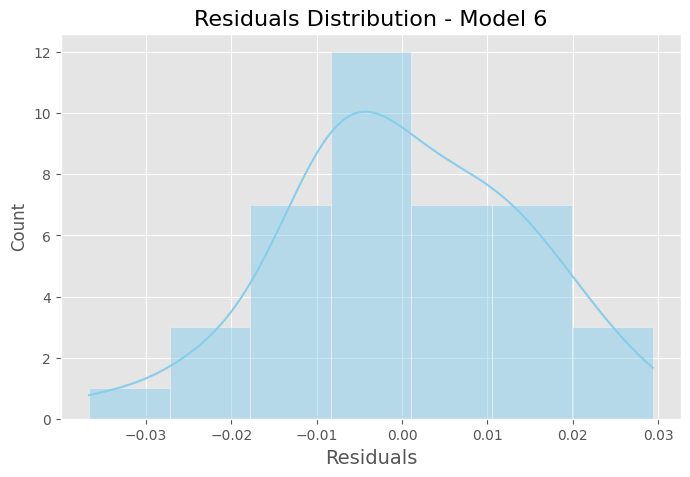

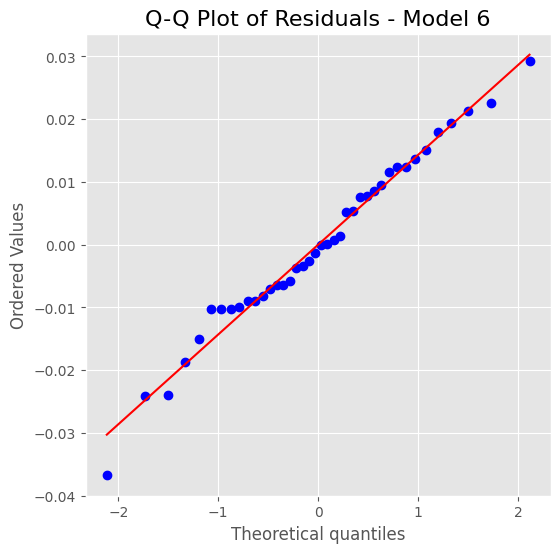

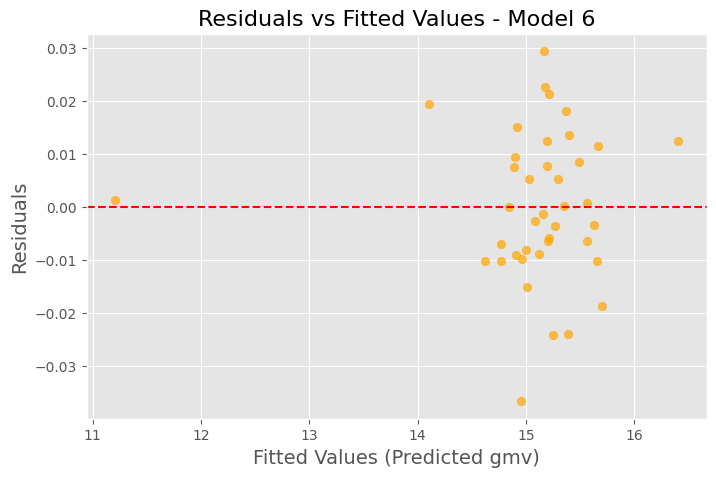

In [298]:
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import numpy as np

# Step 1: Get Residuals
y_pred_train_m6 = lr6.predict(X_train_lm6)
residuals_m6 = y_train - y_pred_train_m6

# Step 2: Residuals Distribution Plot (Check Normality)
plt.figure(figsize=(8, 5))
sns.histplot(residuals_m6, kde=True, color="skyblue")
plt.title('Residuals Distribution - Model 6', fontsize=16)
plt.xlabel('Residuals', fontsize=14)
plt.grid(True)
plt.show()

# Step 3: Q-Q Plot for Normality
plt.figure(figsize=(6, 6))
stats.probplot(residuals_m6, dist="norm", plot=plt)
plt.title('Q-Q Plot of Residuals - Model 6', fontsize=16)
plt.show()

# Step 4: Residuals vs Fitted Values (Check for Homoscedasticity)
plt.figure(figsize=(8, 5))
plt.scatter(y_pred_train_m6, residuals_m6, alpha=0.7, color="orange")
plt.axhline(0, color='red', linestyle='--')
plt.title('Residuals vs Fitted Values - Model 6', fontsize=16)
plt.xlabel('Fitted Values (Predicted gmv)', fontsize=14)
plt.ylabel('Residuals', fontsize=14)
plt.grid(True)
plt.show()


 Model 6 Test R² Score: 0.9997
 Model 6 Test RMSE: 0.0407


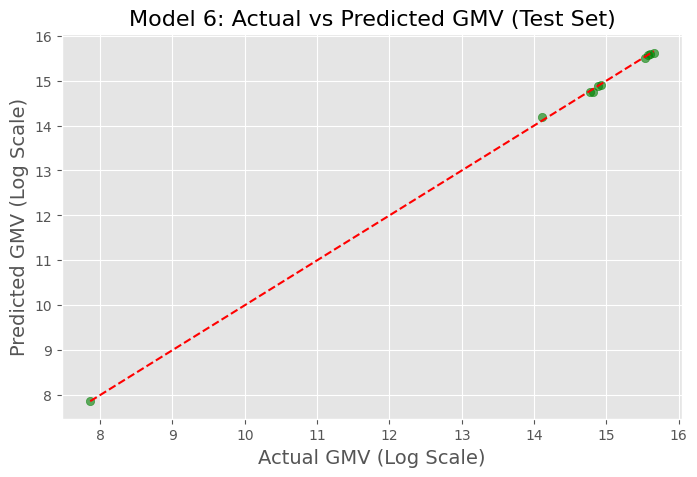

In [299]:
from sklearn.metrics import r2_score, mean_squared_error

# Prepare Test Data
y_test = df_test.pop('gmv')
X_test_m6 = df_test[X_train_lm6.drop('const', axis=1).columns]  # Ensure same features as training
X_test_m6 = sm.add_constant(X_test_m6)

# Predict on Test Set
y_pred_test_m6 = lr6.predict(X_test_m6)

# Calculate R² and RMSE
r2_test_m6 = r2_score(y_test, y_pred_test_m6)
rmse_test_m6 = np.sqrt(mean_squared_error(y_test, y_pred_test_m6))

print(f" Model 6 Test R² Score: {round(r2_test_m6, 4)}")
print(f" Model 6 Test RMSE: {round(rmse_test_m6, 4)}")

# Plot Actual vs Predicted
plt.figure(figsize=(8, 5))
plt.scatter(y_test, y_pred_test_m6, color='green', alpha=0.6)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--')
plt.title('Model 6: Actual vs Predicted GMV (Test Set)', fontsize=16)
plt.xlabel('Actual GMV (Log Scale)', fontsize=14)
plt.ylabel('Predicted GMV (Log Scale)', fontsize=14)
plt.grid(True)
plt.show()


In [300]:
# Extract Coefficients (excluding intercept)
elasticity_df = pd.DataFrame({
    'Feature': X_train_lm6.columns[1:],  # Skip 'const'
    'Coefficient': lr6.params.values[1:]
})

# Elasticity Calculation for Multiplicative Model
elasticity_df['Elasticity (%)'] = round(elasticity_df['Coefficient'] * 100, 2)

# Display Sorted by Absolute Elasticity
elasticity_df = elasticity_df.sort_values(by='Elasticity (%)', ascending=False)
display(elasticity_df)


,Feature,Coefficient,Elasticity (%)
0,year,643.508389,64350.84
10,HomeAudioSpeaker,2.491925,249.19
4,adStock_radio,0.694223,69.42
8,total_premiumness,0.453104,45.31
9,Dock,0.356162,35.62
1,adStock_tv,0.249502,24.95
12,SoundMixer,0.050465,5.05
7,discount,0.047955,4.80
11,SlingBox,-0.047666,-4.77
2,adStock_sponsorship,-0.069906,-6.99


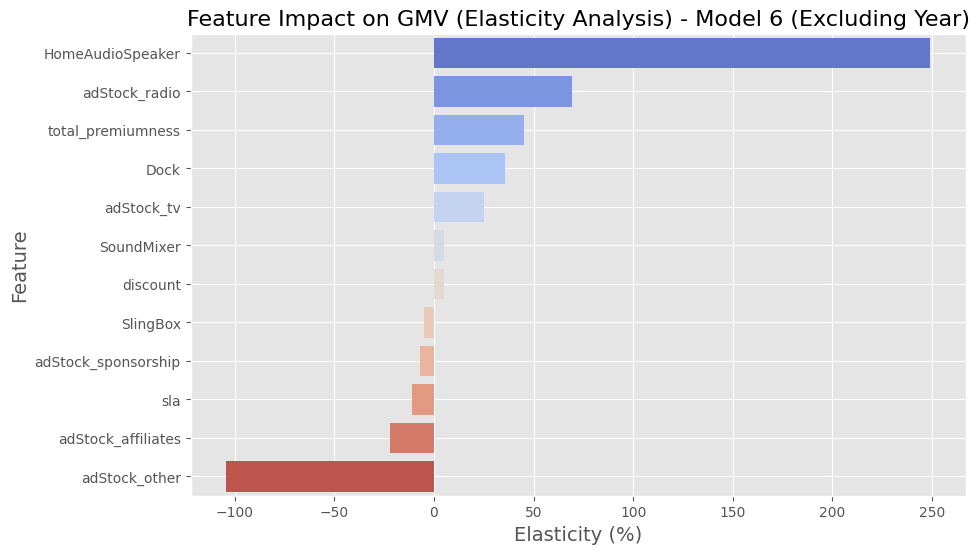

In [301]:
# Filter out 'year' before plotting
elasticity_plot_df = elasticity_df[elasticity_df['Feature'] != 'year']

plt.figure(figsize=(10, 6))
sns.barplot(x='Elasticity (%)', y='Feature', data=elasticity_plot_df, palette='coolwarm')
plt.title('Feature Impact on GMV (Elasticity Analysis) - Model 6 (Excluding Year)', fontsize=16)
plt.xlabel('Elasticity (%)', fontsize=14)
plt.ylabel('Feature', fontsize=14)
plt.grid(True)
plt.show()


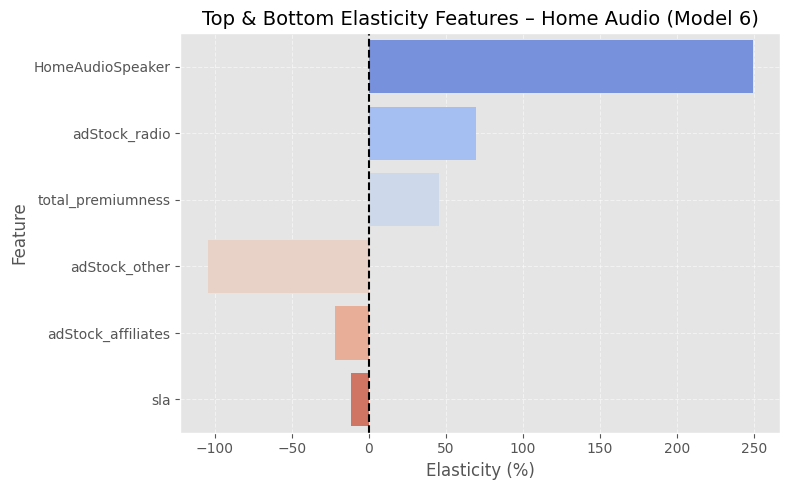

In [302]:
# Step 1: Prepare Elasticity DataFrame
elasticity_df6 = pd.DataFrame({
    'feature': X_train_lm6.columns[1:],  # skip const
    'coefficient': lr6.params.values[1:]
})

# Step 2: Calculate Elasticity (%)
elasticity_df6['elasticity'] = round(elasticity_df6['coefficient'] * 100, 2)

# Step 3: Remove 'year'
elasticity_df6_clean = elasticity_df6[elasticity_df6['feature'] != 'year']

# Step 4: Get Top 3 and Bottom 3
top3_audio = elasticity_df6_clean.sort_values('elasticity', ascending=False).head(3)
bottom3_audio = elasticity_df6_clean.sort_values('elasticity').head(3)
top_bottom_audio = pd.concat([top3_audio, bottom3_audio])

# Step 5: Plot
plt.figure(figsize=(8, 5))
sns.barplot(x='elasticity', y='feature', data=top_bottom_audio, palette='coolwarm')
plt.axvline(0, color='black', linestyle='--')
plt.title('Top & Bottom Elasticity Features – Home Audio (Model 6)', fontsize=14)
plt.xlabel('Elasticity (%)', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


# 📈 Koyck Model Suitability Check – Code Block

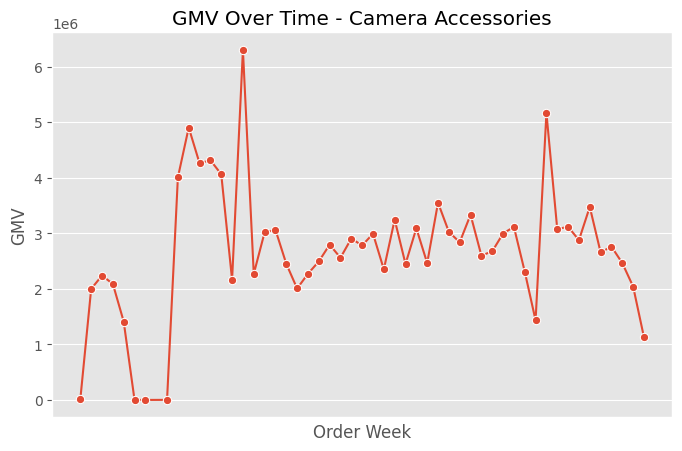

 Durbin-Watson Statistic for Camera Accessories: 2.077
 Little to No Autocorrelation → Koyck Model Not Necessary.



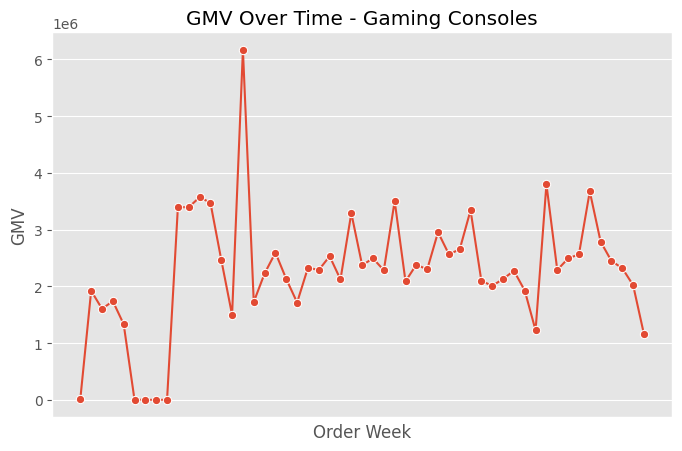

 Durbin-Watson Statistic for Gaming Consoles: 2.07
 Little to No Autocorrelation → Koyck Model Not Necessary.



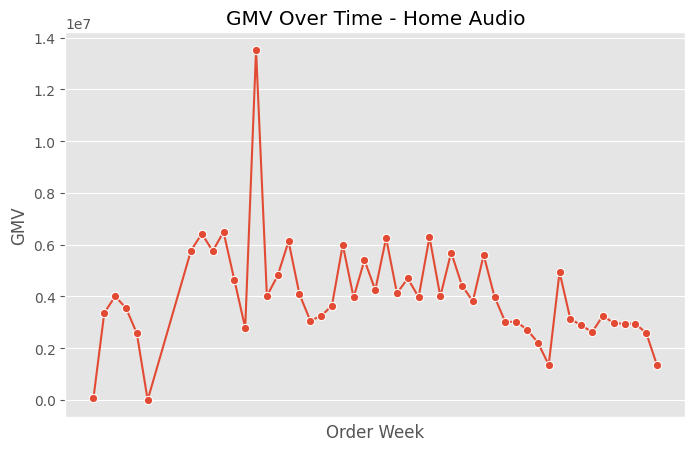

 Durbin-Watson Statistic for Home Audio: 2.017
 Little to No Autocorrelation → Koyck Model Not Necessary.



In [303]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.stats.stattools import durbin_watson
import statsmodels.api as sm

def koyck_check(data, category_name):
    # 1️ Ensure 'order_week' is datetime if it's not already
    if not pd.api.types.is_datetime64_any_dtype(data['order_week']):
        data['order_week'] = pd.to_datetime(data['order_week'])

    # 2️ Group GMV over time
    gmv_over_time = data.groupby('order_week')['gmv'].sum().reset_index()

    # 3️ Plot GMV Trend
    plt.figure(figsize=(8, 5))
    sns.lineplot(data=gmv_over_time, x='order_week', y='gmv', marker='o')
    plt.title(f'GMV Over Time - {category_name}')
    plt.xlabel('Order Week')
    plt.ylabel('GMV')
    plt.grid(True)
    plt.show()

    # 4️ Durbin-Watson Test for Autocorrelation
    # Handle log transformation safely to avoid -inf
    gmv_series = np.log(gmv_over_time['gmv'].replace(0, 1e-6))

    # Create lagged GMV for regression
    gmv_over_time['gmv_lag1'] = gmv_over_time['gmv'].shift(1)
    gmv_over_time = gmv_over_time.dropna()

    # Regression for Durbin-Watson
    X = sm.add_constant(gmv_over_time['gmv_lag1'])
    y = gmv_over_time['gmv']
    model = sm.OLS(y, X).fit()
    dw_stat = durbin_watson(model.resid)

    print(f" Durbin-Watson Statistic for {category_name}: {round(dw_stat, 3)}")
    if dw_stat < 1.5:
        print(" Strong Positive Autocorrelation → Koyck Model Recommended.\n")
    elif dw_stat > 2.5:
        print(" Strong Negative Autocorrelation → Koyck Model Might Help.\n")
    else:
        print(" Little to No Autocorrelation → Koyck Model Not Necessary.\n")

#  Run for All Categories
koyck_check(final_camera_data, "Camera Accessories")
koyck_check(final_gaming_data, "Gaming Consoles")
koyck_check(final_home_audio_data, "Home Audio")


## ✅ Autocorrelation Check – Durbin-Watson Test Results

| Category           | Durbin-Watson | Interpretation                         |
|--------------------|---------------|-----------------------------------------|
| Camera Accessories | 2.077         | No autocorrelation – Clean residuals    |
| Gaming Consoles    | 2.07          | No autocorrelation – Clean residuals    |
| Home Audio         | 2.017         | No autocorrelation – Clean residuals    |

All DW values are approximately 2, indicating **little to no autocorrelation** in residuals.  
➡️ **Conclusion**: No need for lag-based models like Koyck or ARIMA.  
➡️ Existing log-linear / multiplicative models are appropriate.
